In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_percentage_error
import statsmodels.api as sm
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
import pickle

## Part 1: Taxi Trip Data

### Review the Data and Prep

In [2]:
# Reading the cleaned csv
df = pd.read_csv('programing data/2017-2021.csv')

In [3]:
df.head(100)

,Date,PU_passenger,PUTripDistance_count,PickUp_count,PU_fare,PUT_fare,LocationID,DO_passenger,DOTripDistance_count,DropOff_count,DO_fare,DOT_fare
0,2017-01-01,2452.0,4936.95,1437,19724.81,23553.57,4,3438.0,5338.68,2027,22617.61,27752.81
1,2017-01-01,316.0,761.80,179,2890.50,3215.64,12,512.0,1216.13,276,4405.00,4903.49
2,2017-01-01,3792.0,9246.49,2101,33698.50,39895.33,13,4500.0,10568.66,2486,38450.30,44998.68
3,2017-01-01,1714.0,2916.34,991,11666.00,14270.05,24,2094.0,4034.95,1225,15293.50,19001.83
4,2017-01-01,3023.0,4862.40,1806,20081.50,23956.00,41,4879.0,9937.41,2856,37805.04,45706.13
...,...,...,...,...,...,...,...,...,...,...,...,...
95,2017-01-02,4237.0,5081.03,2528,23294.64,29289.81,143,4713.0,6711.04,2839,28370.64,36048.12
96,2017-01-02,4597.0,6662.71,2627,28950.30,34935.76,144,4362.0,6979.97,2490,29359.00,35324.42
97,2017-01-02,4376.0,7493.14,2558,30065.31,36681.84,148,3859.0,6595.68,2292,27351.80,33446.73
98,2017-01-02,3718.0,4980.17,2226,21389.00,26630.40,151,3562.0,6099.65,2128,23709.00,30156.28


In [4]:
df['LocationID'].nunique()

66

In [5]:
df.columns

Index(['Date', 'PU_passenger', 'PUTripDistance_count', 'PickUp_count',
       'PU_fare', 'PUT_fare', 'LocationID', 'DO_passenger',
       'DOTripDistance_count', 'DropOff_count', 'DO_fare', 'DOT_fare'],
      dtype='object')

In [6]:
df.shape

(119233, 12)

In [7]:
df.dtypes

Date                     object
PU_passenger            float64
PUTripDistance_count    float64
PickUp_count              int64
PU_fare                 float64
PUT_fare                float64
LocationID                int64
DO_passenger            float64
DOTripDistance_count    float64
DropOff_count             int64
DO_fare                 float64
DOT_fare                float64
dtype: object

- Check if there is a null value

In [8]:
df.isna().sum()

Date                    0
PU_passenger            0
PUTripDistance_count    0
PickUp_count            0
PU_fare                 0
PUT_fare                0
LocationID              0
DO_passenger            0
DOTripDistance_count    0
DropOff_count           0
DO_fare                 0
DOT_fare                0
dtype: int64

### Underdtanding Data

In [9]:
# Look at correlations for all the continuous features.
df[['PU_passenger', 'PUTripDistance_count', 'PickUp_count', 'PU_fare', 'LocationID', 'DO_passenger',
   'DOTripDistance_count', 'DropOff_count', 'DO_fare', 'DOT_fare']].corr()

,PU_passenger,PUTripDistance_count,PickUp_count,PU_fare,LocationID,DO_passenger,DOTripDistance_count,DropOff_count,DO_fare,DOT_fare
PU_passenger,1.000000,0.710349,0.998354,0.960713,0.164748,0.984226,0.551363,0.982127,0.936852,0.943240
PUTripDistance_count,0.710349,1.000000,0.710985,0.700432,0.106372,0.695931,0.440671,0.696250,0.681062,0.687501
PickUp_count,0.998354,0.710985,1.000000,0.961228,0.170138,0.982642,0.553527,0.983676,0.937204,0.947498
PU_fare,0.960713,0.700432,0.961228,1.000000,0.148212,0.942872,0.543033,0.942708,0.922377,0.928550
LocationID,0.164748,0.106372,0.170138,0.148212,1.000000,0.170643,0.100640,0.176156,0.155580,0.169329
DO_passenger,0.984226,0.695931,0.982642,0.942872,0.170643,1.000000,0.564782,0.998267,0.953888,0.958786
DOTripDistance_count,0.551363,0.440671,0.553527,0.543033,0.100640,0.564782,1.000000,0.567281,0.562247,0.567384
DropOff_count,0.982127,0.696250,0.983676,0.942708,0.176156,0.998267,0.567281,1.000000,0.954375,0.963282
DO_fare,0.936852,0.681062,0.937204,0.922377,0.155580,0.953888,0.562247,0.954375,1.000000,0.991327
DOT_fare,0.943240,0.687501,0.947498,0.928550,0.169329,0.958786,0.567384,0.963282,0.991327,1.000000


- This table shows that there is a strong correlation between the taxi data.

### Plot line charts for DropOff_count and DO_passenger features

- View a line graph of 1 year(2019) of data

In [10]:
# Reading the 2019 csv
df19 = pd.read_csv('programing data/2019.csv')
# Set the Date column to the date index 
df19['Date'] = pd.to_datetime(df['Date'])
df19.set_index('Date', inplace=True)

# Grouping the data by different LocationIDs and weeks, and then calculate the taxi count for each LocationID in each week
weekly_D = df19.groupby(['LocationID', pd.Grouper(freq='W')])['DropOff_count'].sum()
weekly_P = df19.groupby(['LocationID', pd.Grouper(freq='W')])['PickUp_count'].sum()


# Calculate weekly statistical indicators
weekly_Dstats = weekly_D.groupby('LocationID').describe()
weekly_Pstats = weekly_P.groupby('LocationID').describe()


In [11]:
# Print statistical indicators for weekly

print("Weekly statistical indicators - number of Drop off:")
print(weekly_Dstats)
print("Weekly statistical indicators - number of Pick up:")
print(weekly_Pstats)

Weekly statistical indicators - number of Drop off:
            count          mean          std     min       25%      50%  \
LocationID                                                                
4            53.0   6829.754717  1232.616368  1168.0   6261.00   6841.0   
12           53.0   1002.094340   204.540880   213.0    910.00   1003.0   
13           53.0  14743.132075  2331.098503  1693.0  14290.00  15112.0   
24           53.0   5431.169811   950.653818   787.0   5018.00   5688.0   
41           53.0  10256.075472  1561.212458  1627.0   9596.00  10552.0   
...           ...           ...          ...     ...       ...      ...   
246          54.0  30486.222222  6845.696281  2347.0  29090.25  32356.5   
249          54.0  24848.018519  5436.790918  2668.0  23725.50  26041.5   
261          54.0   7312.444444  1390.542539   905.0   7222.50   7563.5   
262          54.0  20271.370370  4781.403190  2451.0  18218.25  21729.5   
263          54.0  29175.907407  6446.289274  39

- From the above periodic indicators, it can be observed that there are significant differences in taxi activities among different regions. While the growth in passenger numbers around the 25th, 50th, and 75th percentiles is relatively balanced, there is a noticeable gap between the minimum and maximum values. This indicates that there are significant fluctuations or peaks in taxi demand during certain time periods (or in some time periods).

- Line graph according to DropOff_count weekly statistical indicator

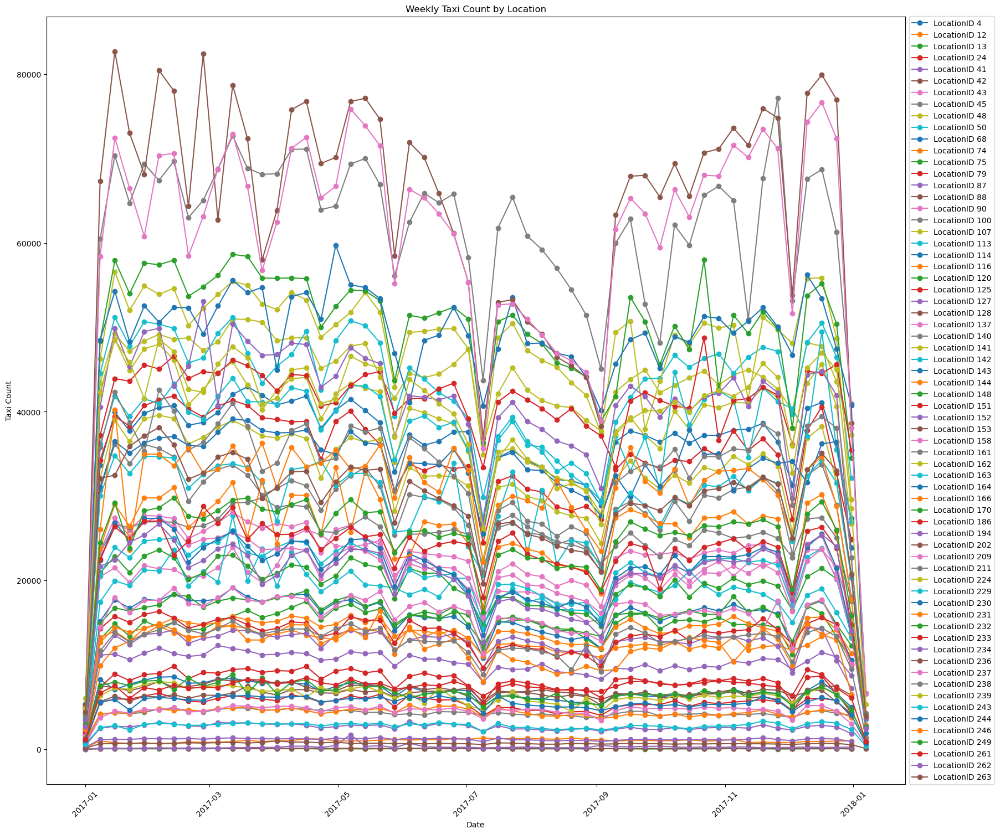

<Figure size 640x480 with 0 Axes>

In [12]:
# Get LocationID
location_ids = weekly_D.index.get_level_values('LocationID').unique()

# Create a drawing and axis object
fig, ax = plt.subplots(figsize=(20, 18))

# Traverse each LocationID, draw a Line chart and add a legends
for location_id in location_ids:
    data = weekly_D.loc[location_id]
    ax.plot(data.index, data.values, marker='o', linestyle='-', label='LocationID ' + str(location_id))

# Set Drawing Title and Axis Labels
ax.set_title('Weekly Taxi Count by Location')
ax.set_xlabel('Date')
ax.set_ylabel('Taxi Count')

# add legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# Rotate X-axis labels to avoid overlap
plt.xticks(rotation=45)

# display graphics
plt.show()

plt.savefig('line_plot.png', dpi=3000, bbox_inches='tight')

- Line graph according to PickUp_count weekly statistical indicator

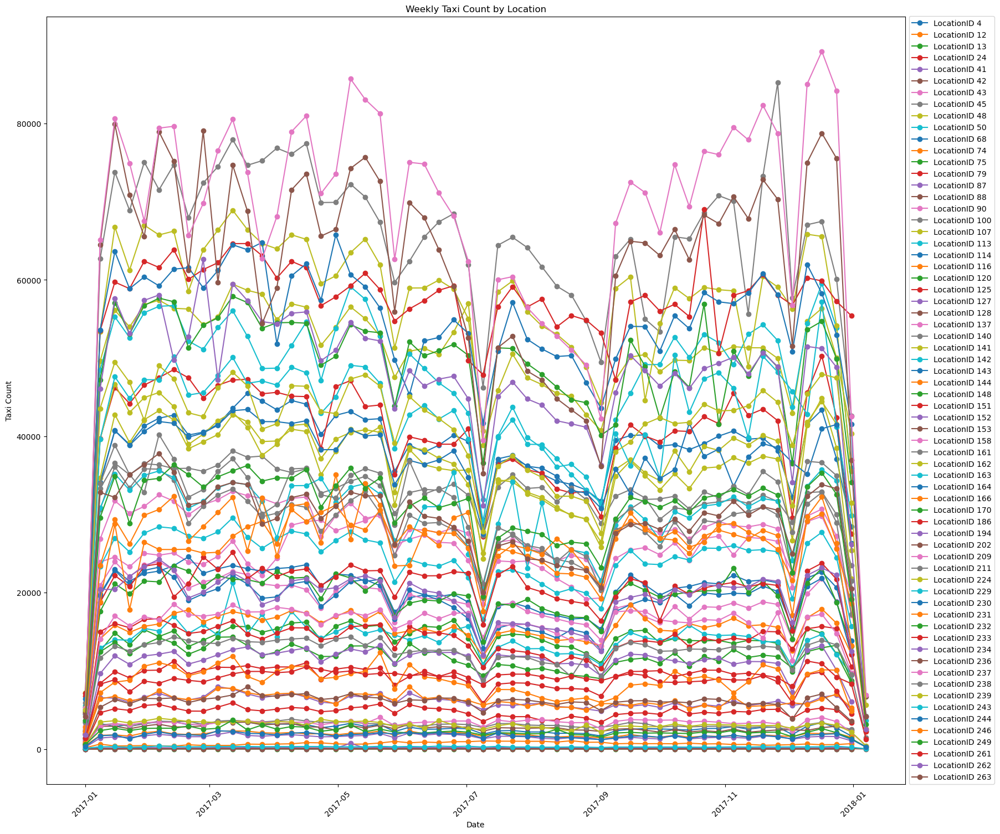

<Figure size 640x480 with 0 Axes>

In [13]:
# Get LocationID
location_ids = weekly_P.index.get_level_values('LocationID').unique()

# Create a drawing and axis object
fig, ax = plt.subplots(figsize=(20, 18))

# Traverse each LocationID, draw a Line chart and add a legends
for location_id in location_ids:
    data = weekly_P.loc[location_id]
    ax.plot(data.index, data.values, marker='o', linestyle='-', label='LocationID ' + str(location_id))

# Set Drawing Title and Axis Labels
ax.set_title('Weekly Taxi Count by Location')
ax.set_xlabel('Date')
ax.set_ylabel('Taxi Count')

# add legends
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# Rotate X-axis labels to avoid overlap
plt.xticks(rotation=45)

# display graphics
plt.show()

plt.savefig('line_plot.png', dpi=3000, bbox_inches='tight')

- It can be seen from the above Line chart that the taxi data has strong cyclical and seasonal characteristics. There is a significant decrease in January, June, July, September and December.

- Next, we will investigate whether there are similar seasonal or cyclical trends in taxi data over the past 5 years.

- #### View a line graph of 5 year(2017 - 2021) of data

- Due to the large amount of data, it is summarized on a monthly basis.

In [14]:
# Set the Date column as the date index
df['Date'] = pd.to_datetime(df['Date'])
df.set_index('Date', inplace=True)

# Aggregated number of Pick_Up and Drop_Off by LocationID and month
monthly_D = df.groupby(['LocationID', pd.Grouper(freq='M')])['DropOff_count'].sum()
monthly_P = df.groupby(['LocationID', pd.Grouper(freq='M')])['PickUp_count'].sum()

#Calculate monthly statistical indicators
monthly_Dstats = monthly_D.groupby('LocationID').describe()

monthly_Pstats = monthly_P.groupby('LocationID').describe()


In [15]:
# Print statistical indicators for monthly

print("Weekly statistical indicators - number of Drop off:")
print(monthly_Dstats)
print("Weekly statistical indicators - number of Pick Up:")
print(monthly_Pstats)

Weekly statistical indicators - number of Drop off:
            count           mean           std     min       25%       50%  \
LocationID                                                                   
4            60.0   28363.566667  18028.693023  1384.0  12557.50   29554.5   
12           60.0    3965.550000   2866.417799    13.0   1320.50    4399.0   
13           60.0   55437.966667  37032.789576   681.0  21218.75   64066.0   
24           60.0   20845.016667  11155.453421  1789.0  11065.25   23817.5   
41           60.0   40952.033333  21428.820743  5127.0  21807.25   45635.0   
...           ...            ...           ...     ...       ...       ...   
246          60.0  110649.700000  68626.092067  1789.0  45852.00  136769.5   
249          60.0   99353.183333  60467.809072  1967.0  48563.50  112202.5   
261          60.0   28905.150000  19102.864308   428.0  11008.50   33108.5   
262          60.0   79763.150000  43270.587198  3957.0  43092.50   92179.0   
263         

- The data situation is similar to that of 2019. Observe the Line chart to see if there is the same cyclical trend.

- Line graph according to DropOff_count monthly statistical indicator

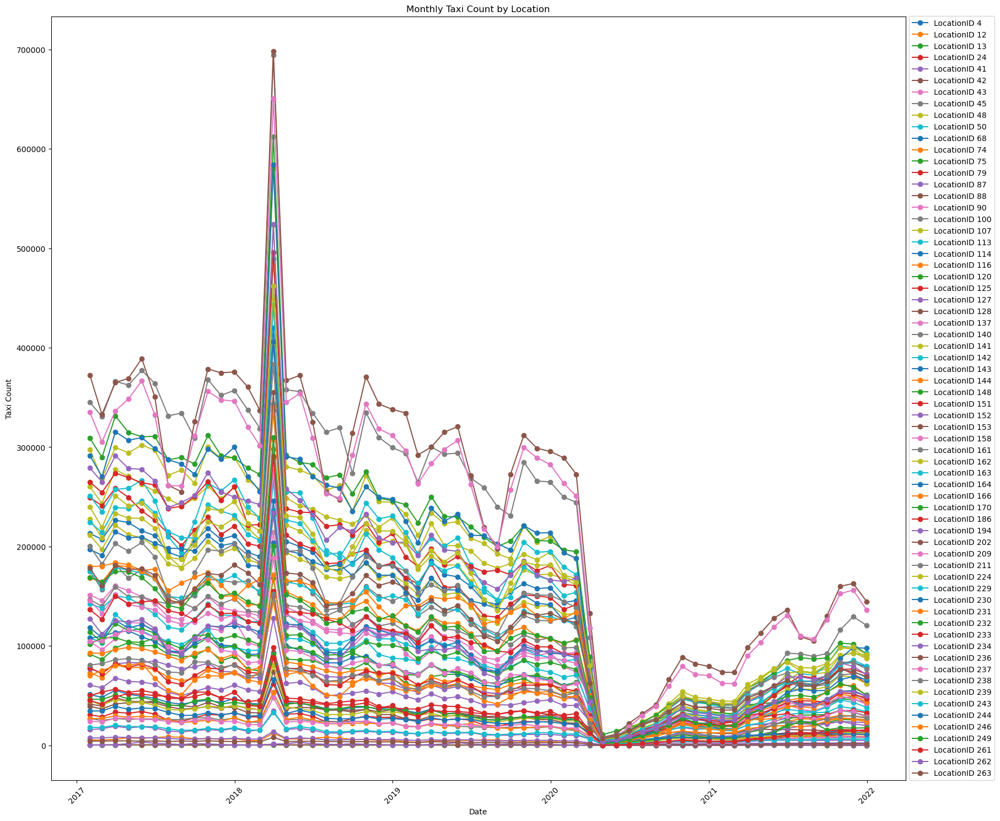

<Figure size 640x480 with 0 Axes>

In [16]:
# Get LocationID
location_ids = monthly_D.index.get_level_values('LocationID').unique()

# Create a drawing and axis object
fig, ax = plt.subplots(figsize=(20, 18))

# Traverse each LocationID, draw a Line chart and add a legends
for location_id in location_ids:
    data = monthly_D.loc[location_id]
    ax.plot(data.index, data.values, marker='o', linestyle='-', label='LocationID ' + str(location_id))

# Set Drawing Title and Axis Labels
ax.set_title('Monthly Taxi Count by Location')
ax.set_xlabel('Date')
ax.set_ylabel('Taxi Count')

# add legends
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# Rotate X-axis labels to avoid overlap
plt.xticks(rotation=45)

# display graphics
plt.show()

plt.savefig('line_plot.png', dpi=3000, bbox_inches='tight')

- Line graph according to PickUp_count monthly statistical indicator

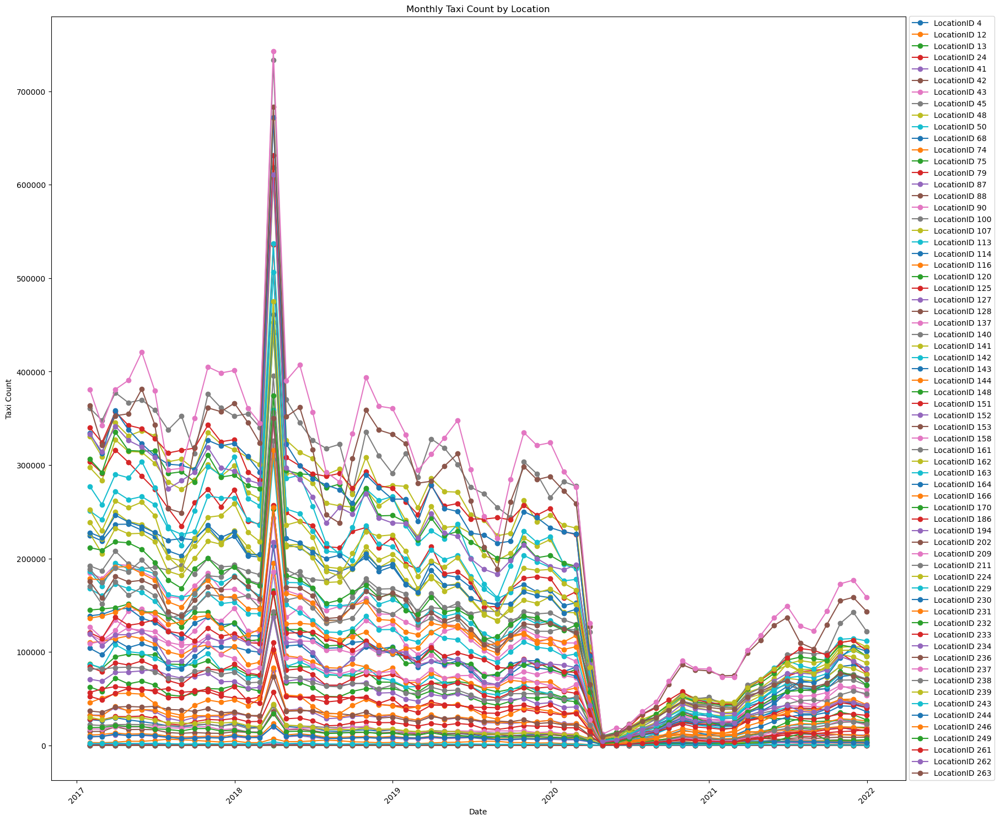

<Figure size 640x480 with 0 Axes>

In [17]:
# Create a drawing and axis object
fig, ax = plt.subplots(figsize=(20, 18))

# Traverse each LocationID, draw a Line chart and add a legends
for location_id in location_ids:
    data = monthly_P.loc[location_id]
    ax.plot(data.index, data.values, marker='o', linestyle='-', label='LocationID ' + str(location_id))

# Set Drawing Title and Axis Labels
ax.set_title('Monthly Taxi Count by Location')
ax.set_xlabel('Date')
ax.set_ylabel('Taxi Count')

# add legends
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# Rotate X-axis labels to avoid overlap
plt.xticks(rotation=45)

# display graphics
plt.show()

plt.savefig('line_plot.png', dpi=3000, bbox_inches='tight')

- The two line plots above reveal a noticeable decline in taxi demand during the months of January, July, and December, which is consistent with the patterns observed in the data from 2019. This indicates a clear cyclical variation in demand. However, the year 2020 experienced a significant impact from the COVID-19 pandemic, resulting in a nearly complete reduction in taxi demand, and subsequently showing an increasing trend in taxi demand.

- Nevertheless, it is still evident that during January, July, and December of 2021, there is a declining trend in the data. Despite the overall recovery in taxi demand after the pandemic, these specific months continue to exhibit decreased taxi demand.

## Part 2: Real Estate Data

In [18]:
property_data = pd.read_csv('programing data/Real_Estate.csv')

/var/folders/6g/ybj4cz9s1wd3hg435tvgpfb00000gn/T/ipykernel_42242/2346034905.py:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  property_data = pd.read_csv('programing data/Real_Estate.csv')


In [19]:
property_data.head(5)

,BBLE,BLDGCL,TAXCLASS,EXT,STORIES,FULLVAL,LocationID,AVLAND,AVTOT,EXLAND,EXTOT,YEAR
0,1022552000,Q1,4,NaN,1.0,114000000,128,50085000.0,50310000.0,50085000.0,50310000.0,2011
1,1022550001,Q1,4,NaN,1.0,16506000,128,6861870.0,7134750.0,6861870.0,7134750.0,2012
2,1022552000,Q1,4,NaN,1.0,131813000,128,51286500.0,57522801.5,51286500.0,57522801.5,2018
3,1022552000,Q1,4,NaN,1.0,127974000,128,51286500.0,55882507.0,51286500.0,55882507.0,2017
4,1022550001,Q1,4,NaN,1.0,18439000,128,6973290.0,8051805.0,6973290.0,8051805.0,2017


In [20]:
property_data.dtypes

BBLE           object
BLDGCL         object
TAXCLASS       object
EXT            object
STORIES       float64
FULLVAL         int64
LocationID      int64
AVLAND        float64
AVTOT         float64
EXLAND        float64
EXTOT         float64
YEAR            int64
dtype: object

- View the Link chart of the overall price of the regional real estate

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 25151 (\N{CJK UNIFIED IDEOGRAPH-623F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20135 (\N{CJK UNIFIED IDEOGRAPH-4EA7}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 24635 (\N{CJK UNIFIED IDEOGRAPH-603B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20215 (\N{CJK UNIFIED IDEOGRAPH-4EF7}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26684 (\N{CJK UNIFIED IDEOGRAPH-683C})

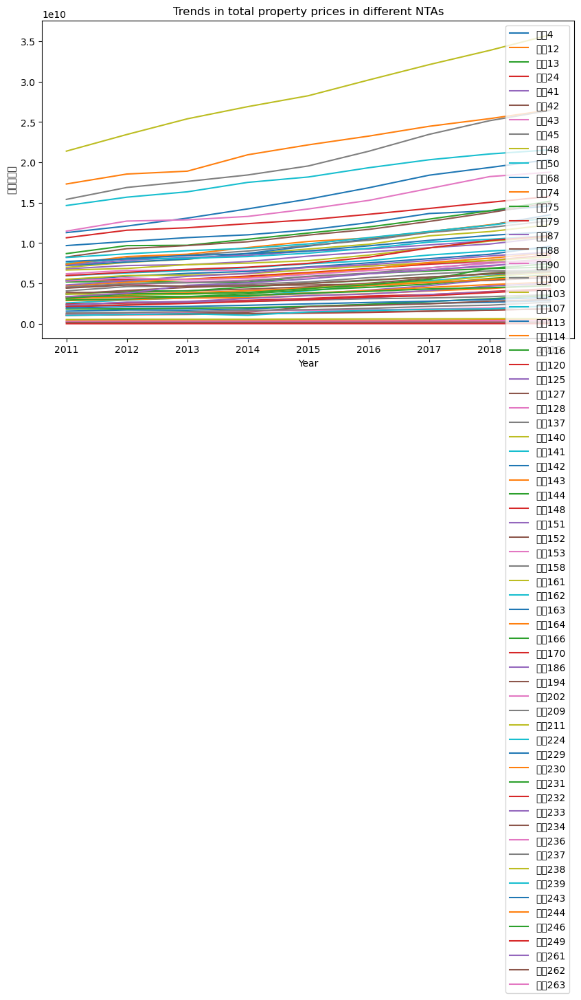

In [21]:
# Calculate the total property price by year and region ID grouping
grouped_data = property_data.groupby(['YEAR', 'LocationID'])['FULLVAL'].sum().reset_index()

# Draw Line chart
plt.figure(figsize=(10, 6))  # Set Graph Size

# Traverse lines across different regions
for location in grouped_data['LocationID'].unique():
    location_data = grouped_data[grouped_data['LocationID'] == location]
    plt.plot(location_data['YEAR'], location_data['FULLVAL'], label=f'地区{location}')

plt.xlabel('Year')  # Set X-axis labels
plt.ylabel('房产总价格')  # Set Y-axis labels
plt.title('Trends in total property prices in different NTAs')
plt.legend()  
plt.show()  

- From this graph, it can be seen that the total value of real estate in different regions is steadily increasing. This means that housing prices have been rising in the past 10 years, and the magnitude of the increase is relatively stable, without significant fluctuations or sudden changes. (The slope remains almost unchanged)

## Part 3: The Relationship Between Real Estate And Taxi Data

- Due to the severe lack of taxi data from 2016 and before, which only includes a few months of data and is one tenth of the existing data, only taxi and real estate data from 2017 onwards can be used to explore the relationship between real estate and taxi data

- For the convenience of distinguishing between taxi data and real estate data, taxi_data points to df, which is taxi data.

In [22]:
taxi_data = pd.read_csv('programing data/2017-2021.csv')

In [23]:
property_data = property_data.groupby(['YEAR', 'LocationID'])['FULLVAL'].sum().reset_index()

In [24]:
taxi_data.head(5)

,Date,PU_passenger,PUTripDistance_count,PickUp_count,PU_fare,PUT_fare,LocationID,DO_passenger,DOTripDistance_count,DropOff_count,DO_fare,DOT_fare
0,2017-01-01,2452.0,4936.95,1437,19724.81,23553.57,4,3438.0,5338.68,2027,22617.61,27752.81
1,2017-01-01,316.0,761.80,179,2890.50,3215.64,12,512.0,1216.13,276,4405.00,4903.49
2,2017-01-01,3792.0,9246.49,2101,33698.50,39895.33,13,4500.0,10568.66,2486,38450.30,44998.68
3,2017-01-01,1714.0,2916.34,991,11666.00,14270.05,24,2094.0,4034.95,1225,15293.50,19001.83
4,2017-01-01,3023.0,4862.40,1806,20081.50,23956.00,41,4879.0,9937.41,2856,37805.04,45706.13


- By year, LocationID aggregates data and merges it with the real estate table to find the relationships between real estate prices and taxi data

In [25]:
# Convert 'Date' column to datetime format
taxi_data['Date'] = pd.to_datetime(taxi_data['Date'])
taxi_data['YEAR'] = taxi_data['Date'].dt.year

# Group by LocationID and Year, and sum the desired columns
taxi_data_grouped = taxi_data.groupby(['LocationID', 'YEAR']).agg({
    'PU_passenger': 'sum',
    'PUTripDistance_count': 'sum',
    'PickUp_count': 'sum',
    'PU_fare': 'sum',
    'DO_passenger': 'sum',
    'DropOff_count': 'sum',
    'DO_fare': 'sum',
    'DOT_fare': 'sum'
}).reset_index()

# Filter the data for 2017-2019
taxi_data_filtered = taxi_data_grouped[(taxi_data_grouped['YEAR'] >= 2017) & (taxi_data_grouped['YEAR'] <= 2019)]

property_data_filtered = property_data[(property_data['YEAR'] >= 2017) & (property_data['YEAR'] <= 2019)]

# Merge the filtered datasets
merged_data = pd.merge(taxi_data_filtered, property_data_filtered, on=['LocationID', 'YEAR'], suffixes=('_taxi', '_property'))


In [26]:
merged_data.dtypes

LocationID                int64
YEAR                      int64
PU_passenger            float64
PUTripDistance_count    float64
PickUp_count              int64
PU_fare                 float64
DO_passenger            float64
DropOff_count             int64
DO_fare                 float64
DOT_fare                float64
FULLVAL                   int64
dtype: object

In [27]:
X = merged_data[['PU_passenger', 'PUTripDistance_count', 'PickUp_count', 'PU_fare', 'DO_passenger', 'DropOff_count', 'DO_fare']]
y = merged_data['FULLVAL']
X = sm.add_constant(X)
model = sm.OLS(y, X)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                FULLVAL   R-squared:                       0.889
Model:                            OLS   Adj. R-squared:                  0.885
Method:                 Least Squares   F-statistic:                     217.8
Date:                Sat, 29 Jul 2023   Prob (F-statistic):           3.52e-87
Time:                        23:50:26   Log-Likelihood:                -4534.2
No. Observations:                 198   AIC:                             9084.
Df Residuals:                     190   BIC:                             9111.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                -1.606e+08 

 ### conclusion：

- R-squared and Adj. R-squared: R-squared represents the percentage of variance in the dependent variable (FULLVAL - house price) that can be explained by the independent variables (PU_passenger, PUTripDistance_count, PickUp_count, etc.). The R-squared value of 0.889 indicates that approximately 88.9% of the house price variability can be explained by the independent variables. The adjusted R-squared value of 0.885 takes into account the number of independent variables and the sample size.
- F-statistic and Prob (F-statistic): The F-statistic tests the overall significance of the model, i.e., whether at least one independent variable has a significant impact on the dependent variable. The Prob (F-statistic) value of 3.52e-87, very close to zero, indicates that the model is statistically significant as a whole.
- t-statistic and P>|t|: The t-statistic tests whether each independent variable's coefficient is significantly different from zero. P>|t| represents the significance level of the t-statistic. If P>|t| is less than a significance level (e.g., 0.05), the coefficient of the corresponding independent variable is considered statistically significant, indicating a significant impact on the dependent variable.
- Omnibus, Prob(Omnibus), Jarque-Bera (JB), Skew, Kurtosis: These statistics are used to test assumptions of the regression model, including normality and independence of error terms. In this model, Prob(Omnibus) has a value of 0.002, and Prob(JB) has a value of 3.88e-06, both smaller than the commonly used significance level of 0.05, indicating that the model's assumptions are met

- Use the correlation coefficient matrix to demonstrate the correlation between FULLVAL (real estate price) and other variables.

In [28]:
merged_data[['PU_passenger', 'PUTripDistance_count', 'PickUp_count', 'PU_fare', 'DO_passenger', 'DropOff_count', 'DO_fare', 'FULLVAL']].corr()

,PU_passenger,PUTripDistance_count,PickUp_count,PU_fare,DO_passenger,DropOff_count,DO_fare,FULLVAL
PU_passenger,1.000000,0.979975,0.999468,0.990833,0.984216,0.982458,0.970495,0.829815
PUTripDistance_count,0.979975,1.000000,0.977406,0.995951,0.960005,0.955985,0.975223,0.840466
PickUp_count,0.999468,0.977406,1.000000,0.989530,0.984181,0.983408,0.969104,0.832982
PU_fare,0.990833,0.995951,0.989530,1.000000,0.970317,0.967489,0.975430,0.844876
DO_passenger,0.984216,0.960005,0.984181,0.970317,1.000000,0.999434,0.985819,0.842464
DropOff_count,0.982458,0.955985,0.983408,0.967489,0.999434,1.000000,0.983854,0.847768
DO_fare,0.970495,0.975223,0.969104,0.975430,0.985819,0.983854,1.000000,0.878051
FULLVAL,0.829815,0.840466,0.832982,0.844876,0.842464,0.847768,0.878051,1.000000


 ### conclusion：
 
 - The correlation coefficients between FULLVAL and PU_passenger, PUTripDistance_count, PickUp_count, PU_fare, DO_passenger, DropOff_count, and DO_fare are all positive and close to 1. This indicates a strong positive correlation between FULLVAL and these variables, implying that as these variables increase, there is a tendency for the housing price FULLVAL to also increase.
 
 - In general, correlation coefficients with absolute values above 0.8 are considered strong correlations. Therefore, the correlation coefficients between FULLVAL and the other variables, which are above 0.8, are relatively high.

## Part 4: Model Training

The goal of the plan is to utilize the strong relationship between real estate and taxi data to assist users in making real estate investment decisions. However, due to the impact of the COVID-19 pandemic in 2020, the taxi data almost dropped to zero, making it unsuitable for predicting future real estate trends. As an alternative approach, the plan is organized into the following steps:

A. Predicting Area Traffic and Business Activity using Taxi Data:

- Develop a separate model to predict future taxi demand (Pick_Up count and Drop_Off count) in different areas.
- Use the predicted taxi demand data to estimate the total number of passengers (PU_passenger + DO_passenger). 

This section can provide valuable insights into area traffic and business activity.

B. Forecasting the Overall Trend of Real Estate Prices using Linear Features of Real Estate Total Value:

- Utilize the linear features of real estate total value to build a model for predicting the overall trend of real estate prices in different areas.

This section can indicate the price trend of real estate in different regions based on historical prices.

C. Understanding the Impact of Different Variables on Real Estate Prices through OLS Regression Results:

- Use OLS regression analysis to determine the correlation between real estate prices and other variables (e.g., passenger number, drop off number, etc.). Infer the potential influence of taxi data on real estate prices in specific areas.

e.g., LOS regression coefficients of real estate FULLVAL: C1, C2, C3,...
    , Growth rates for each Column of taxi data: G1, G2, G3,...
    , Influence Factor= G1 * C1 + G2 * C2 + G3 * C3 + ...

By combining these steps, the plan aims to provide valuable information to investors in commercial real estate. Despite the unavailability of specific taxi data from 2020, the alternative approach enables the prediction of future real estate price trends and helps understand the underlying relationship between taxi data and real estate prices.

### Part A: Predicting Area Traffic and Business Activity using Taxi Data

- Establish a model to predict the number of Pick Up and Drop Off times for future taxis

- Capture values from July 2020 onwards for future numerical prediction (July 2020 is the approximate date for taxi recovery)

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


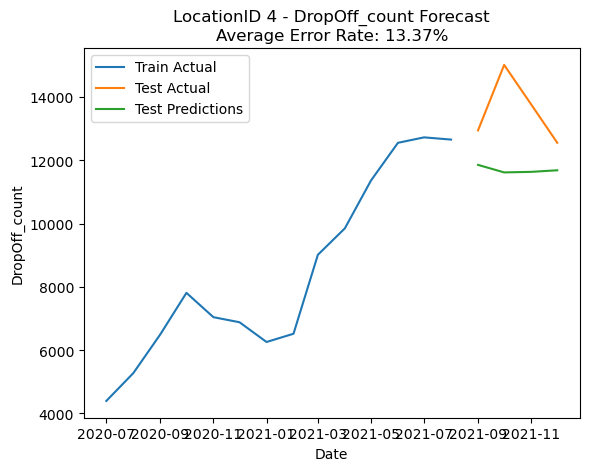

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


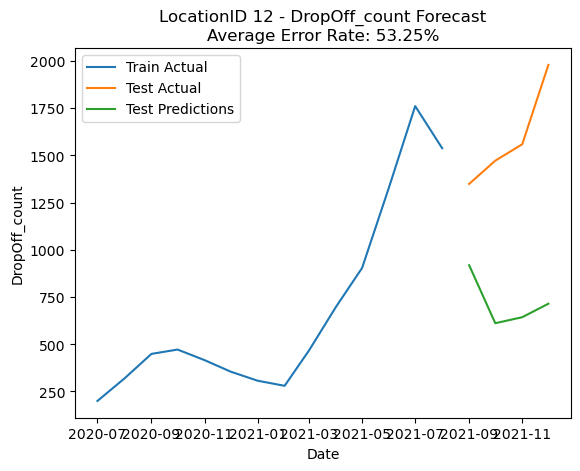

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


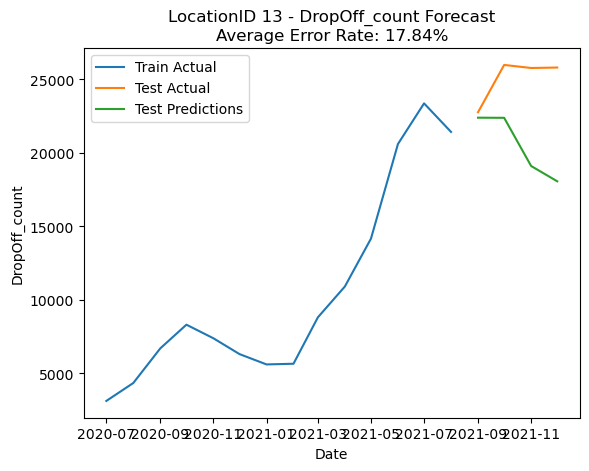

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


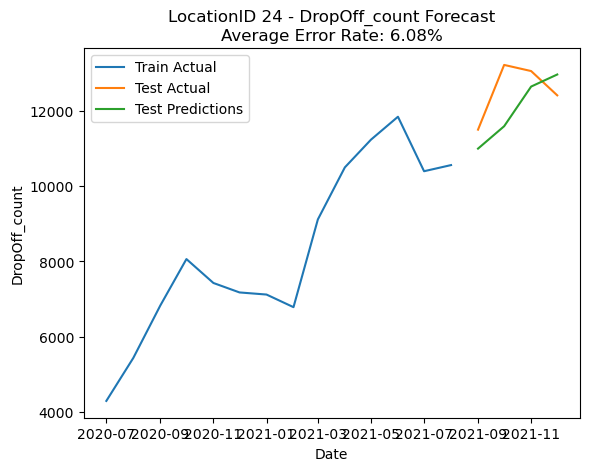

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


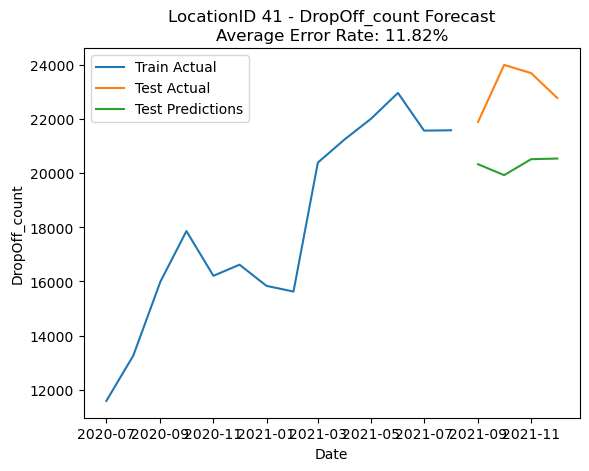

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


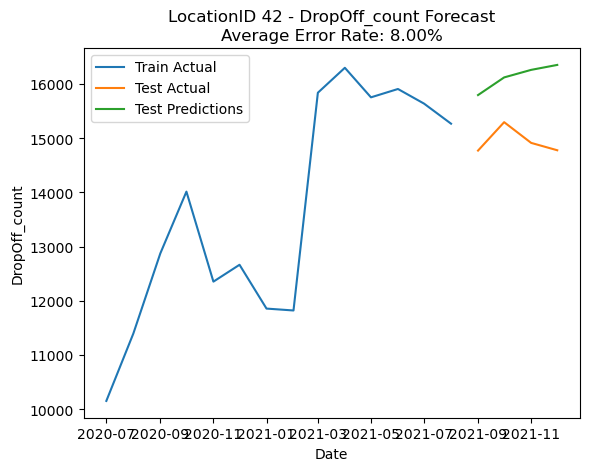

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


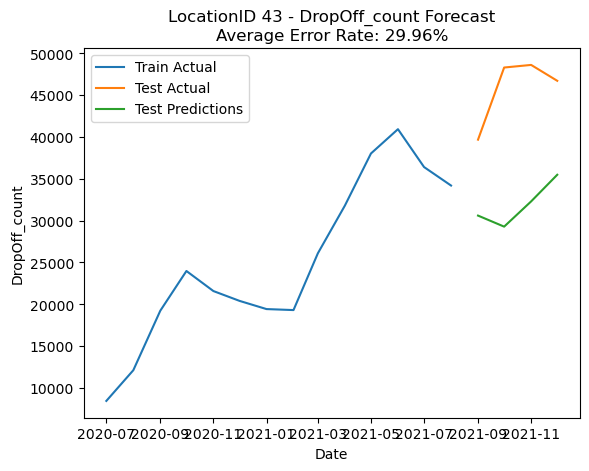

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


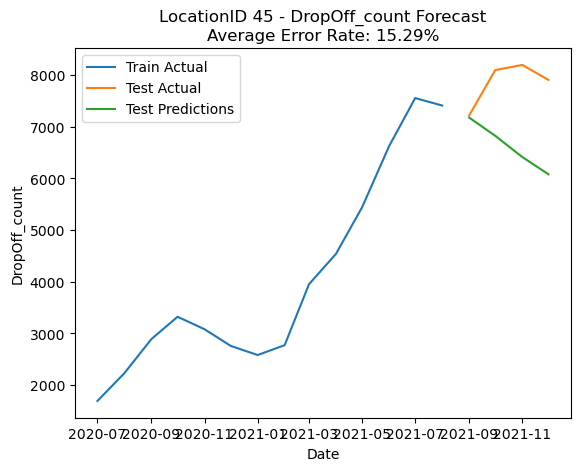

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


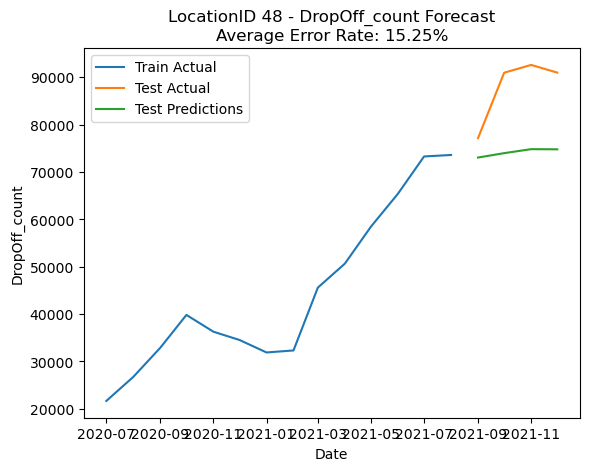

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


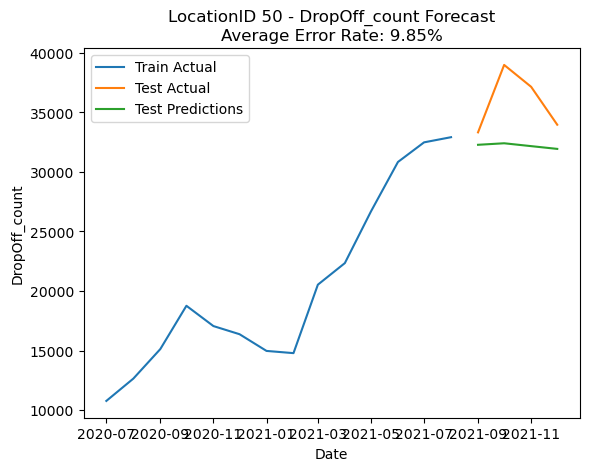

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


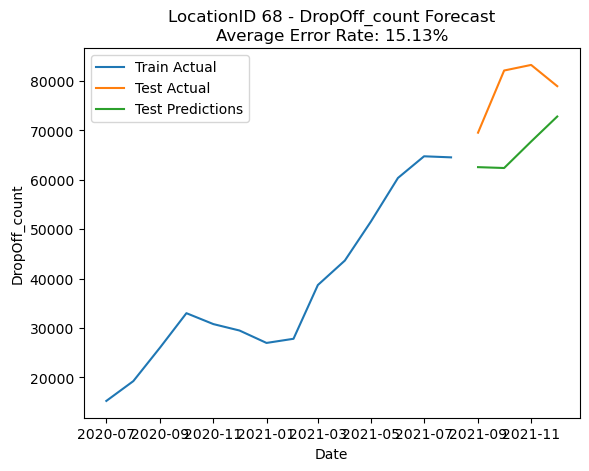

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


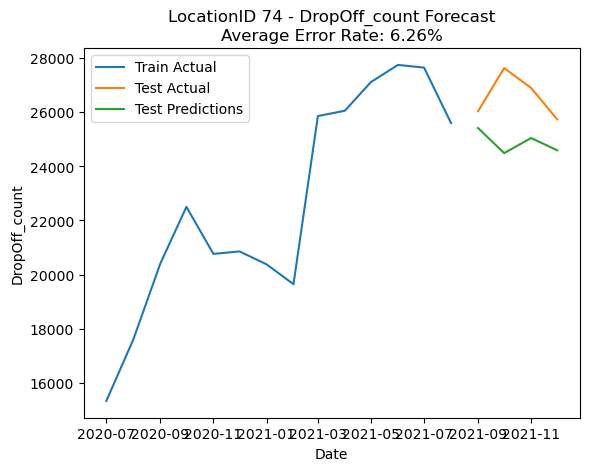

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


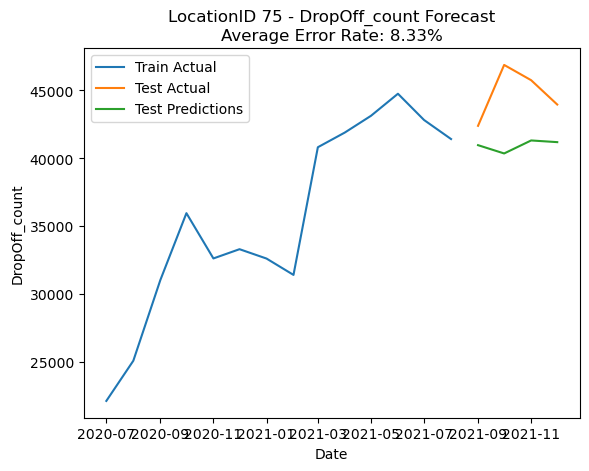

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


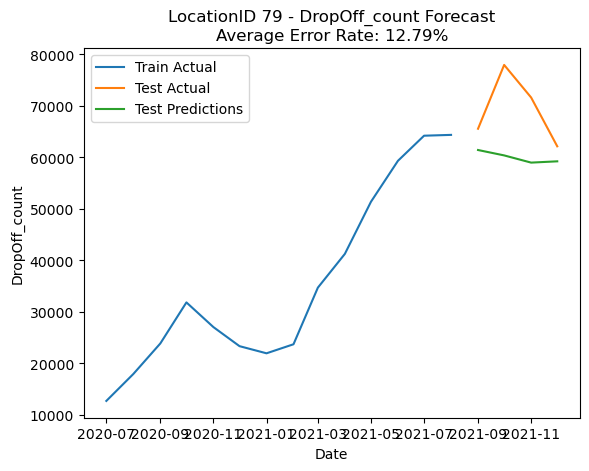

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


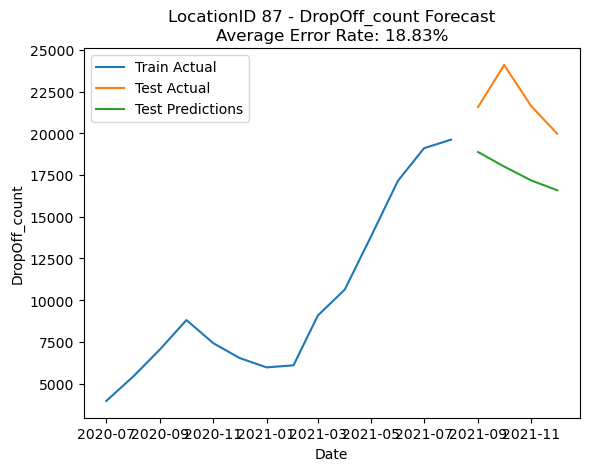

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


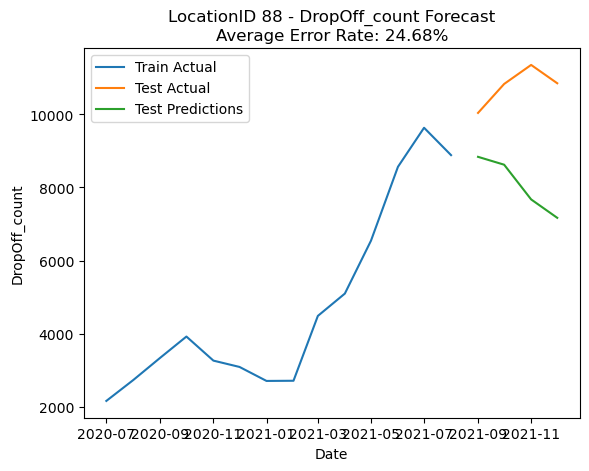

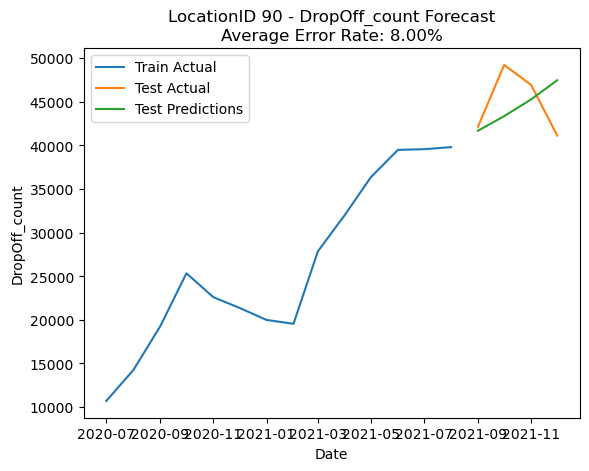

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


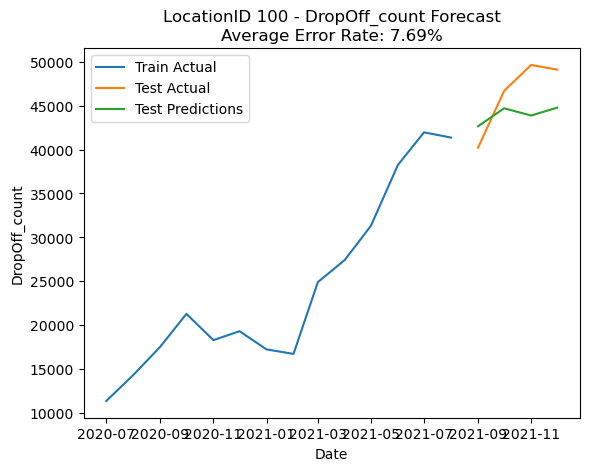

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


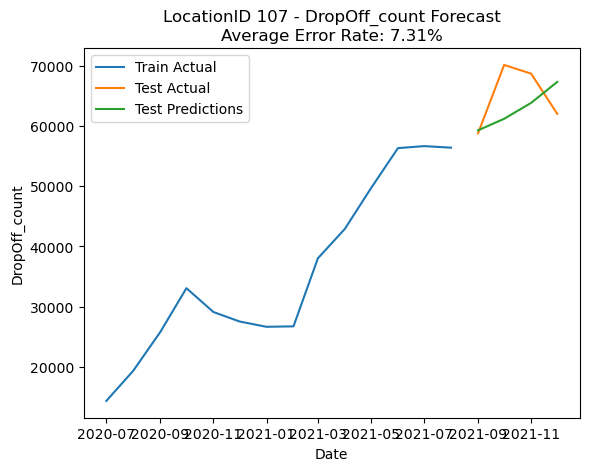

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


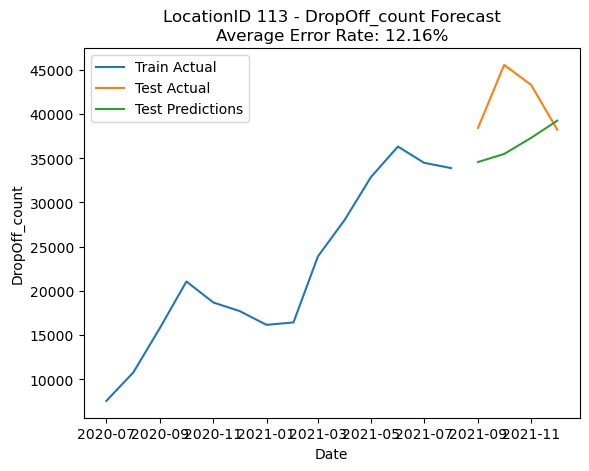

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


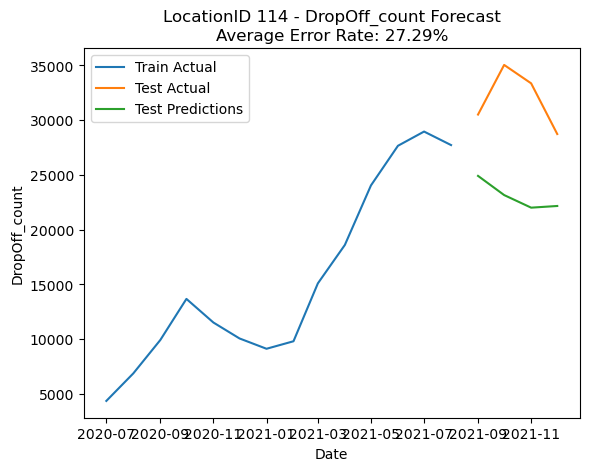

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


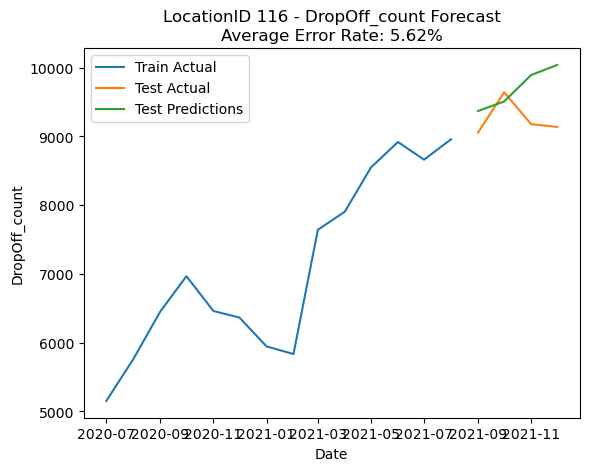

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


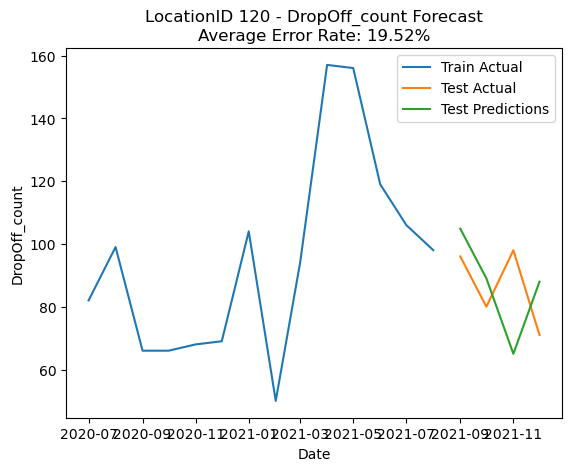

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


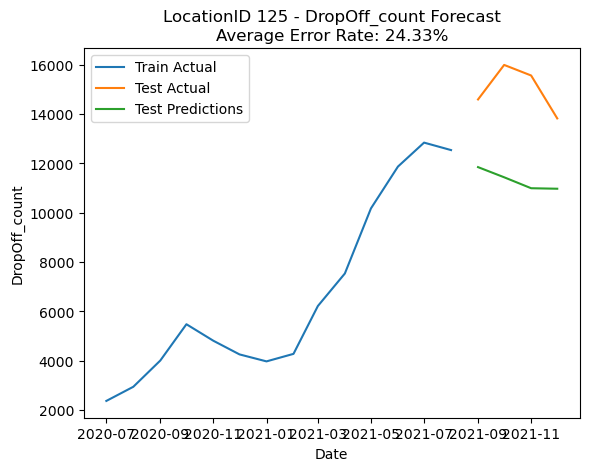

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


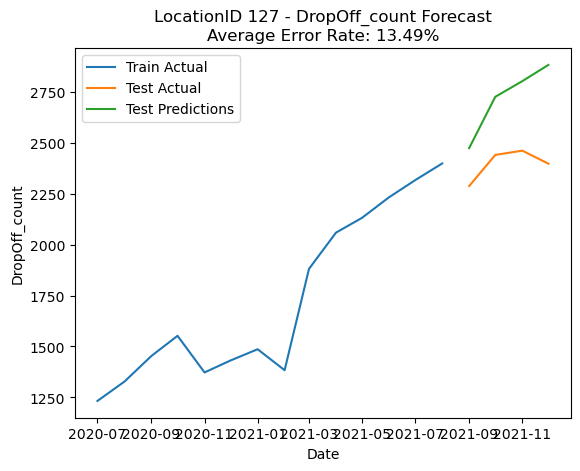

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


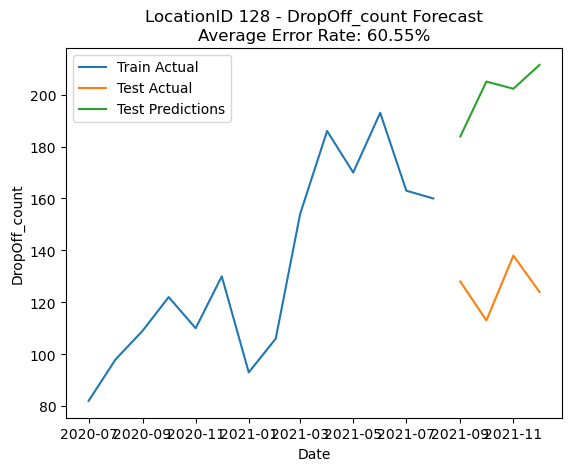

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


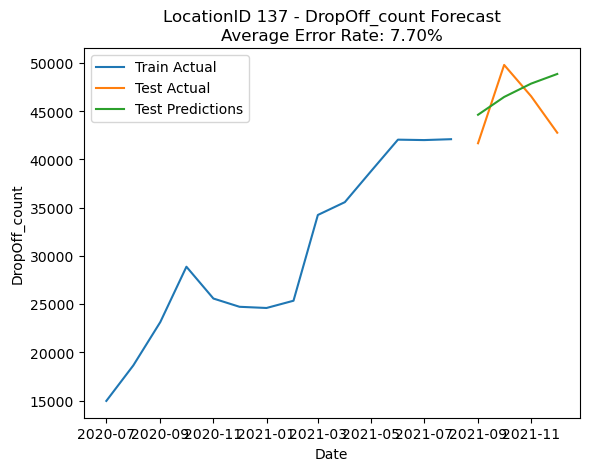

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


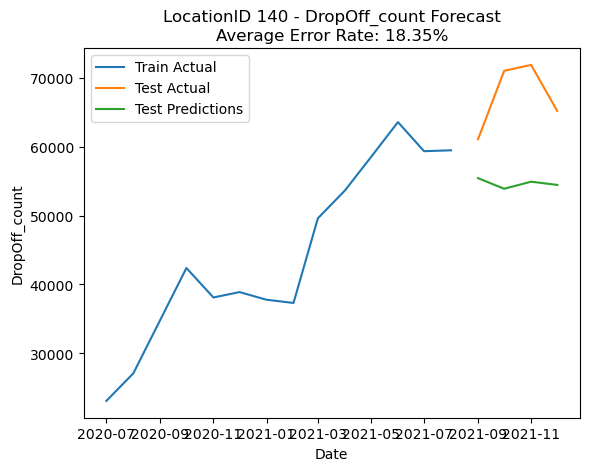

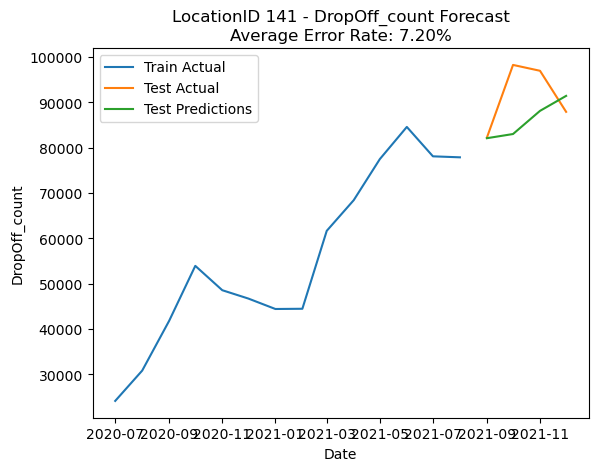

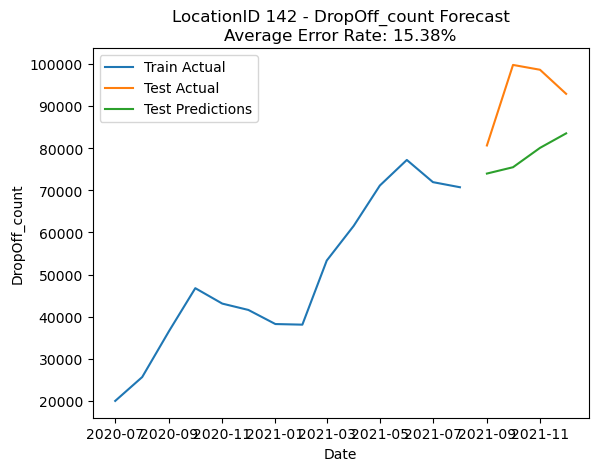

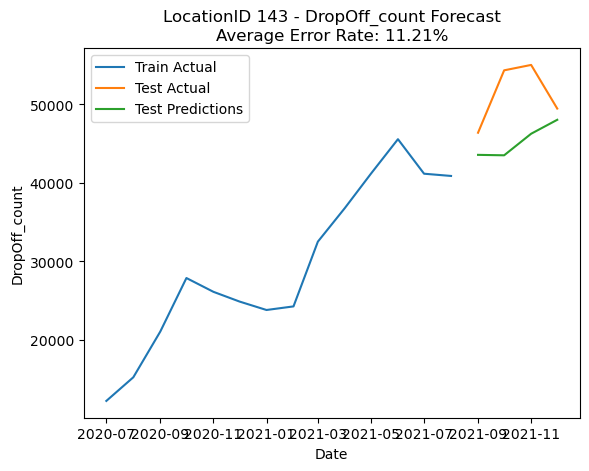

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


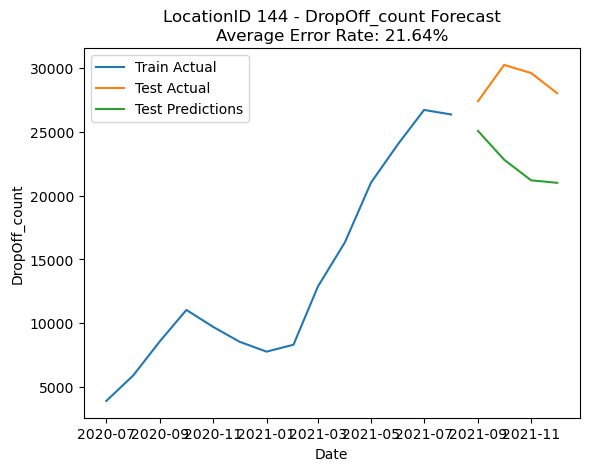

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


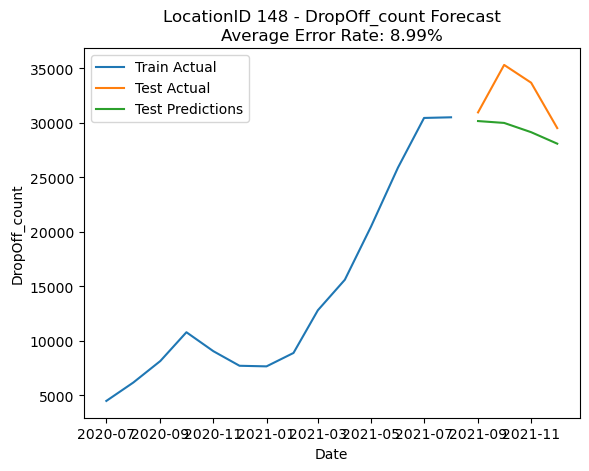

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


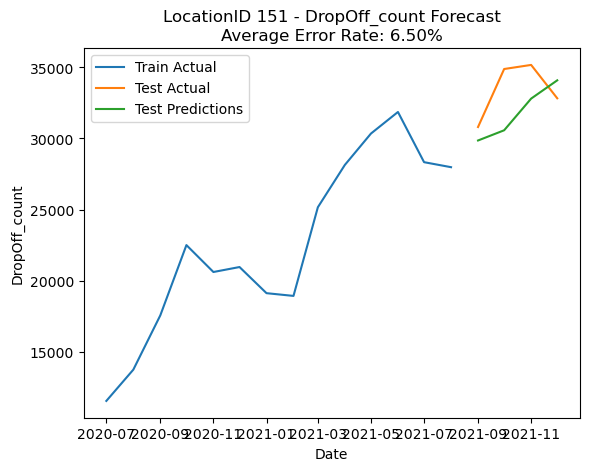

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


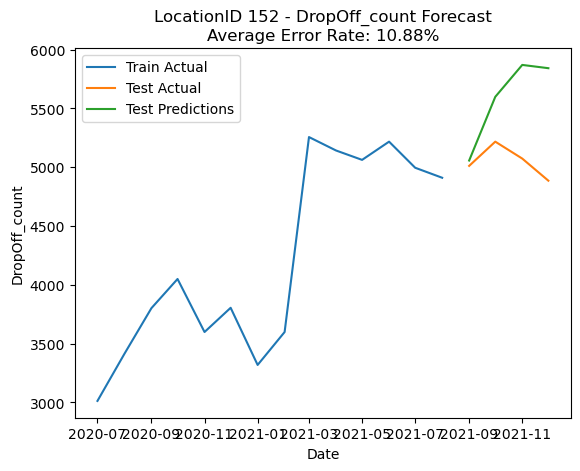

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


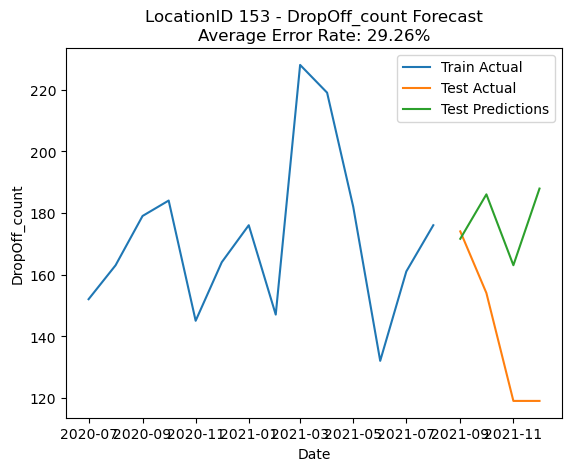

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


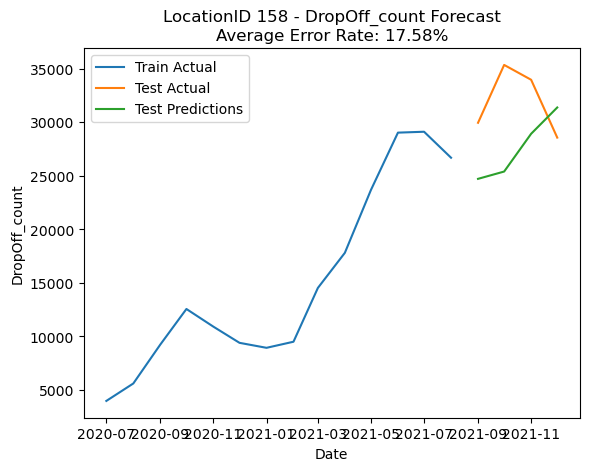

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


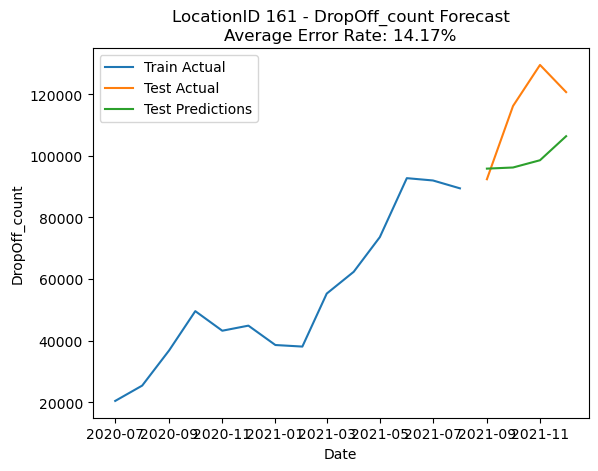

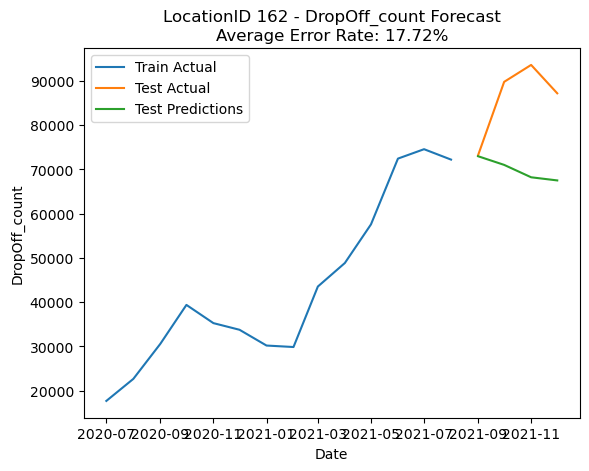

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


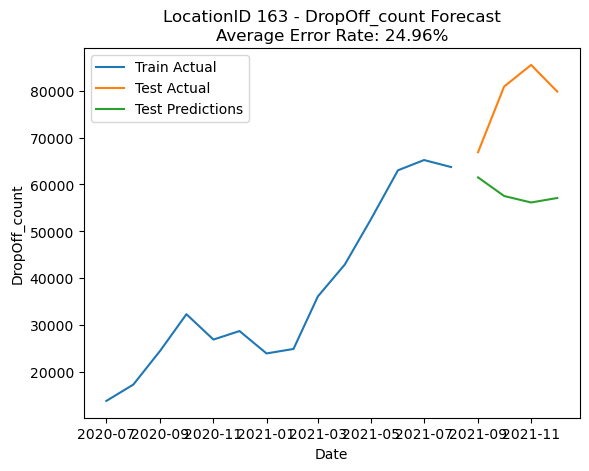

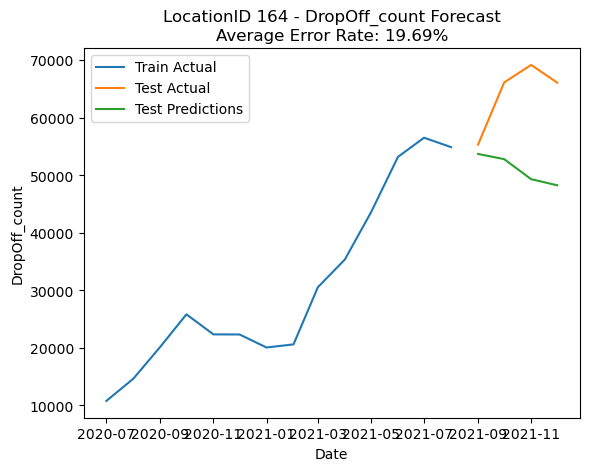

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


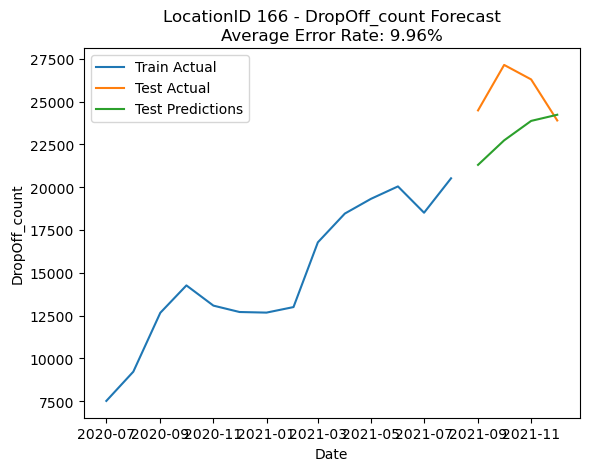

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


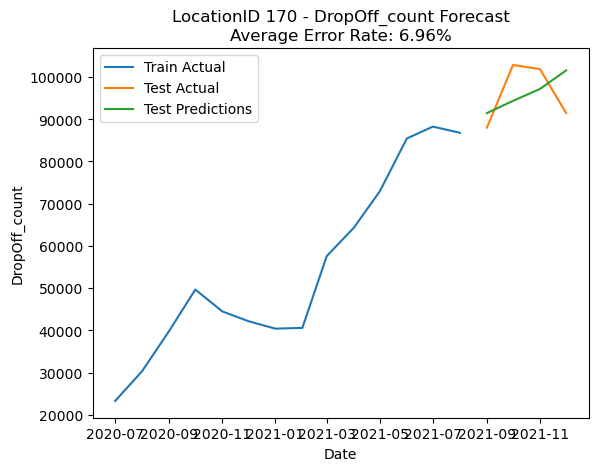

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


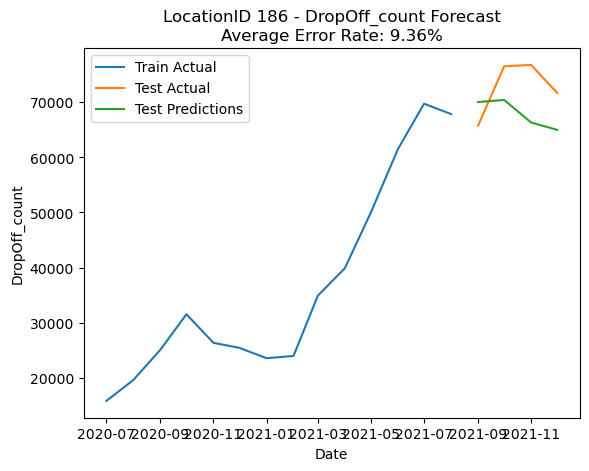

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


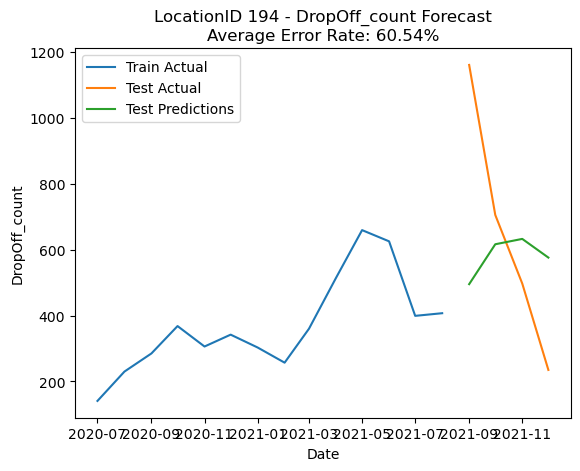

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


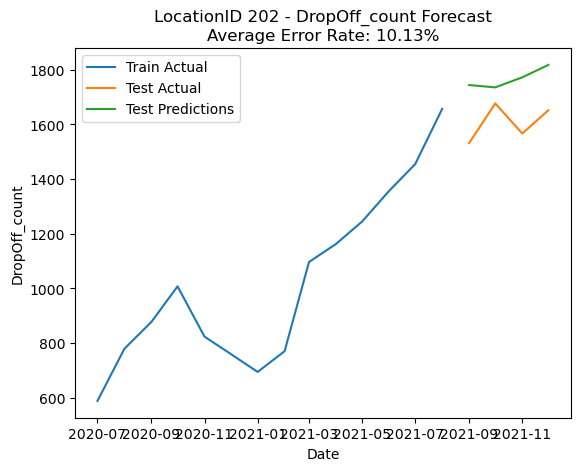

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


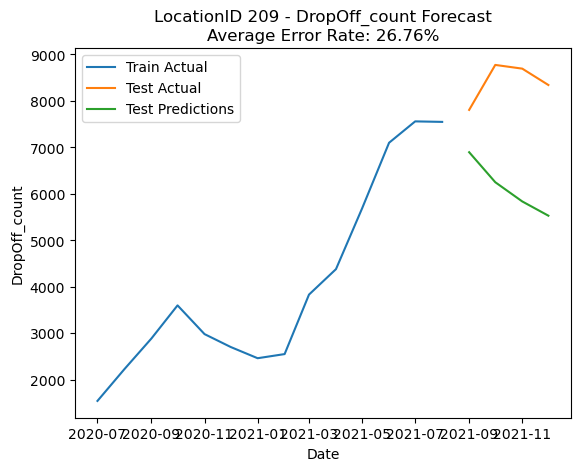

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


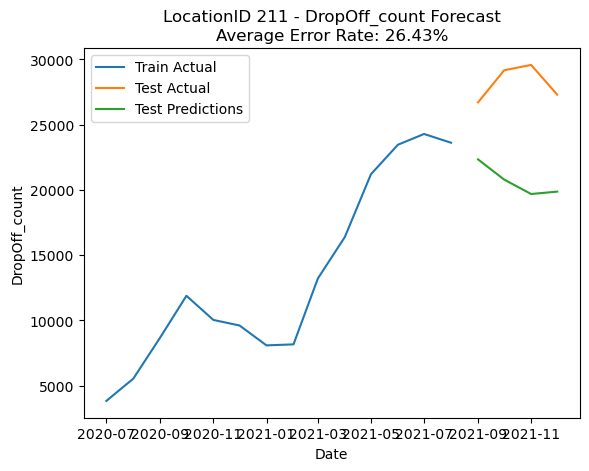

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


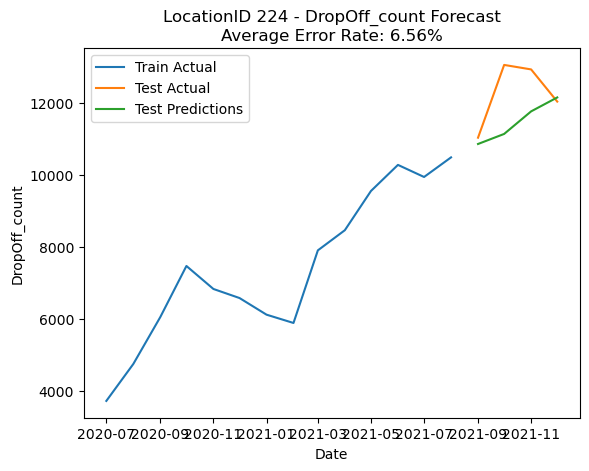

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


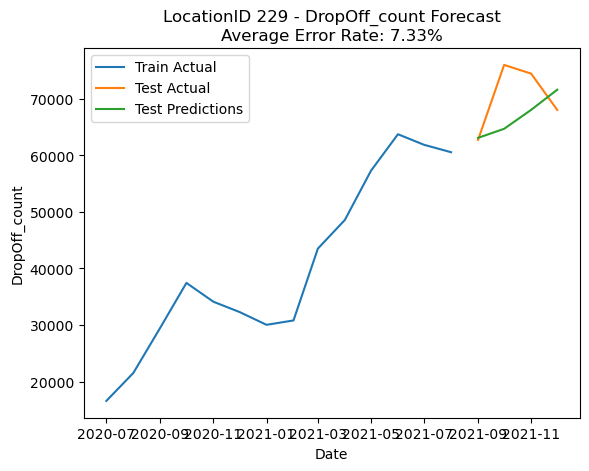

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


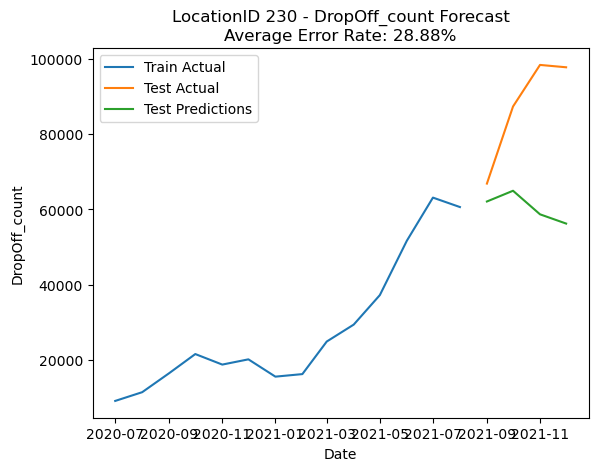

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


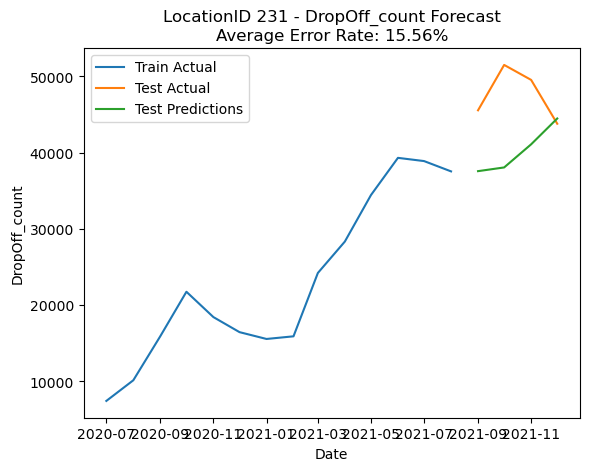

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


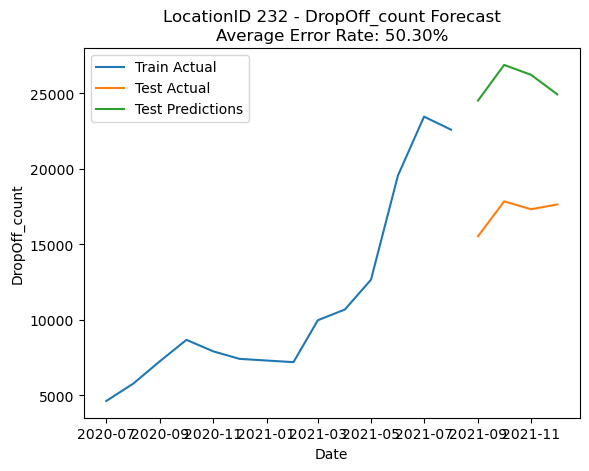

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


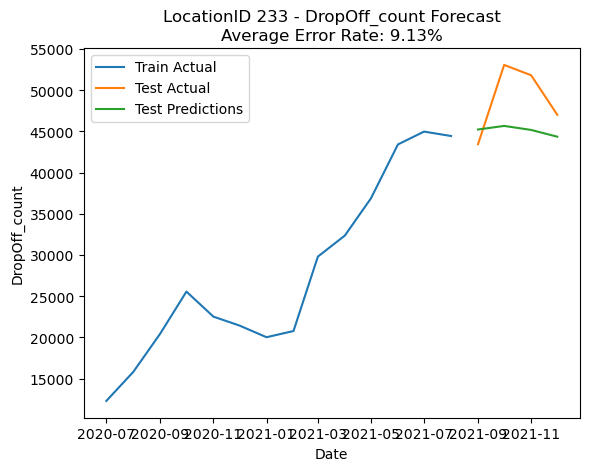

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


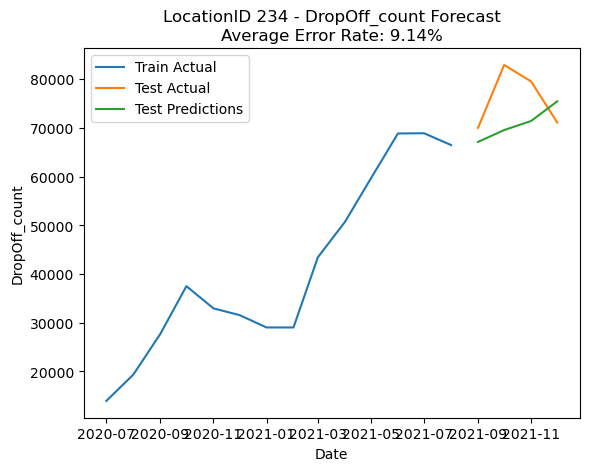

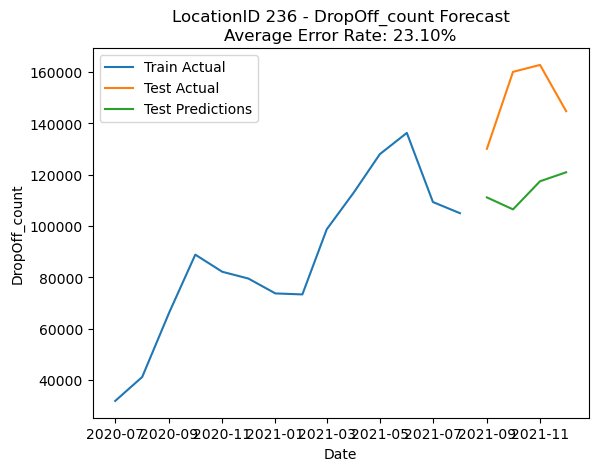

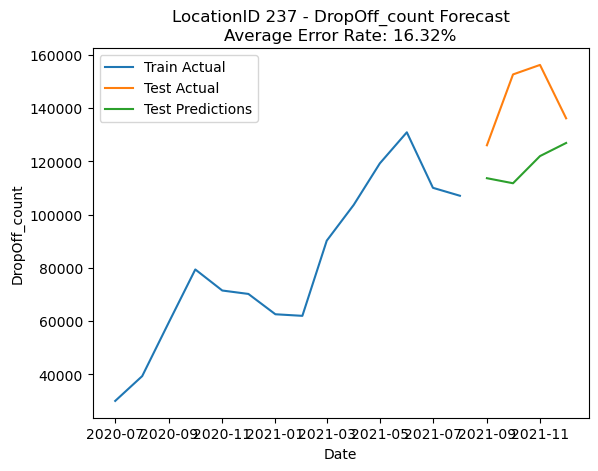

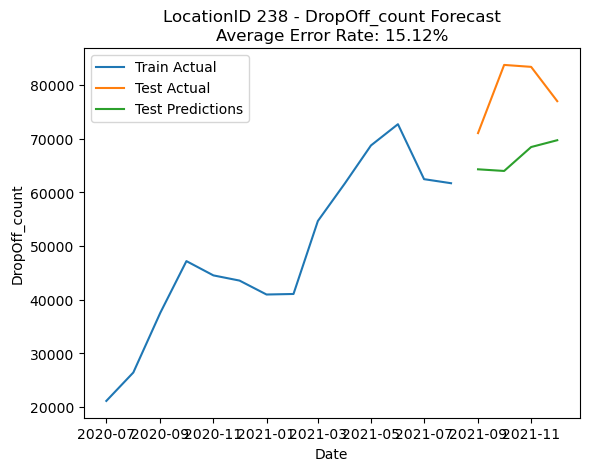

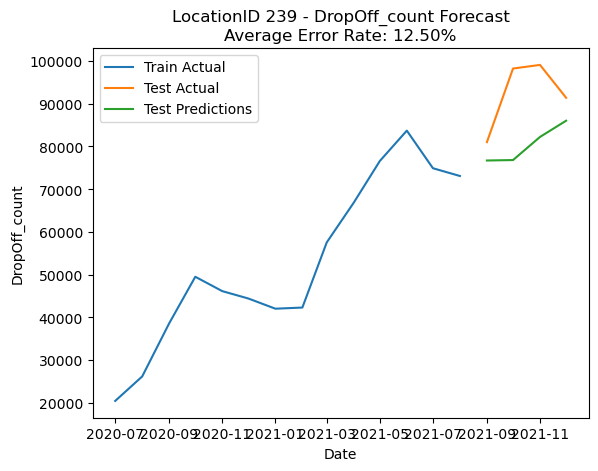

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


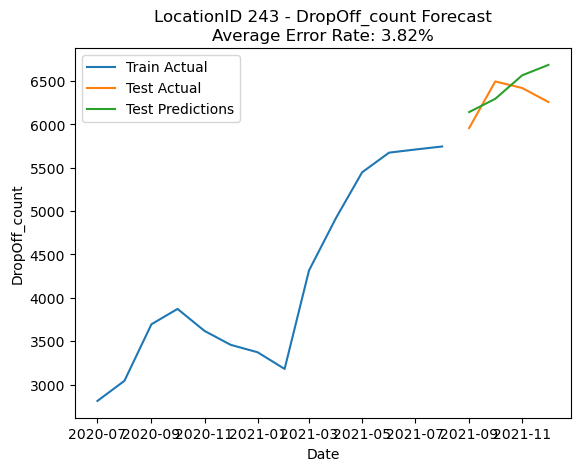

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


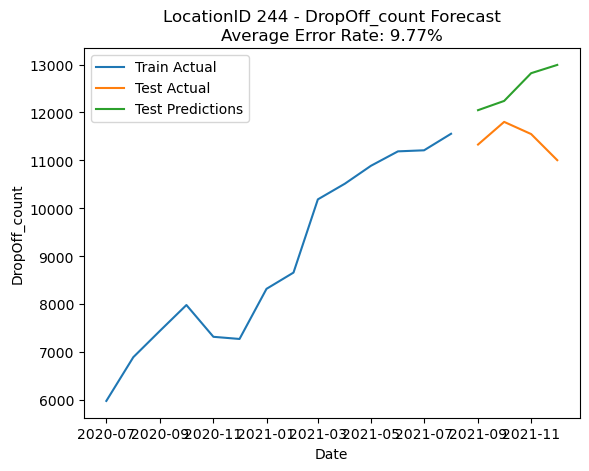

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


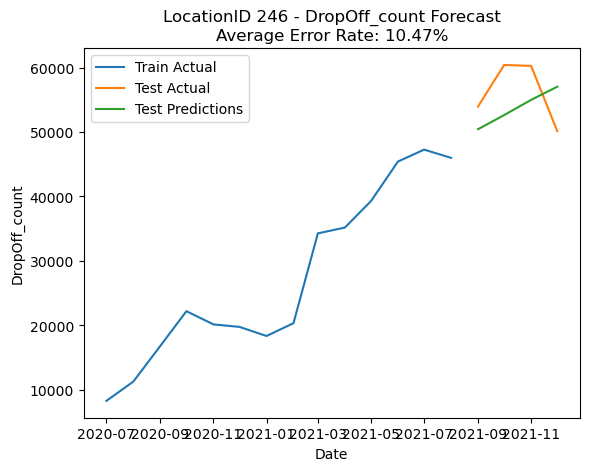

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


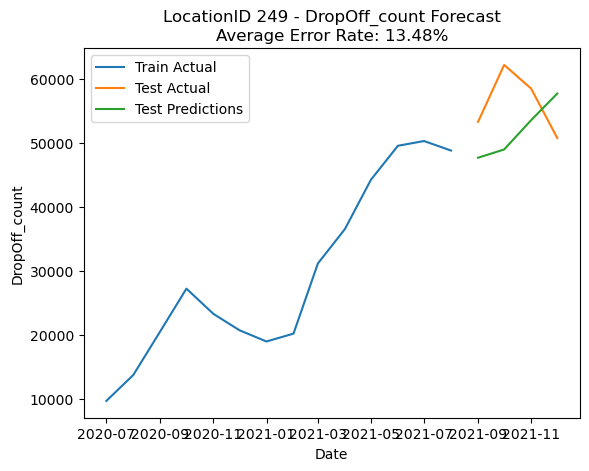

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


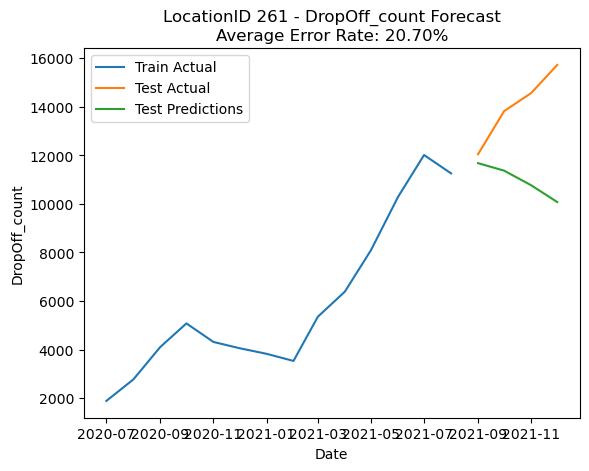

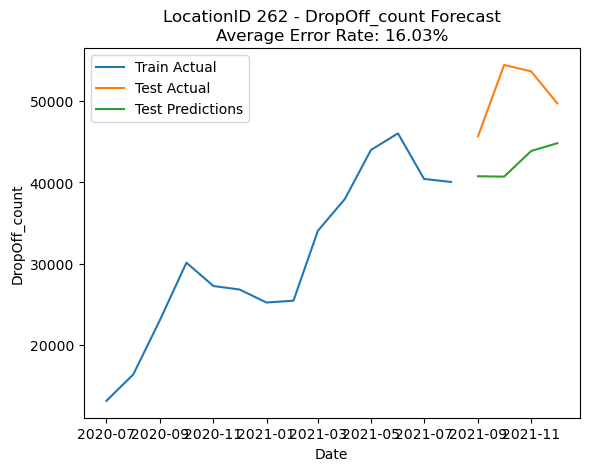

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


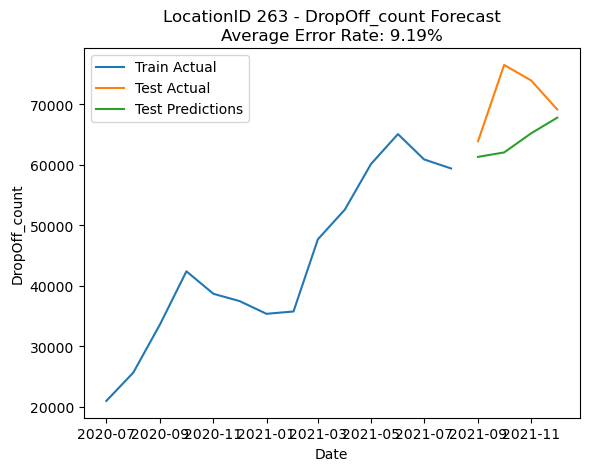

In [29]:
# Reading the csv
data = pd.read_csv('programing data/month2020.csv')

# Convert Date column to date time type
data['Date'] = pd.to_datetime(data['Date'])

values_to_delete = []

# Obtain a unique LocationID list
unique_location_ids = data['LocationID'].unique()

# Using the delete function from numpy to remove specific values.
updated_location_ids = np.delete(unique_location_ids, np.where(np.isin(unique_location_ids, values_to_delete)))

# Define ARIMA model parameters
order = (2, 1, 6)  # (AR order, difference order, MA order)


# Predict and plot data for each LocationID
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group = data[data['LocationID'] == location_id]

    # splitting the dataset into training and testing data
    train_size = int(len(group) * 0.8)
    train_data = group.iloc[:train_size]
    test_data = group.iloc[train_size:]

    # extracting training data and testing data
    train_passenger = train_data['DropOff_count'].values
    test_passenger_actual = test_data['DropOff_count'].values

    # To train an ARIMA
    model = ARIMA(train_passenger, order=order)
    model_fit = model.fit()

    # To make predictions using the trained ARIMA model,
    test_predictions_passenger = model_fit.predict(start=train_size, end=len(group)-1)

    # To calculate the error rate for the predictions made by the ARIMA model
    error_rate = np.abs(test_predictions_passenger - test_passenger_actual) / test_passenger_actual
    average_error_rate = np.mean(error_rate)


    # Draw Line chart
    plt.plot(train_data['Date'], train_passenger, label='Train Actual')
    plt.plot(test_data['Date'], test_passenger_actual, label='Test Actual')
    plt.plot(test_data['Date'], test_predictions_passenger, label='Test Predictions')
    plt.xlabel('Date')
    plt.ylabel('DropOff_count')
    plt.title(f'LocationID {location_id} - DropOff_count Forecast\nAverage Error Rate: {average_error_rate:.2%}')
    plt.legend()
    plt.show()


###### ARIMA 
    - DropOff_count

- Using 5 years of data for forecasting.

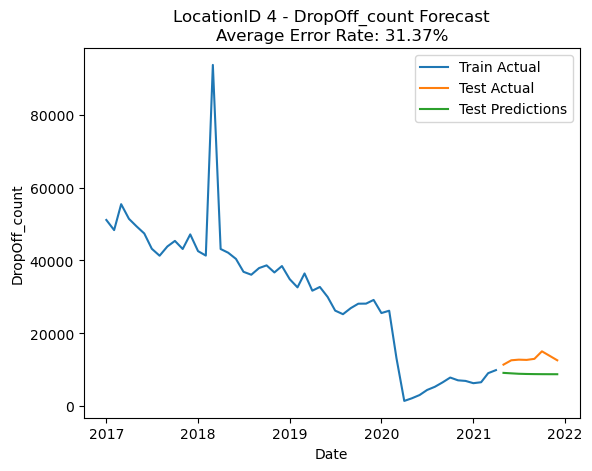

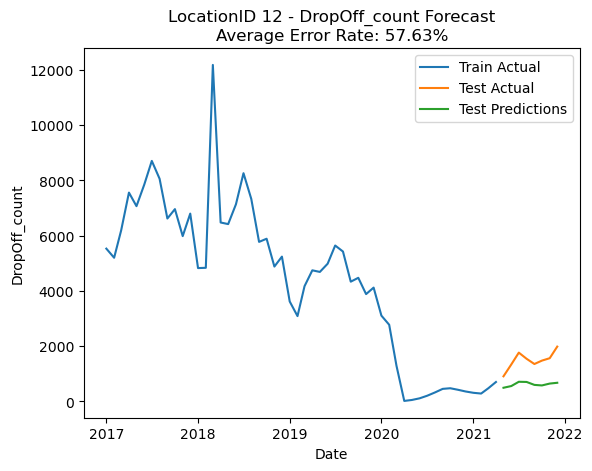

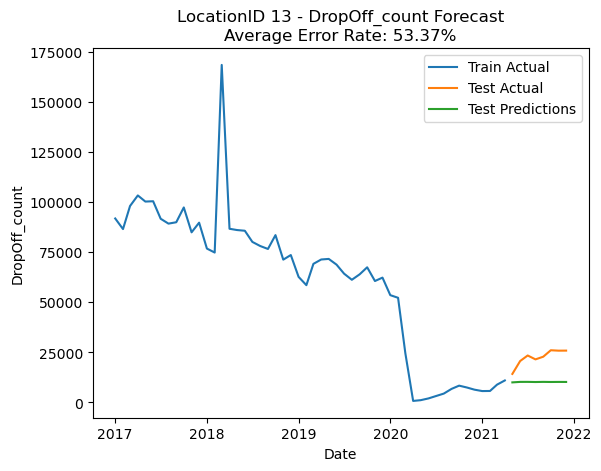

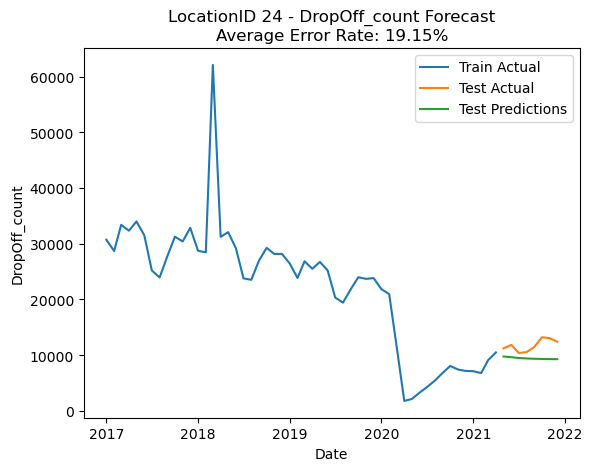

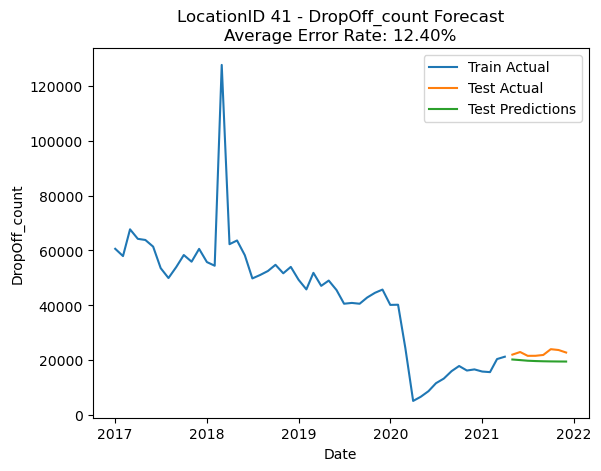

...

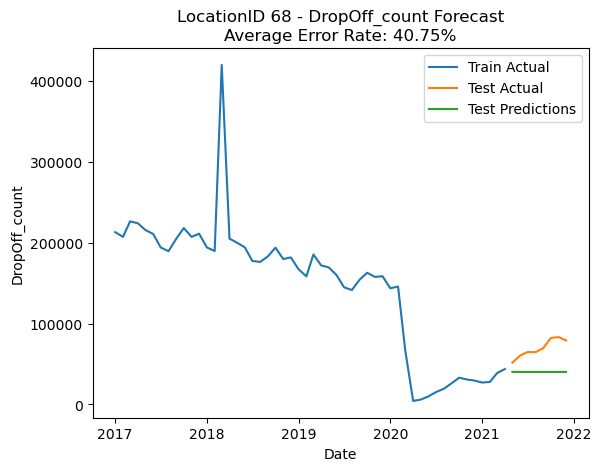

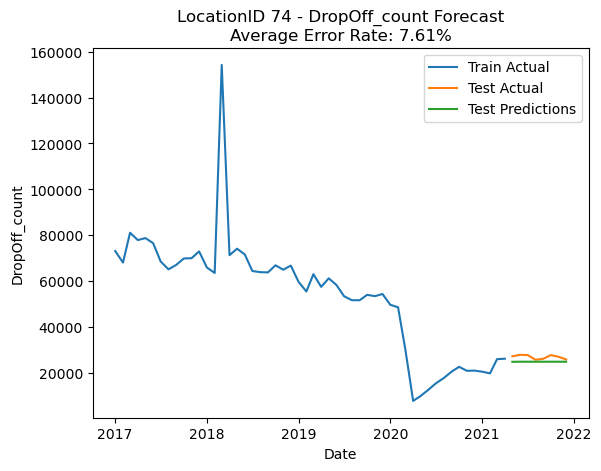

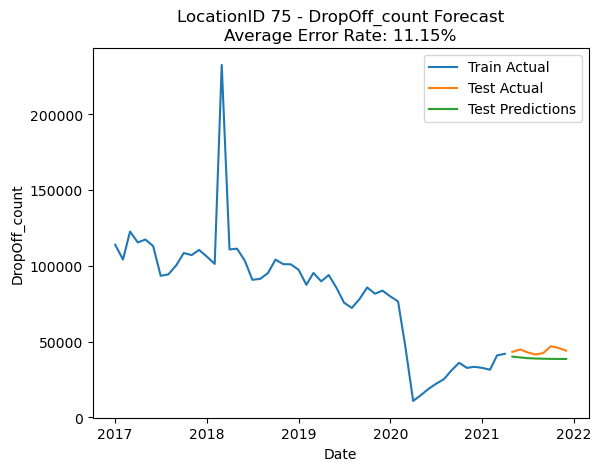

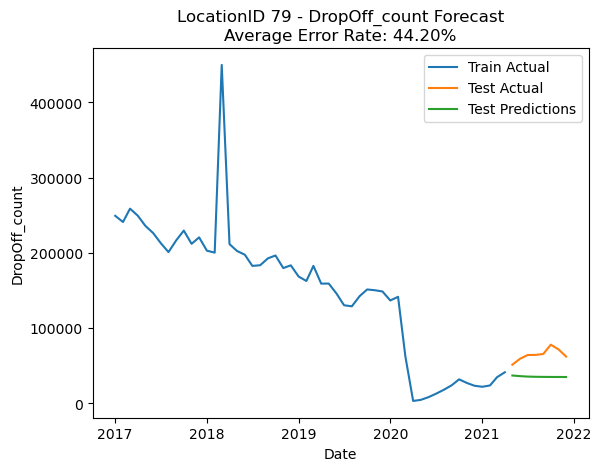

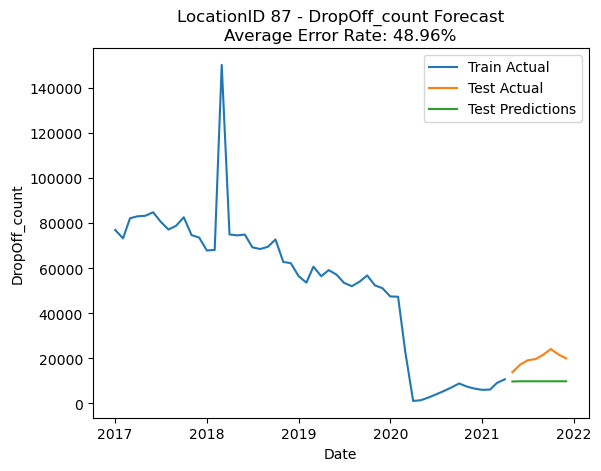

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


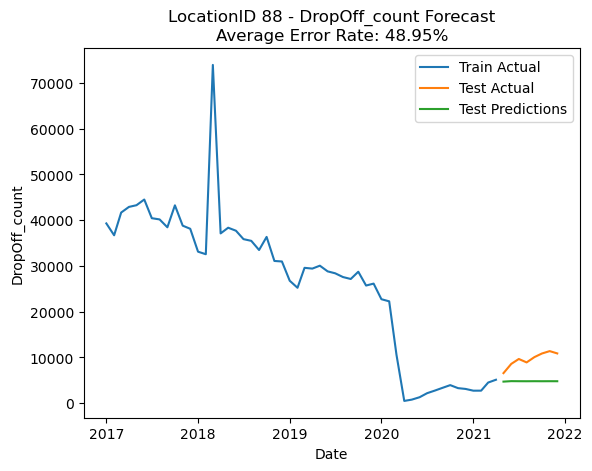

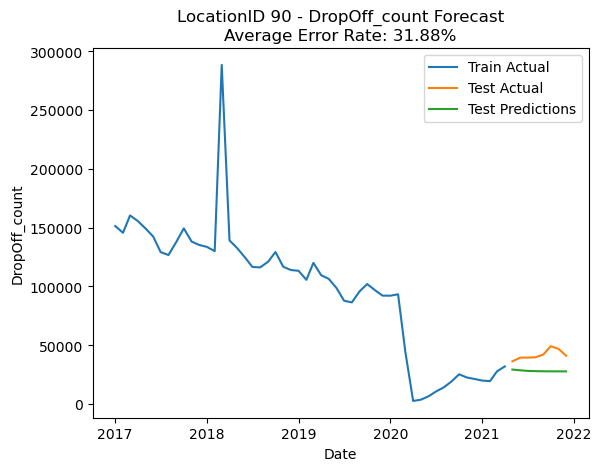

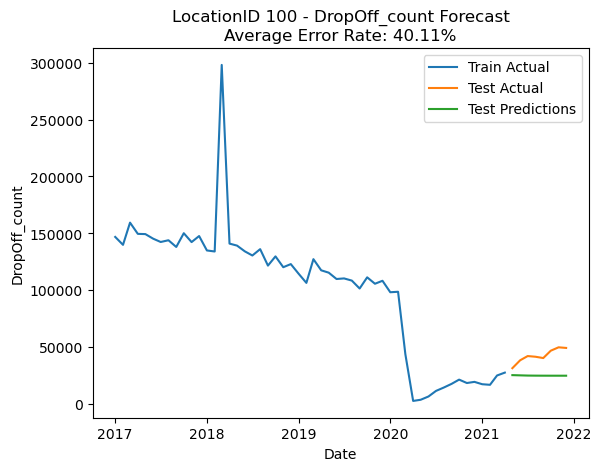

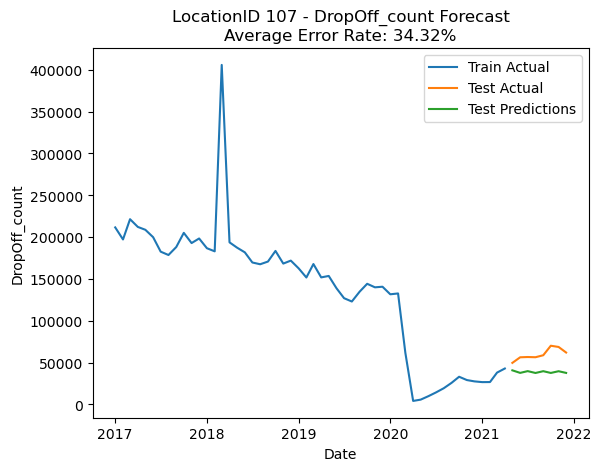

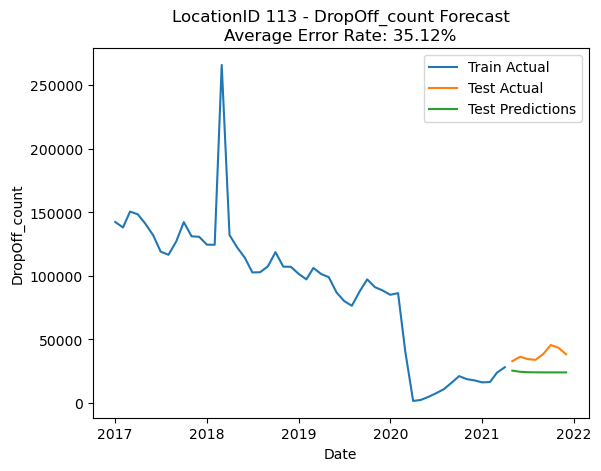

...

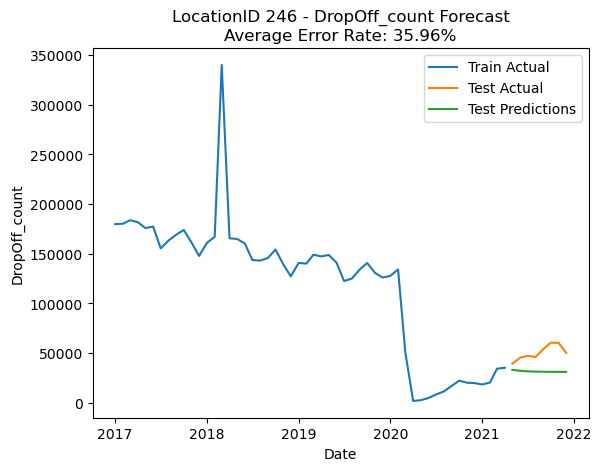

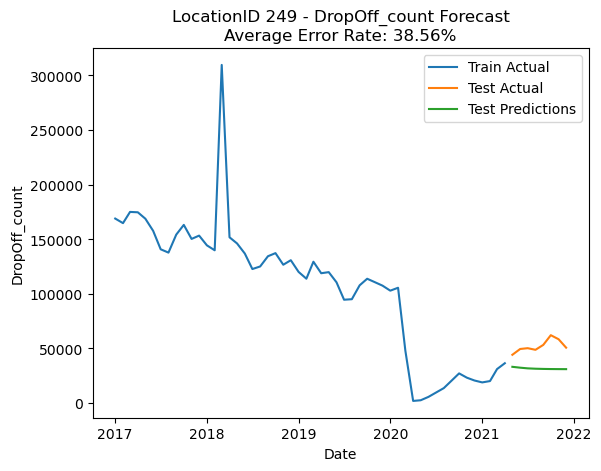

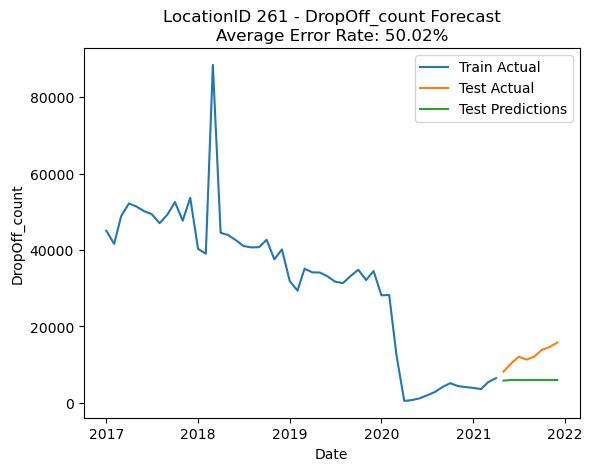

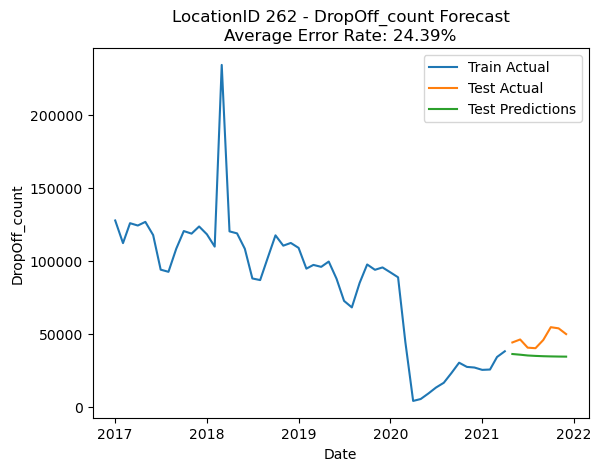

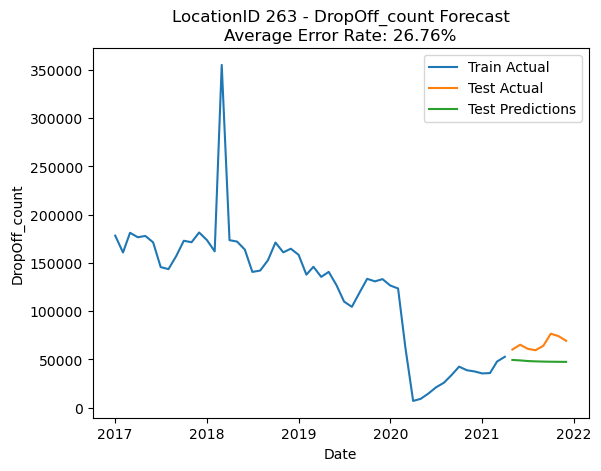

In [30]:
# Reading the csv
data = pd.read_csv('programing data/month.csv')

# Convert Date column to date time type
data['Date'] = pd.to_datetime(data['Date'])

values_to_delete = []

# Obtain a unique LocationID list
unique_location_ids = data['LocationID'].unique()

# Using the delete function from numpy to remove specific values.
updated_location_ids = np.delete(unique_location_ids, np.where(np.isin(unique_location_ids, values_to_delete)))

# Define ARIMA model parameters
order = (2, 1, 2)  # (AR order, difference order, MA order)


# Predict and plot data for each LocationID
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group = data[data['LocationID'] == location_id]

    # splitting the dataset into training and testing data
    train_size = int(len(group) * 0.88)
    train_data = group.iloc[:train_size]
    test_data = group.iloc[train_size:]

    # extracting training data and testing data
    train_DO = train_data['DropOff_count'].values
    test_DO_actual = test_data['DropOff_count'].values

    # To train an ARIMA
    model = ARIMA(train_DO, order=order)
    model_fit = model.fit()

    # To make predictions using the trained ARIMA model,
    test_predictions_DO = model_fit.predict(start=train_size, end=len(group)-1)

    # To calculate the error rate for the predictions made by the ARIMA model
    error_rate = np.abs(test_predictions_DO - test_DO_actual) / test_DO_actual
    average_error_rate = np.mean(error_rate)


    # Draw Line chart
    plt.plot(train_data['Date'], train_DO, label='Train Actual')
    plt.plot(test_data['Date'], test_DO_actual, label='Test Actual')
    plt.plot(test_data['Date'], test_predictions_DO, label='Test Predictions')
    plt.xlabel('Date')
    plt.ylabel('DropOff_count')
    plt.title(f'LocationID {location_id} - DropOff_count Forecast\nAverage Error Rate: {average_error_rate:.2%}')
    plt.legend()
    plt.show()


- Using data from July 2020 onwards for forecasting.

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


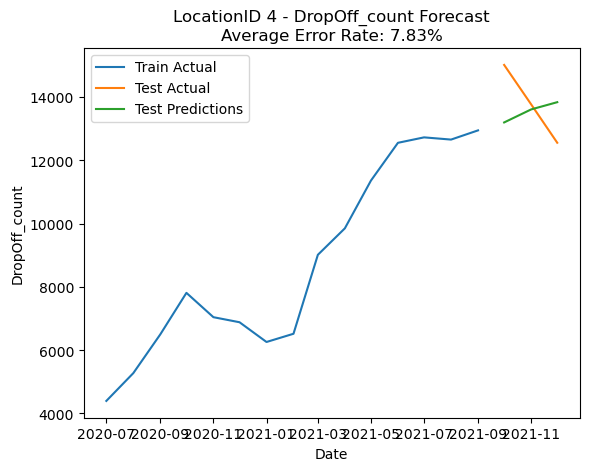

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


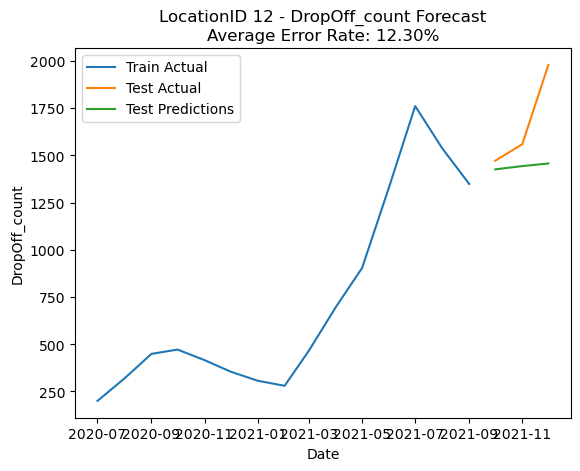

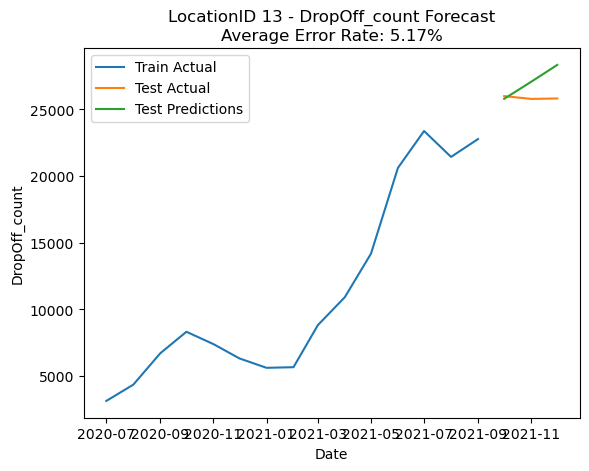

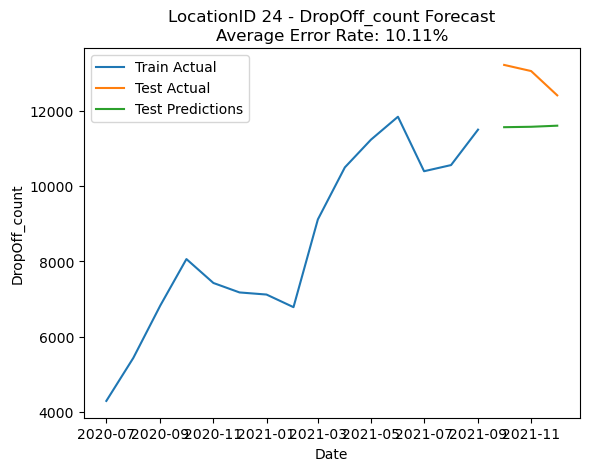

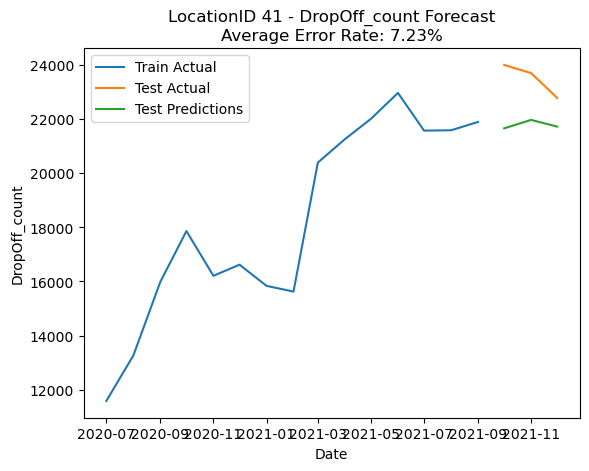

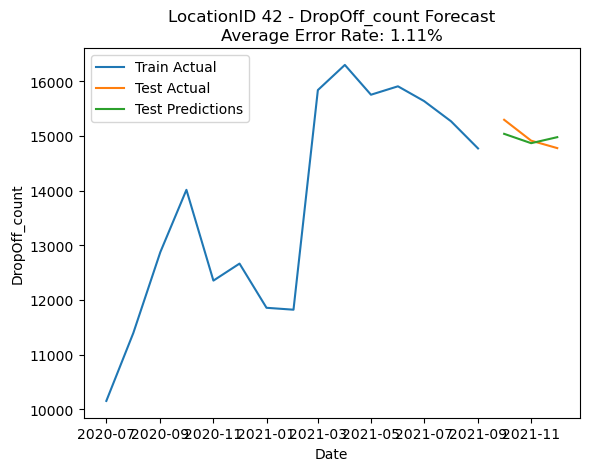

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


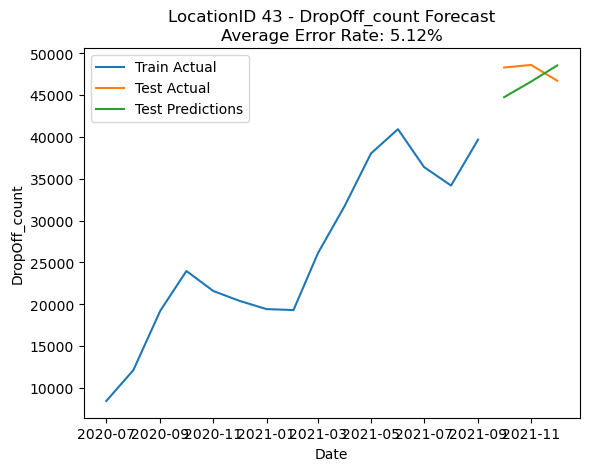

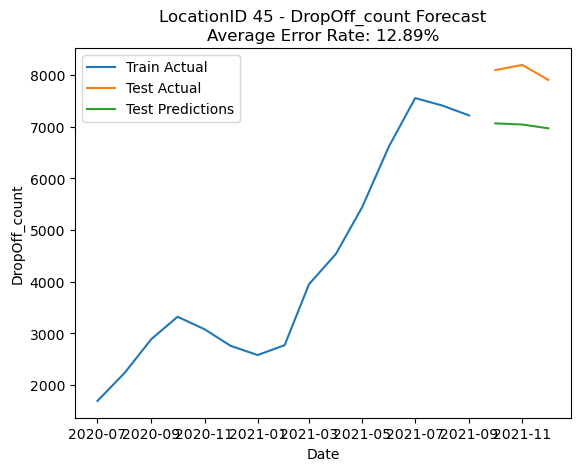

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


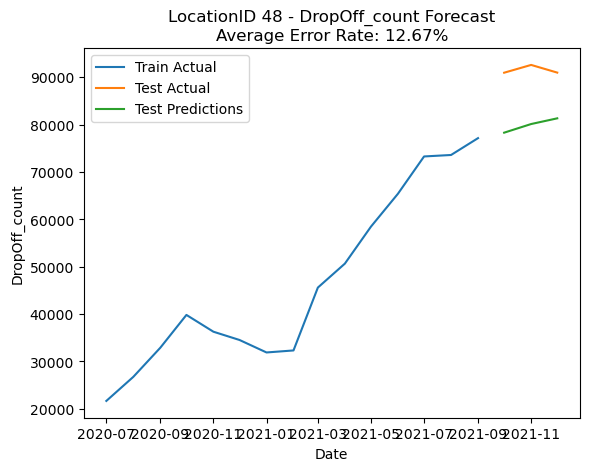

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


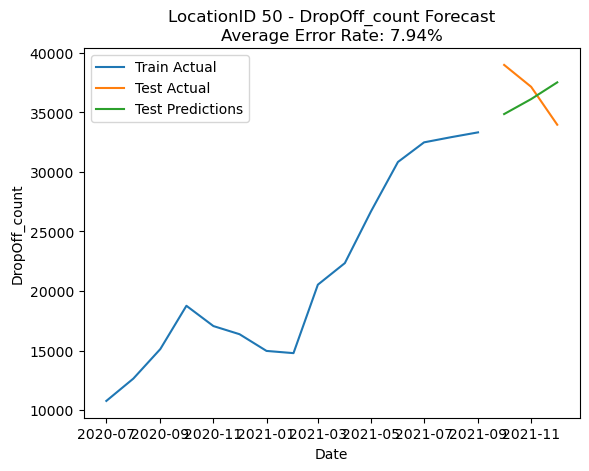

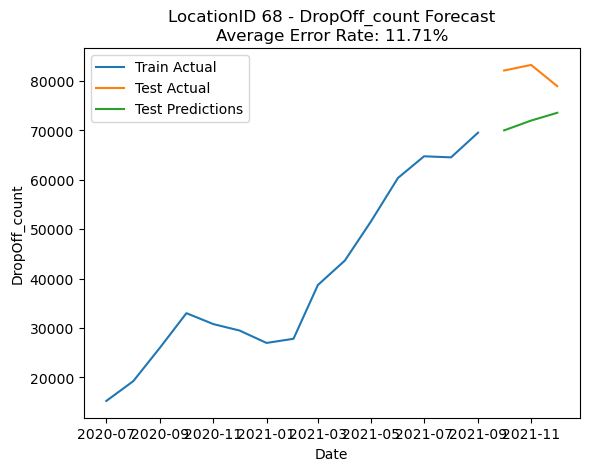

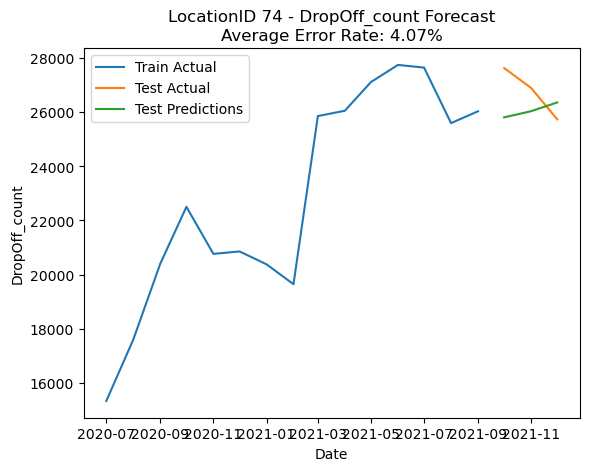

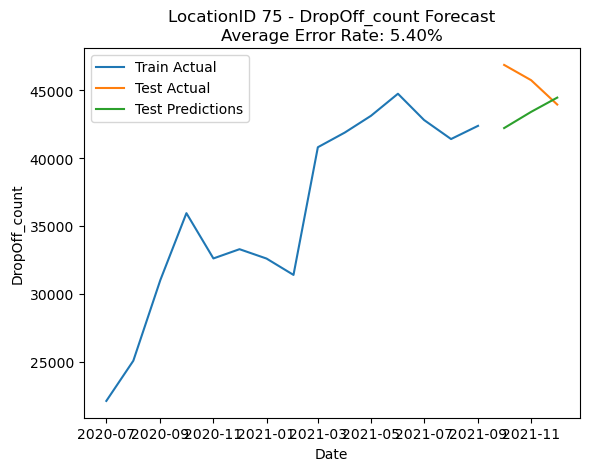

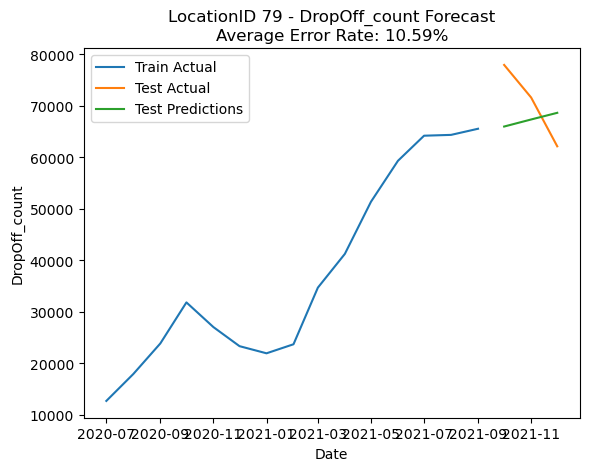

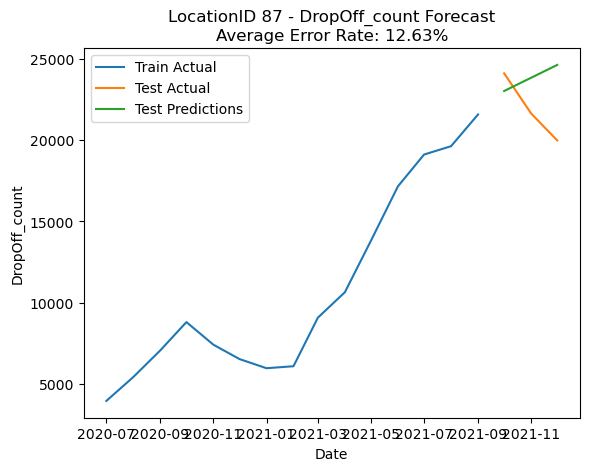

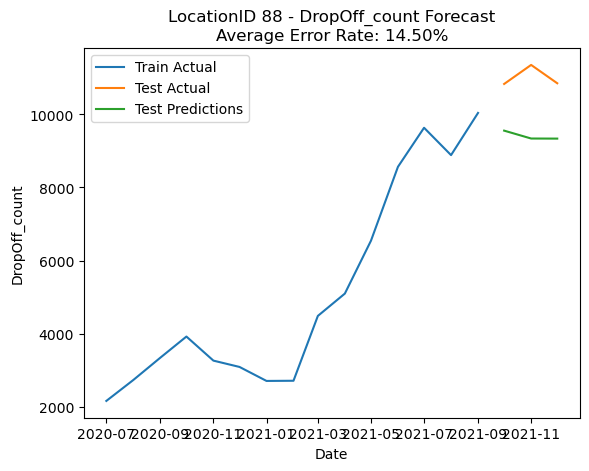

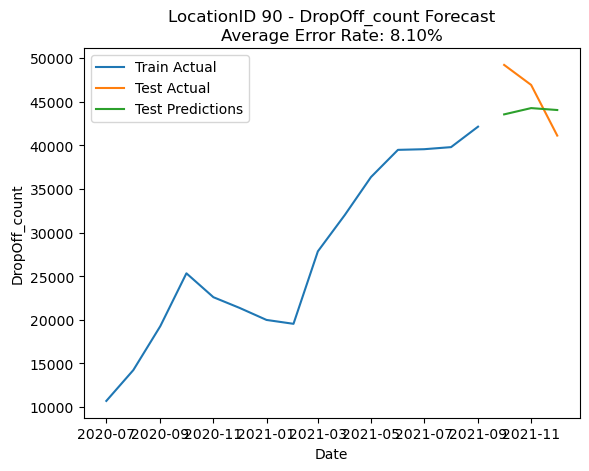

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


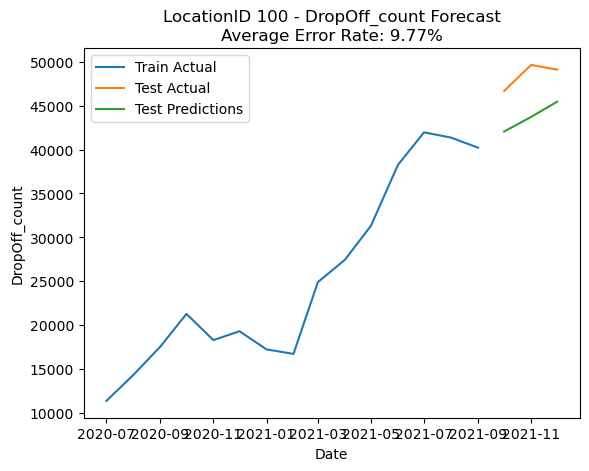

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


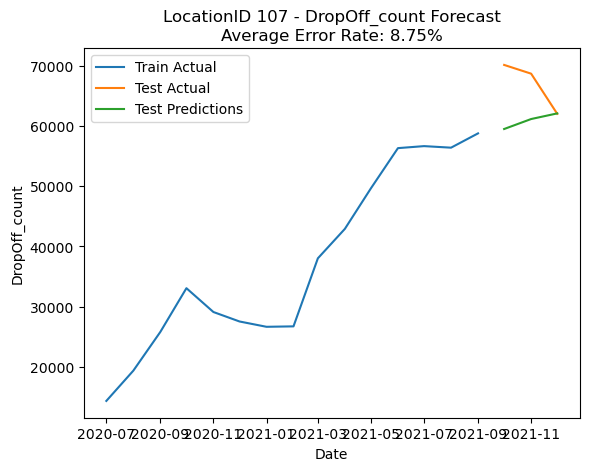

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


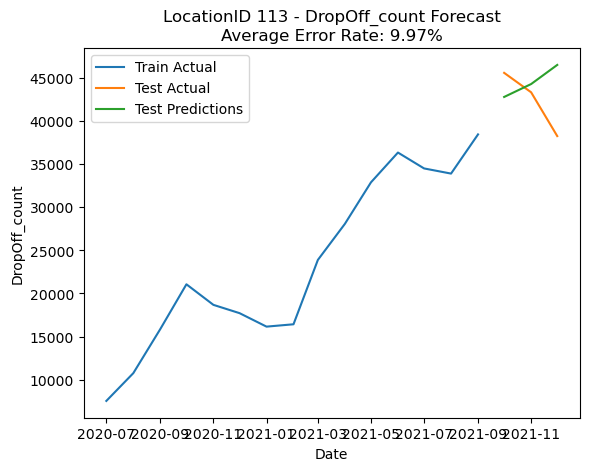

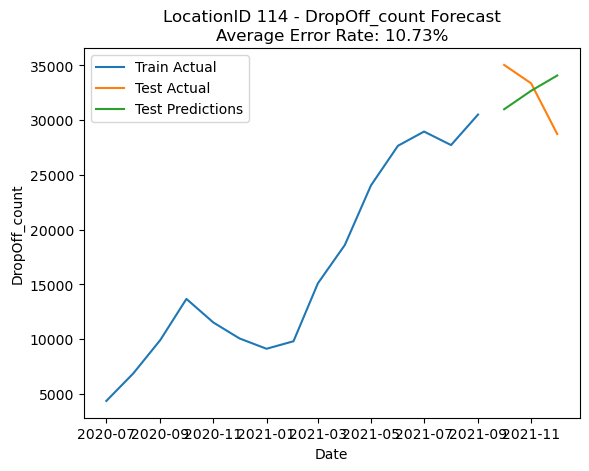

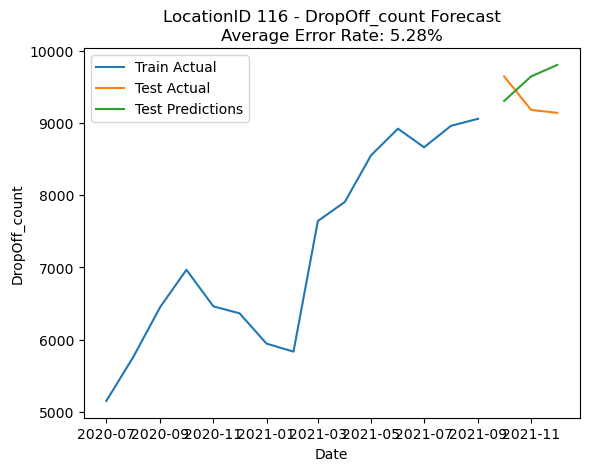

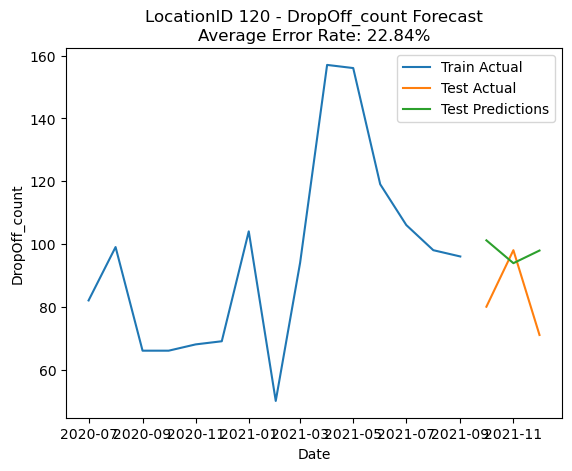

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


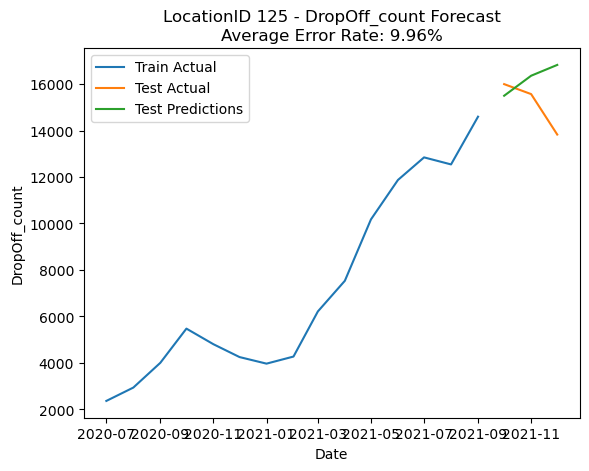

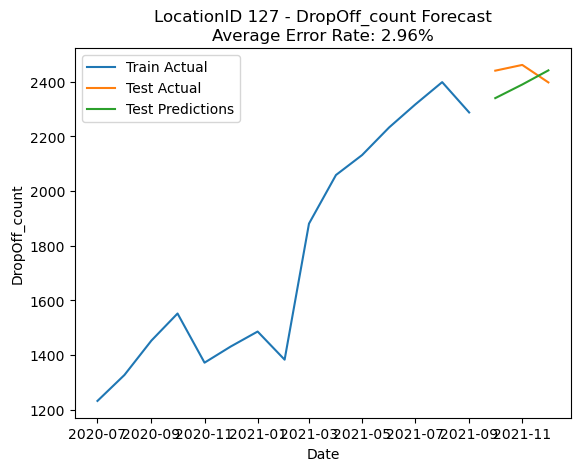

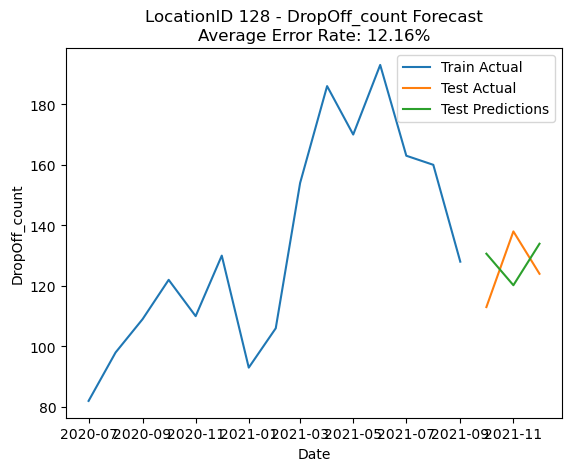

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


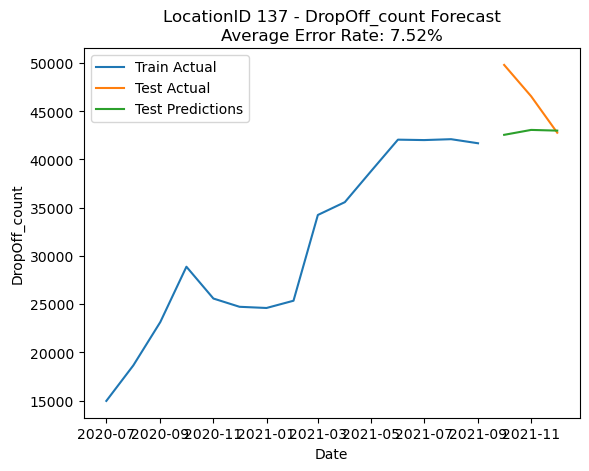

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


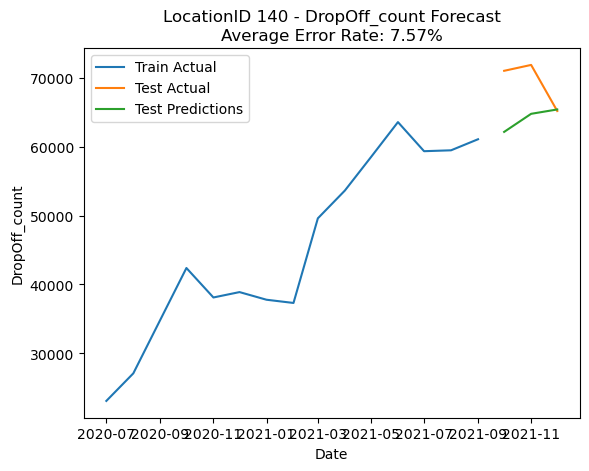

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


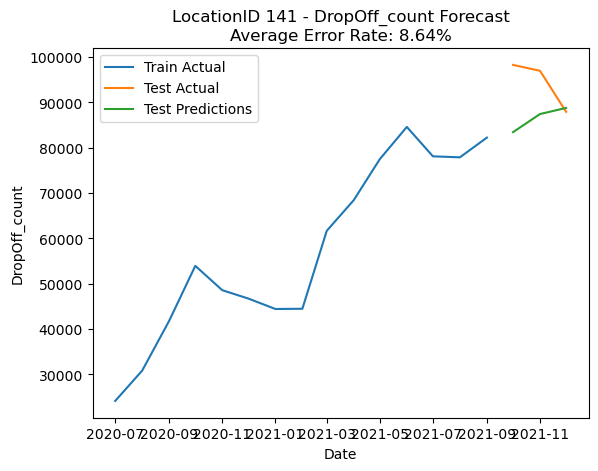

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


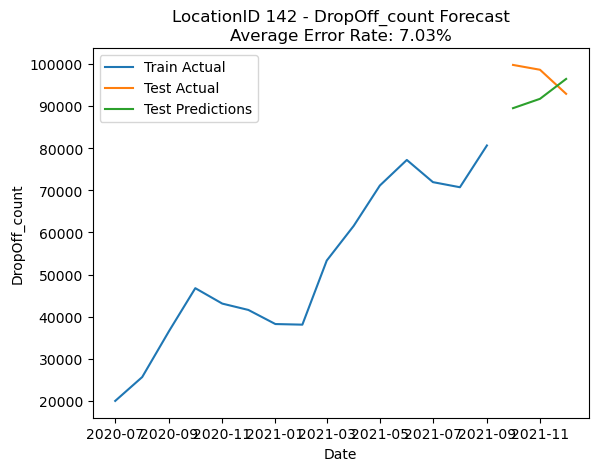

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


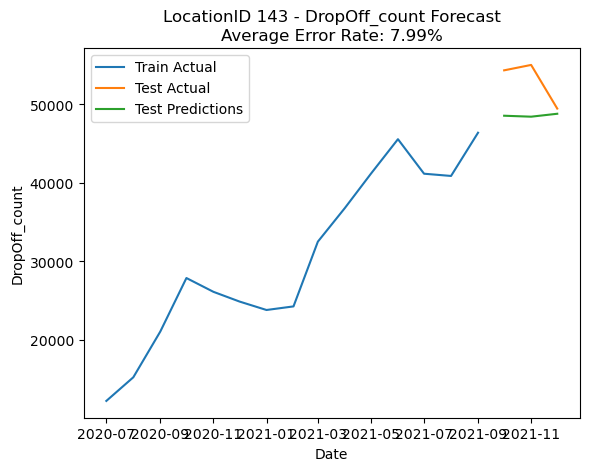

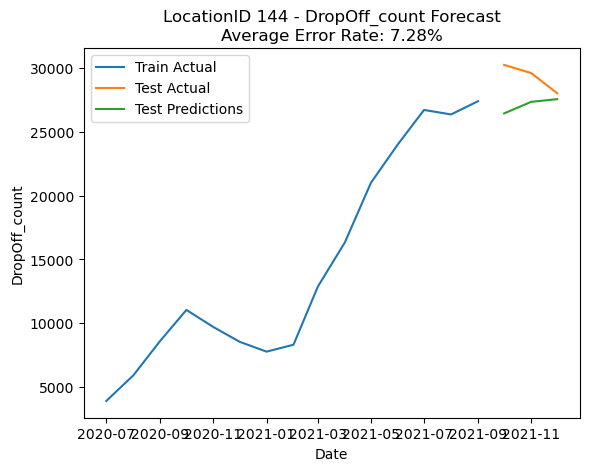

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


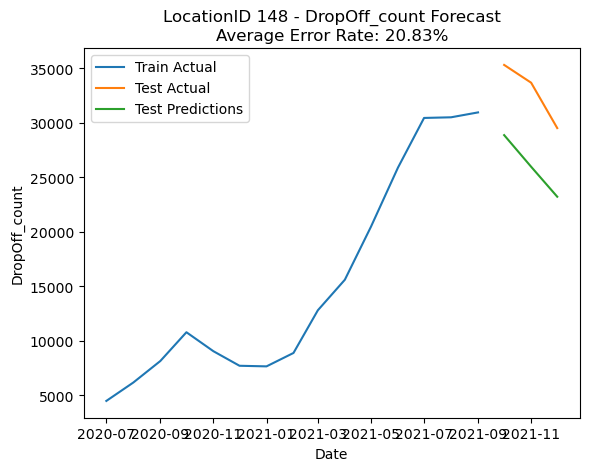

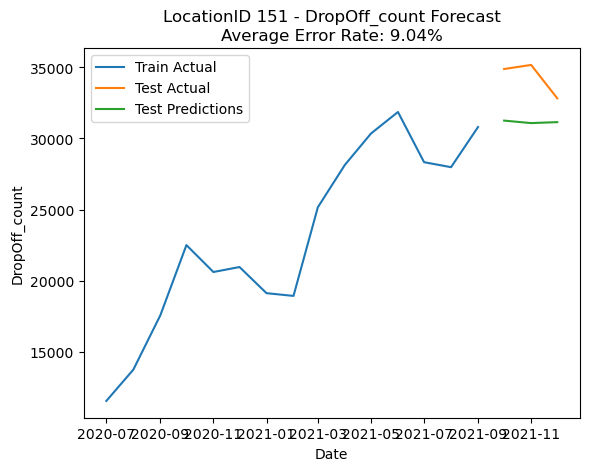

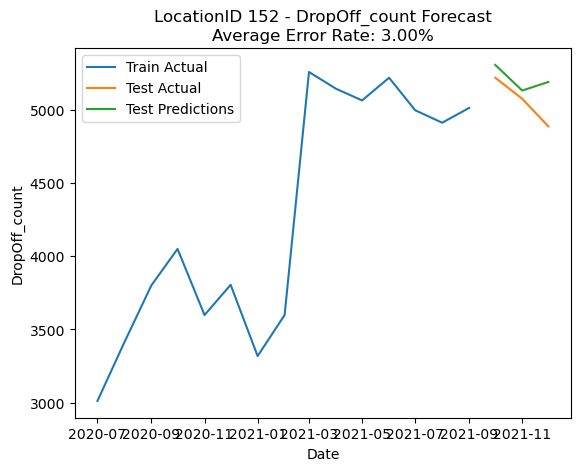

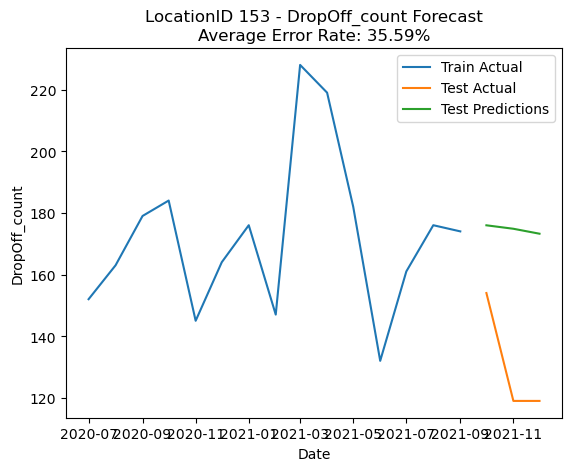

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


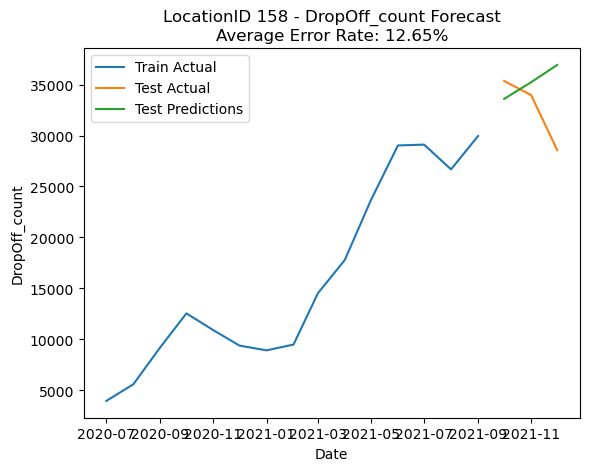

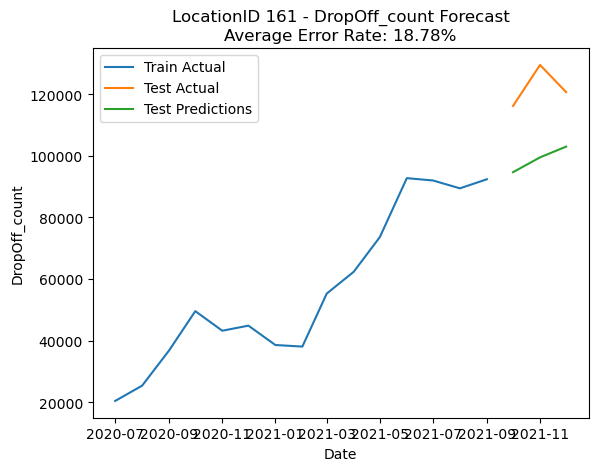

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


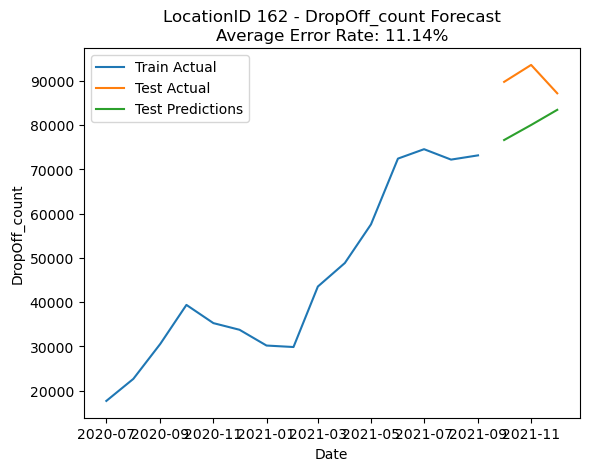

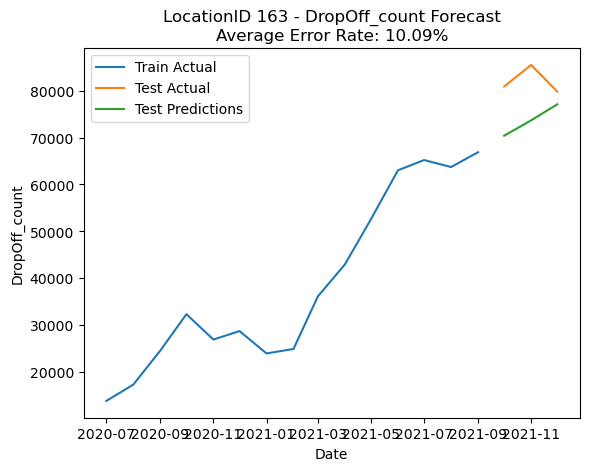

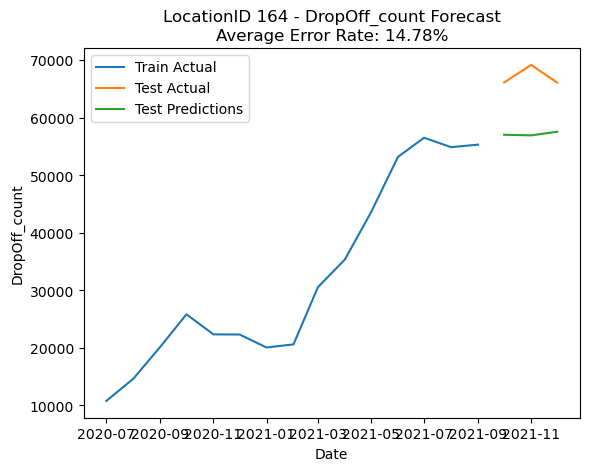

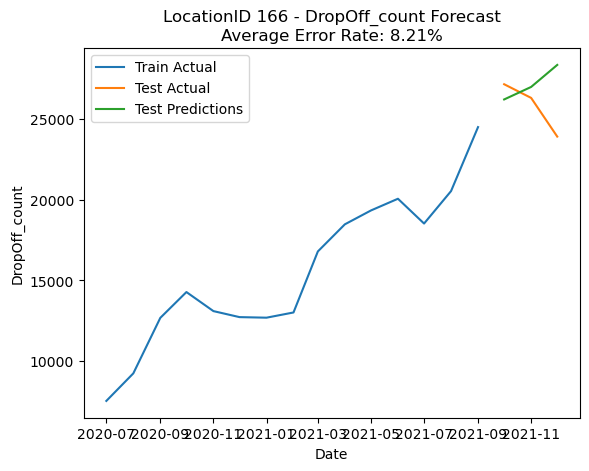

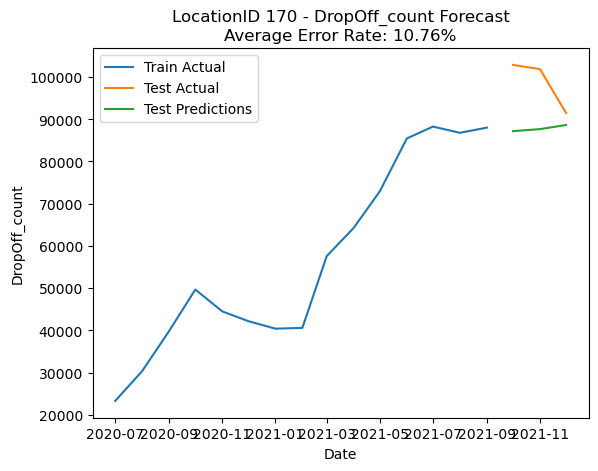

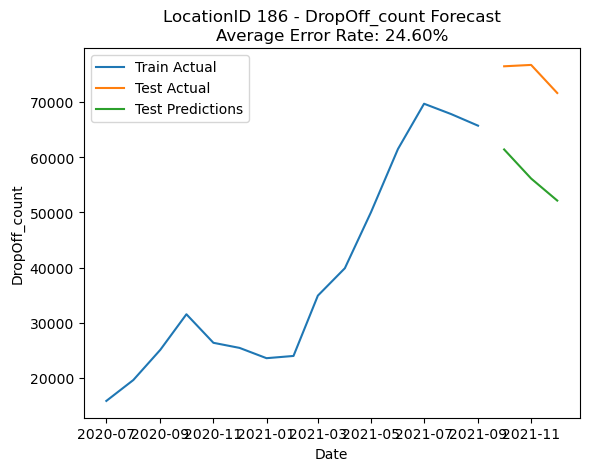

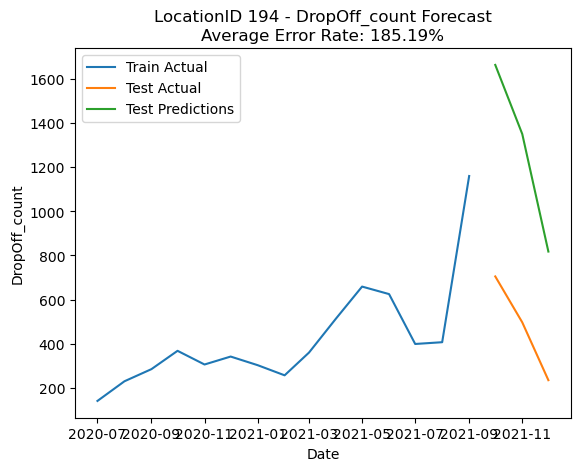

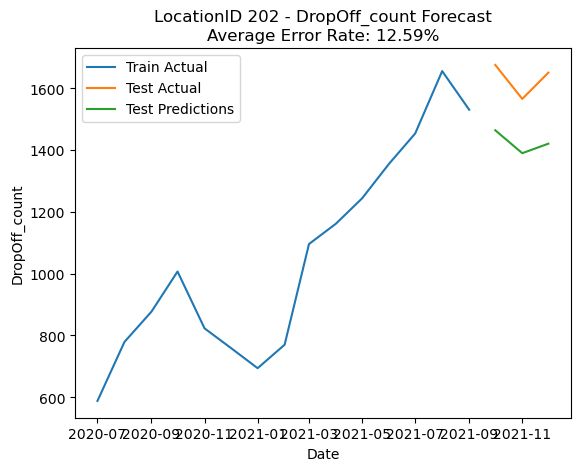

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


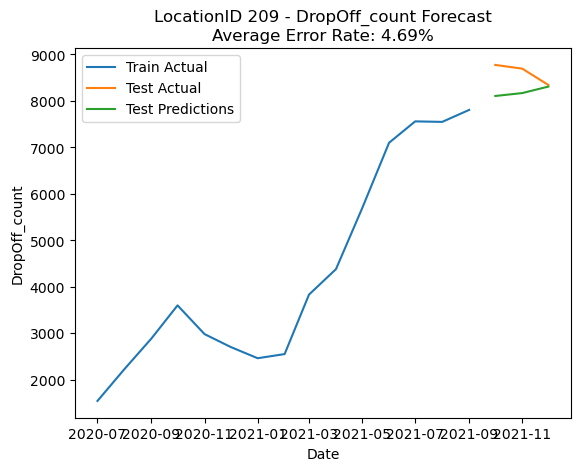

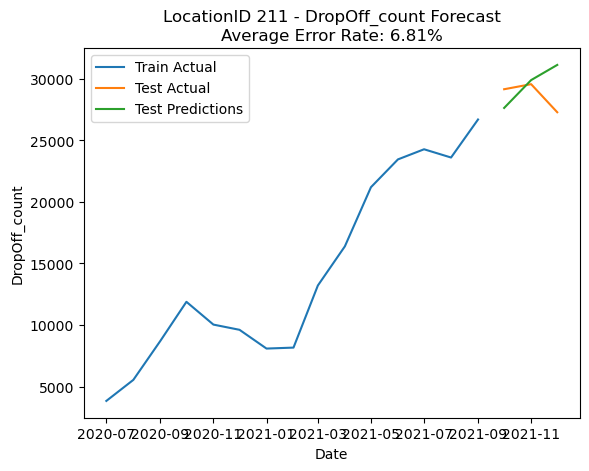

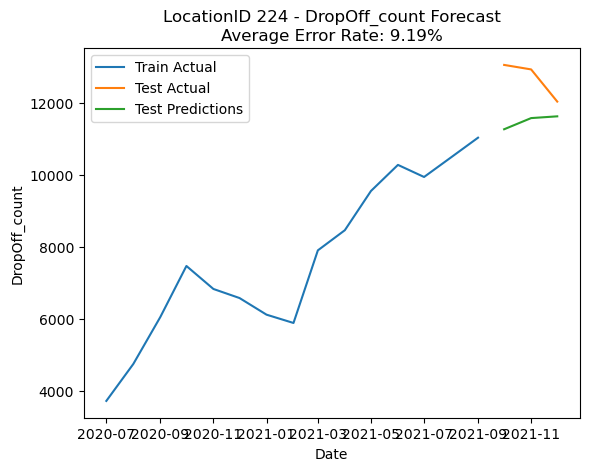

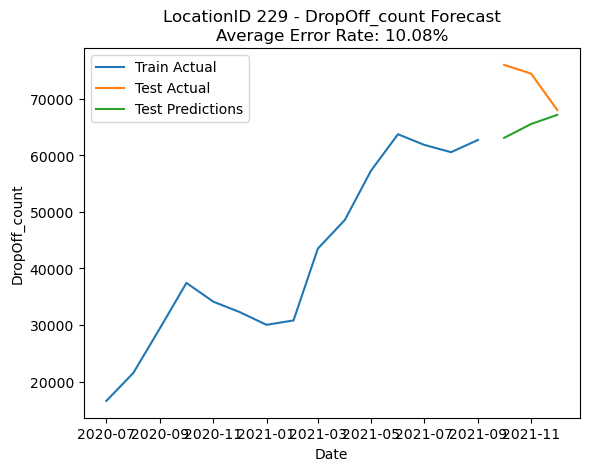

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


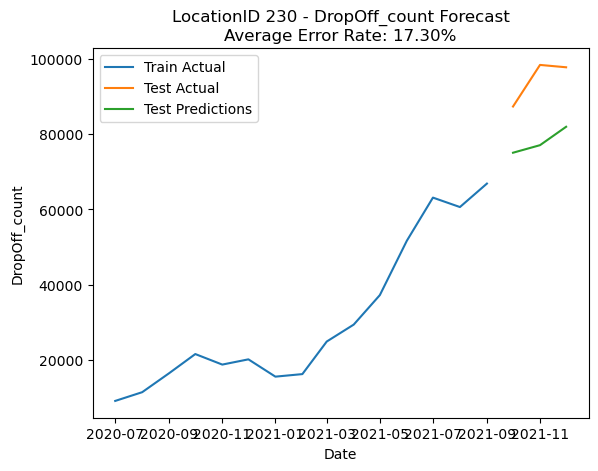

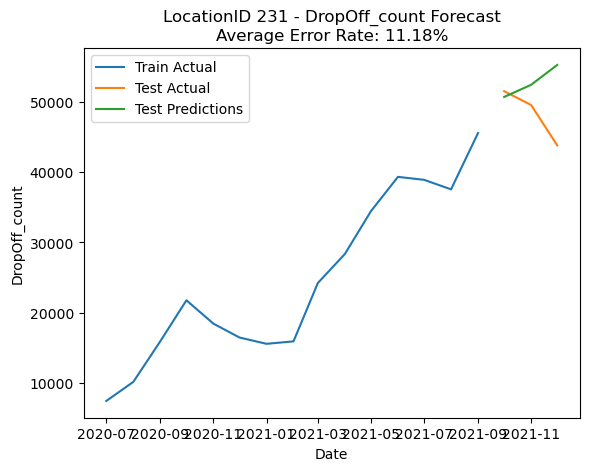

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


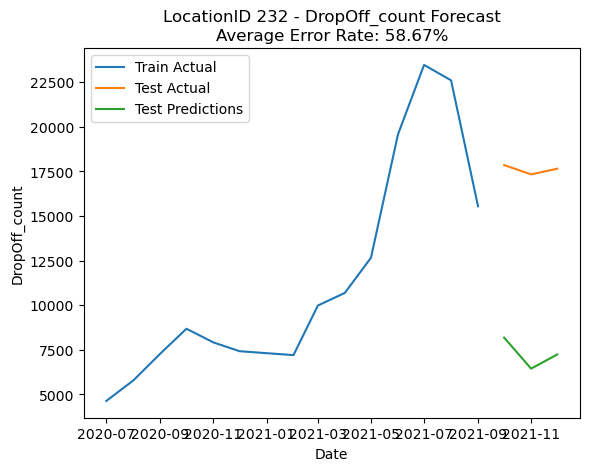

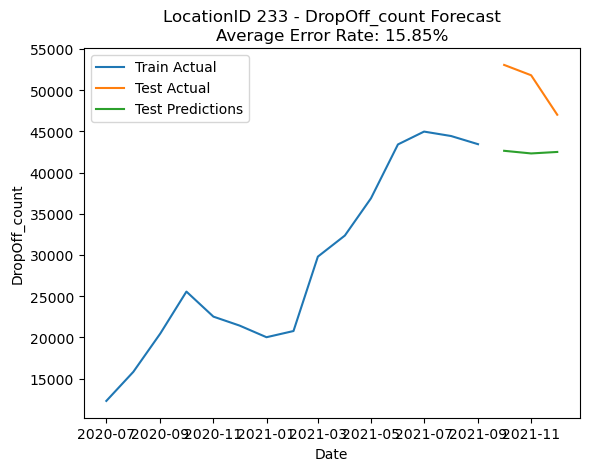

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


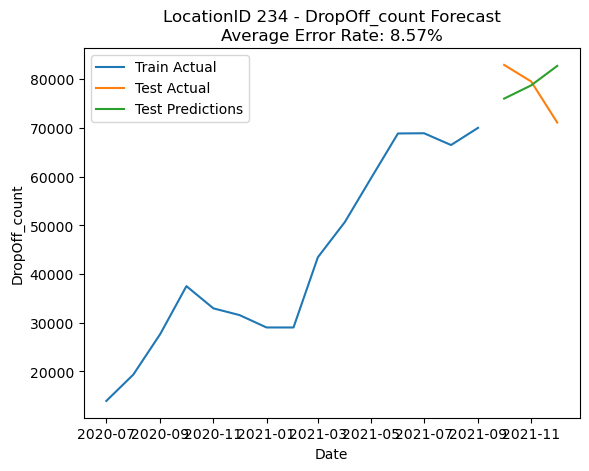

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


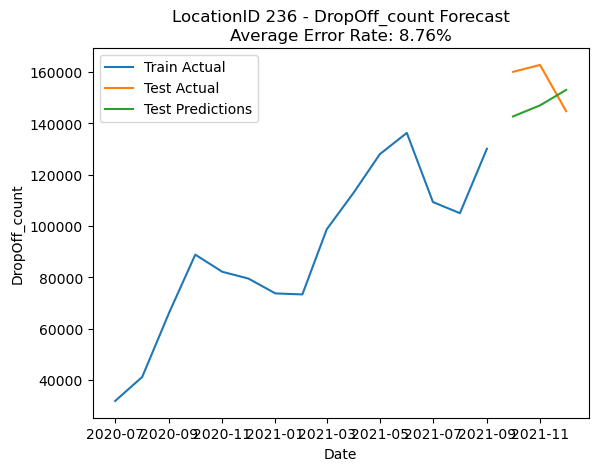

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


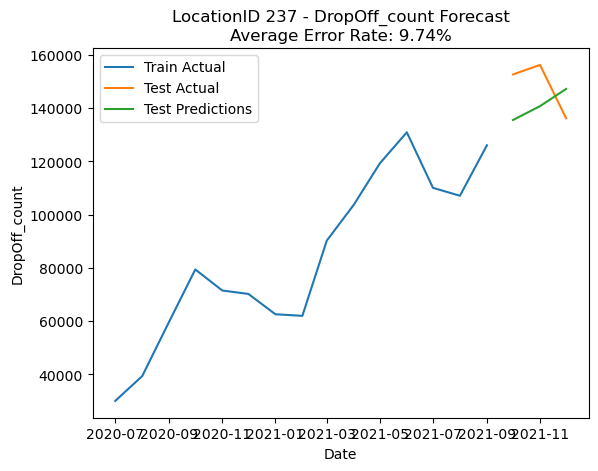

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


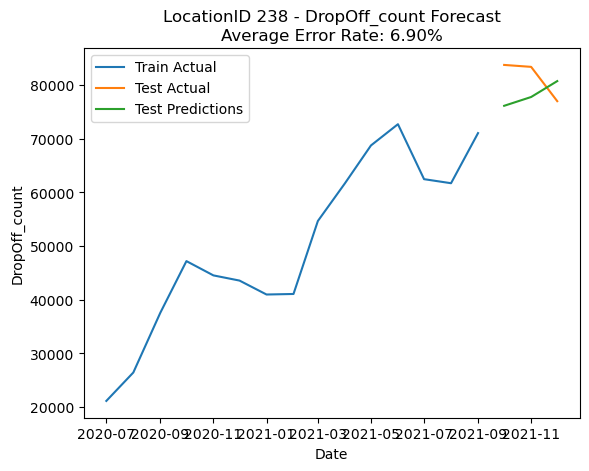

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


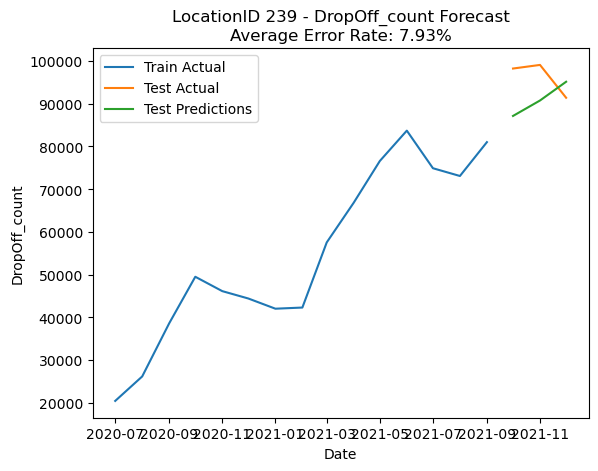

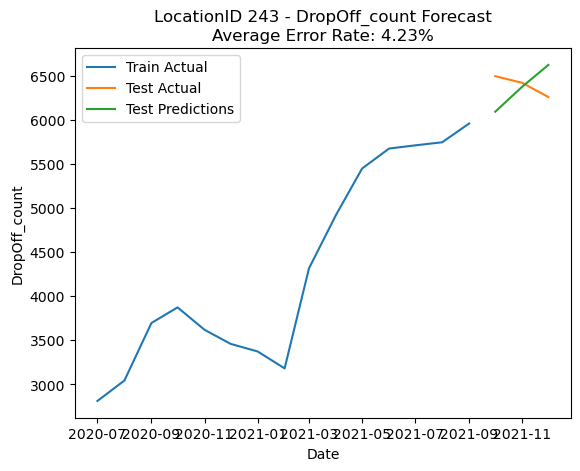

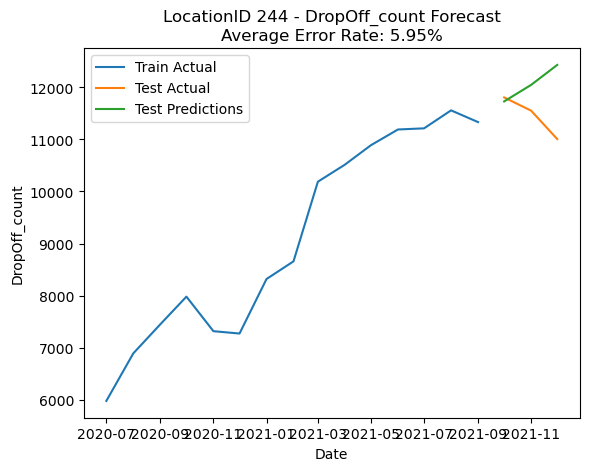

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


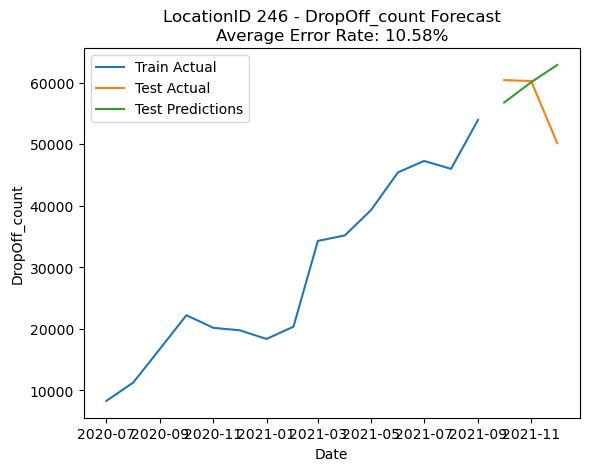

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


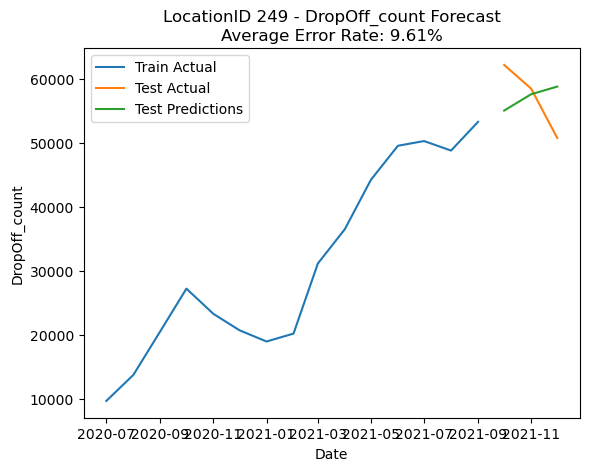

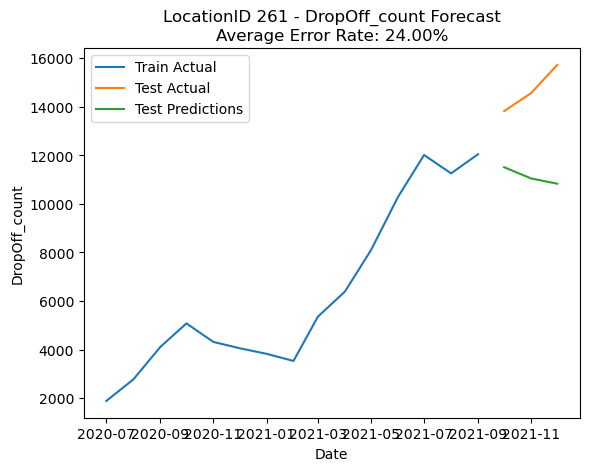

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


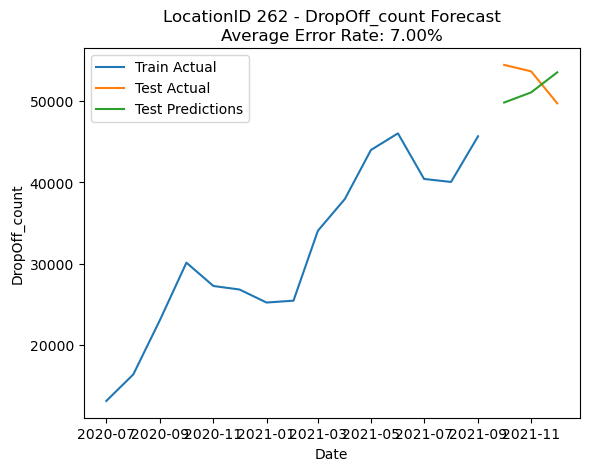

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


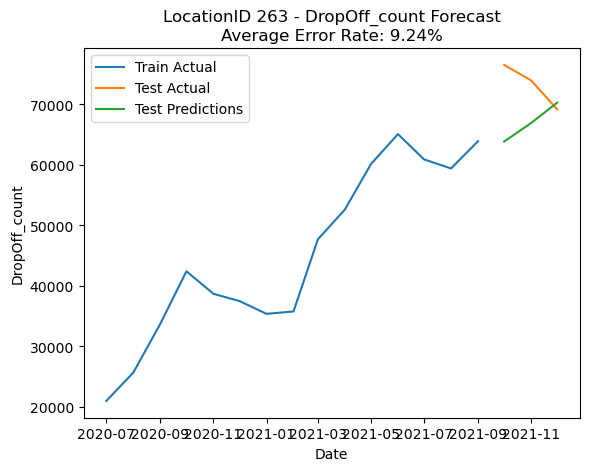

In [31]:
# Reading the csv
data = pd.read_csv('programing data/month2020.csv')

# Convert Date column to date time type
data['Date'] = pd.to_datetime(data['Date'])

values_to_delete = []

# Obtain a unique LocationID list
unique_location_ids = data['LocationID'].unique()

# Using the delete function from numpy to remove specific values.
updated_location_ids = np.delete(unique_location_ids, np.where(np.isin(unique_location_ids, values_to_delete)))

# Define ARIMA model parameters
order = (2, 1, 2)  # (AR order, difference order, MA order)


# Predict and plot data for each LocationID
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group = data[data['LocationID'] == location_id]

    # splitting the dataset into training and testing data
    train_size = int(len(group) * 0.88)
    train_data = group.iloc[:train_size]
    test_data = group.iloc[train_size:]

    # extracting training data and testing data
    train_DO = train_data['DropOff_count'].values
    test_DO_actual = test_data['DropOff_count'].values

    # To train an ARIMA
    model = ARIMA(train_DO, order=order)
    model_fit = model.fit()

    # To make predictions using the trained ARIMA model,
    test_predictions_DO = model_fit.predict(start=train_size, end=len(group)-1)

    # To calculate the error rate for the predictions made by the ARIMA model
    error_rate = np.abs(test_predictions_DO - test_DO_actual) / test_DO_actual
    average_error_rate = np.mean(error_rate)


    # Draw Line chart
    plt.plot(train_data['Date'], train_DO, label='Train Actual')
    plt.plot(test_data['Date'], test_DO_actual, label='Test Actual')
    plt.plot(test_data['Date'], test_predictions_DO, label='Test Predictions')
    plt.xlabel('Date')
    plt.ylabel('DropOff_count')
    plt.title(f'LocationID {location_id} - DropOff_count Forecast\nAverage Error Rate: {average_error_rate:.2%}')
    plt.legend()
    plt.show()


- As we can observe significant fluctuations in the data due to the impact of the COVID-19 pandemic, it has led to high forecasting errors. To improve accuracy, it is recommended to use post-pandemic data for forecasting.

###### Random Forest model
    - DropOff_count

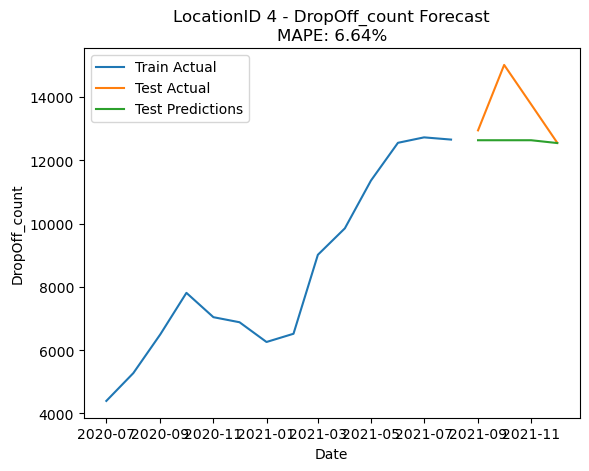

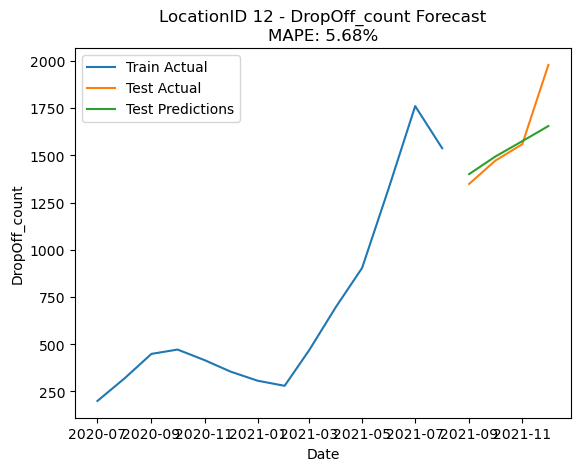

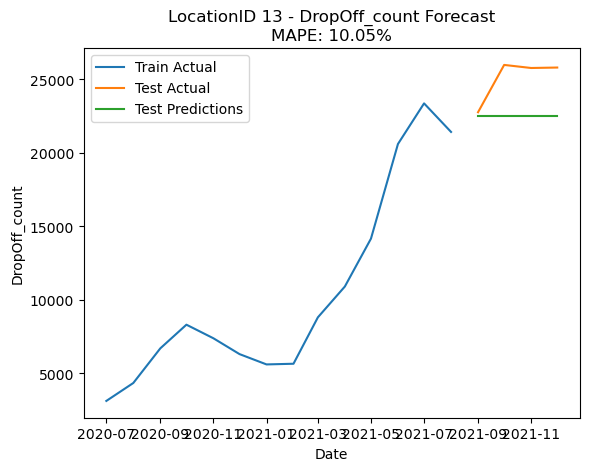

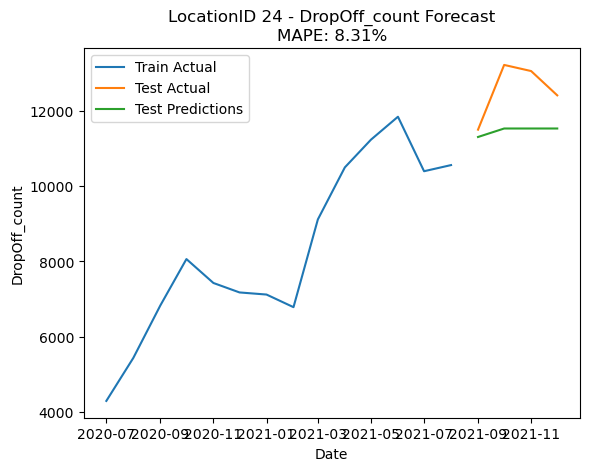

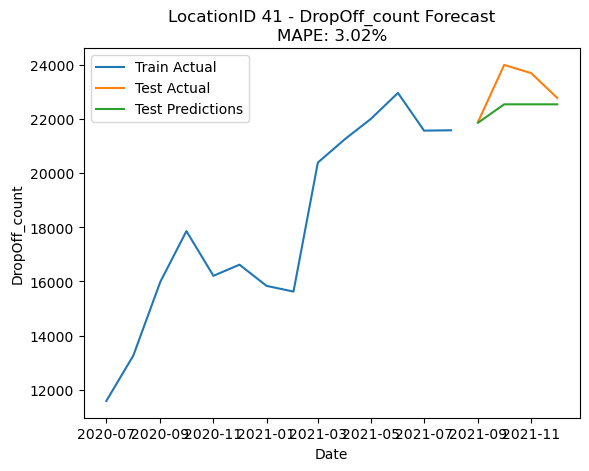

...

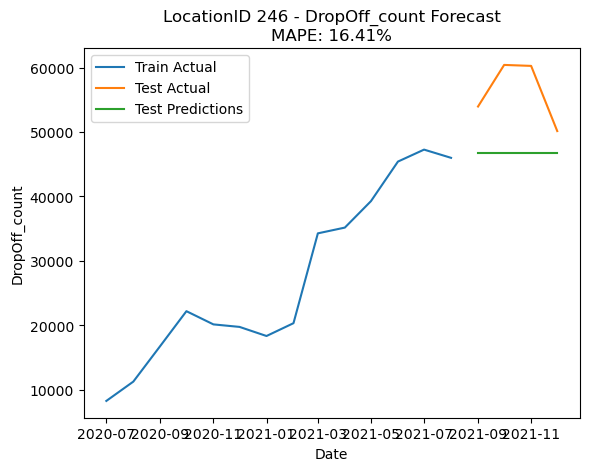

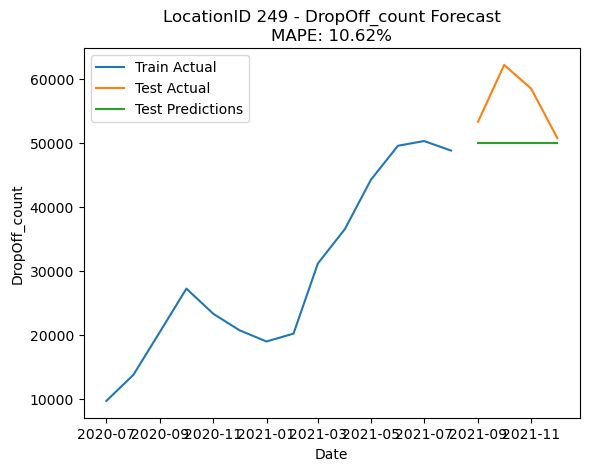

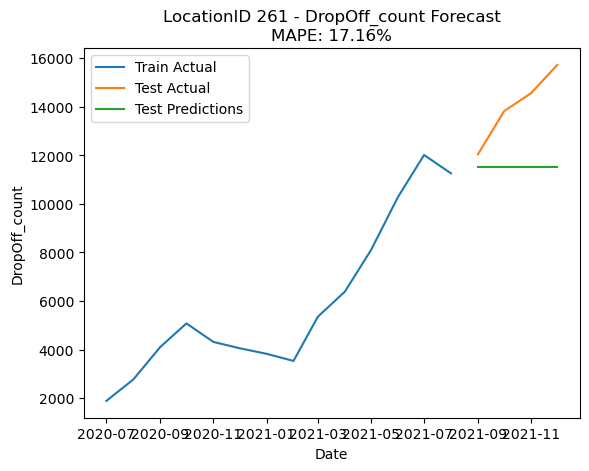

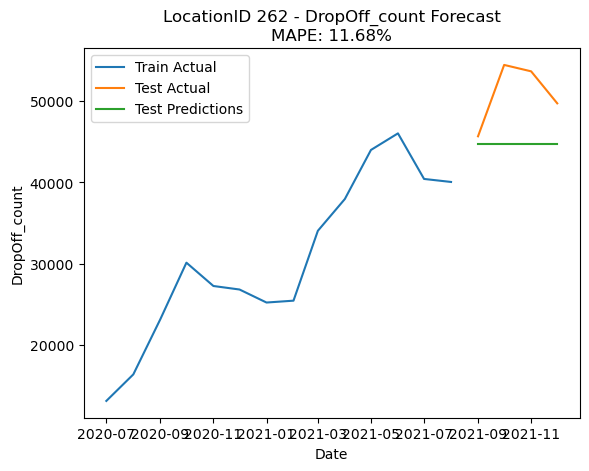

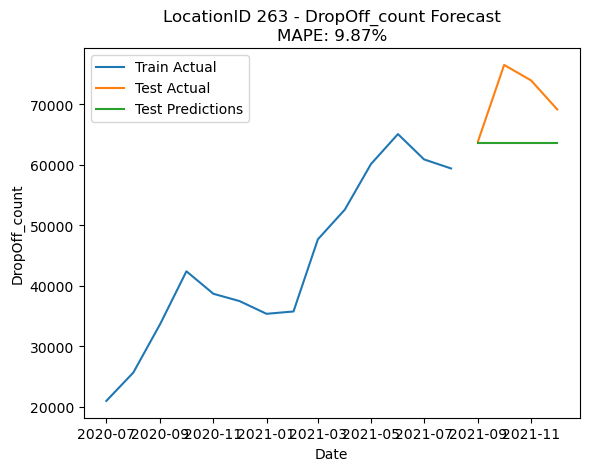

In [32]:
# Reading the csv
data = pd.read_csv('programing data/month2020.csv')

# Convert Date column to date time type
data['Date'] = pd.to_datetime(data['Date'])

# Obtain a unique LocationID list
unique_location_ids = data['LocationID'].unique()

# Define parameters of Random forest model
n_estimators = 100  # Number of decision trees
max_features = 'auto'  # Automatic selection of feature quantity

# Predict and plot data for each LocationID
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group = data[data['LocationID'] == location_id]

    # splitting the dataset into training and testing data
    train_size = int(len(group) * 0.8)
    train_data = group.iloc[:train_size]
    test_data = group.iloc[train_size:]

    # extracting training data and testing data
    train_features = train_data[['DropOff_count']].values
    train_target = train_data['DropOff_count'].values
    test_features = test_data[['DropOff_count']].values
    test_target_actual = test_data['DropOff_count'].values

    # To make predictions using the trained Random Forest model,
    model = RandomForestRegressor(n_estimators=n_estimators, max_features=max_features)
    model.fit(train_features, train_target)

    # To make predictions using the trained Random Forest model,
    test_target_predicted = model.predict(test_features)

    # To calculate the error rate for the predictions made by the Random Forest model
    mape = mean_absolute_percentage_error(test_target_actual, test_target_predicted)

    # Draw Line chart
    plt.plot(train_data['Date'], train_target, label='Train Actual')
    plt.plot(test_data['Date'], test_target_actual, label='Test Actual')
    plt.plot(test_data['Date'], test_target_predicted, label='Test Predictions')
    plt.xlabel('Date')
    plt.ylabel('DropOff_count')
    plt.title(f'LocationID {location_id} - DropOff_count Forecast\nMAPE: {mape:.2%}')
    plt.legend()
    plt.show()


Based on the results and requirements, to directly forecast future values of time series data, an ARIMA model will be used for modeling.

#### Model training and  encapsulation 

In [33]:
# Reading the csv
data = pd.read_csv('programing data/month2020.csv')

# Convert Date column to date time type
data['Date'] = pd.to_datetime(data['Date'])

values_to_delete = []

# Obtain a unique LocationID list
unique_location_ids = data['LocationID'].unique()

# Using the delete function from numpy to remove specific values.
updated_location_ids = np.delete(unique_location_ids, np.where(np.isin(unique_location_ids, values_to_delete)))

# Define ARIMA model parameters
order = (2, 1, 2)  # (AR order, difference order, MA order)

# To create an empty model dictionary.
models_dict = {}

# Predict and plot data for each LocationID
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group = data[data['LocationID'] == location_id]

    # extracting training data and testing data
    train_DO = group['DropOff_count'].values

    # To train an ARIMA
    model = ARIMA(train_DO, order=order)
    model_fit = model.fit()
    
    # Save the models to the dictionary.
    models_dict[location_id] = model_fit



/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/

- After inspection, the warning here is due to insufficient data for some regions. However, based on the previous results, using 5 years of data for prediction resulted in a large error rate. Therefore, we can only use the currently available partial data for prediction

In [34]:
with open('models_DO.pkl', 'wb') as file:
    pickle.dump(models_dict, file)

#### Establishing a predictive ARIMA model for "Pick_Up" follows the same procedure as described above. The code will not be repeated here.







###### ARIMA 
    - passenger_count

In [35]:
# Reading the csv
data = pd.read_csv('programing data/month2020.csv')

- Due to both boarding and alighting passengers staying in the same region, it is decided to predict the total number of Pick UP and Drop OFF passengers.

In [36]:
data["passenger"] = data["PU_passenger"] + data["DO_passenger"]

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


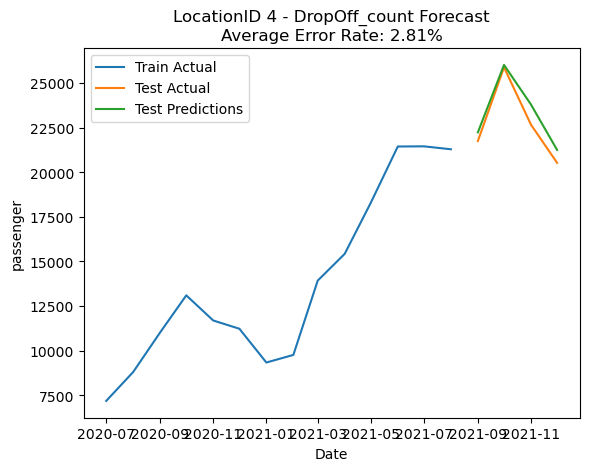

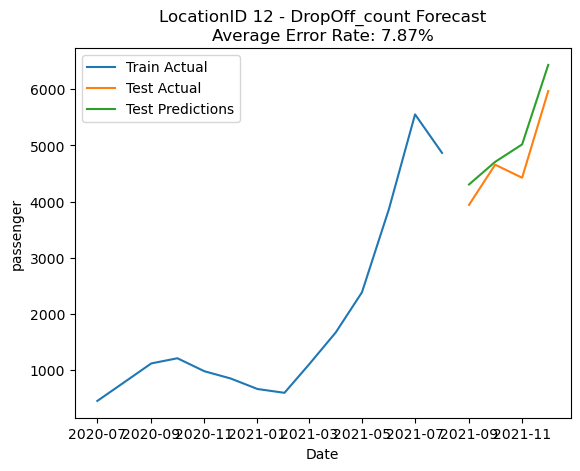

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


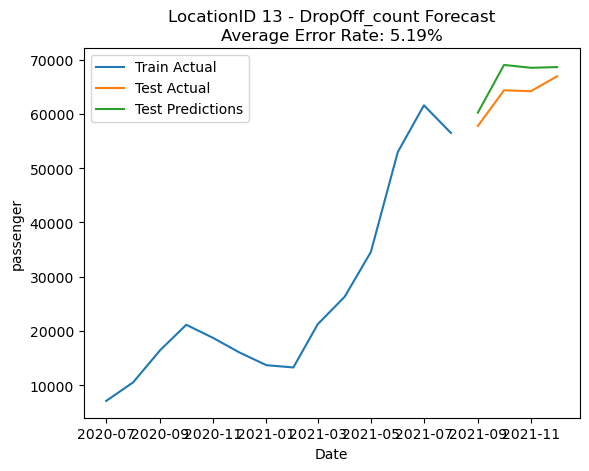

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


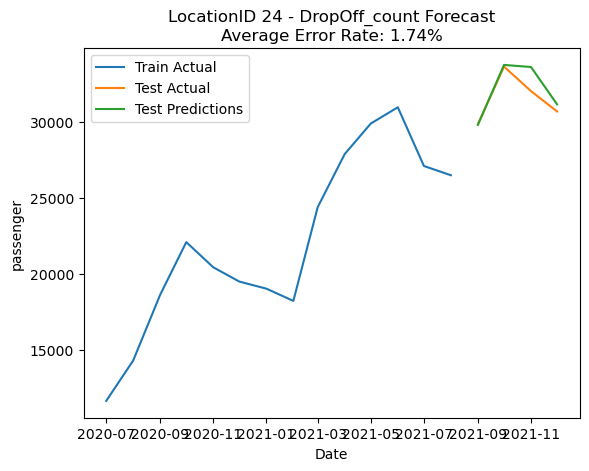

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


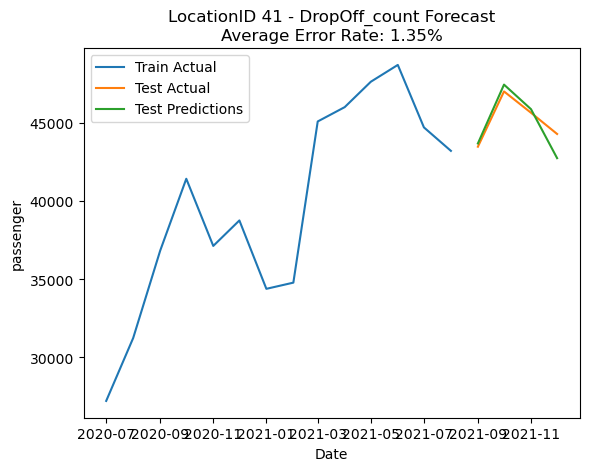

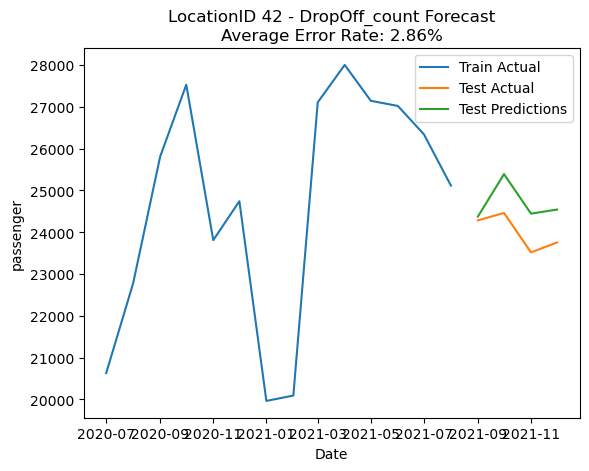

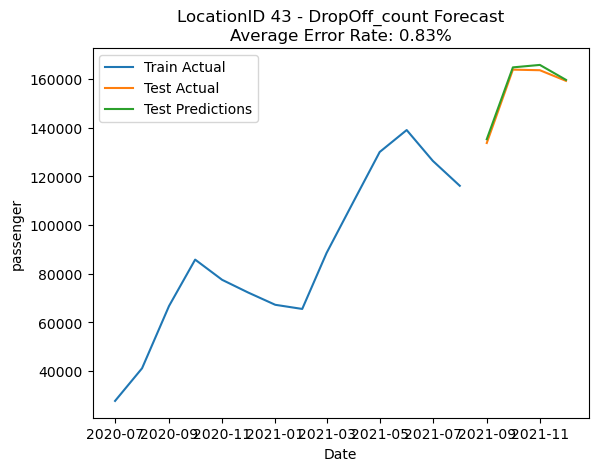

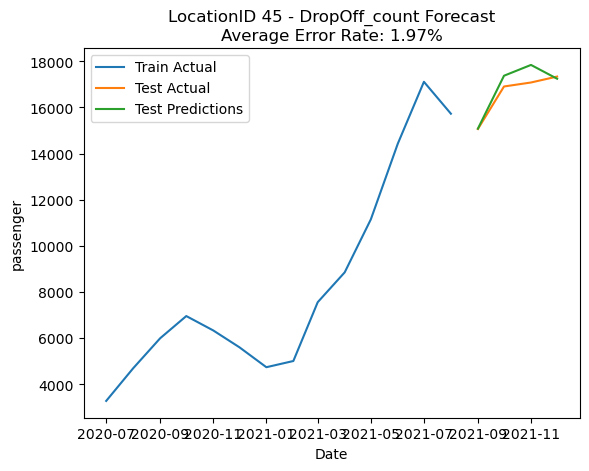

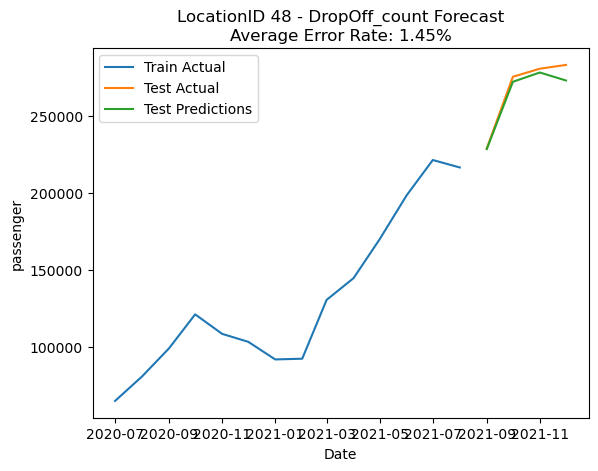

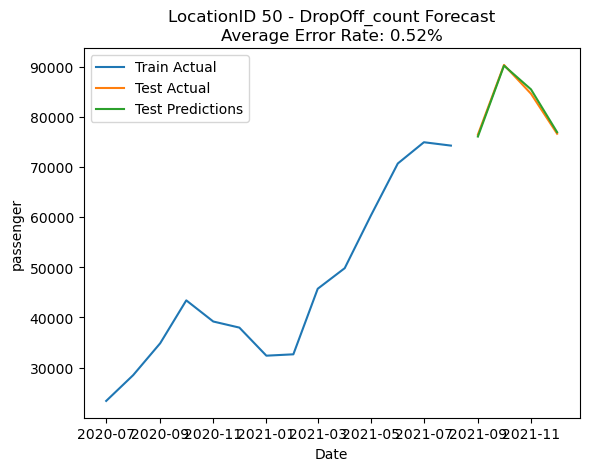

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


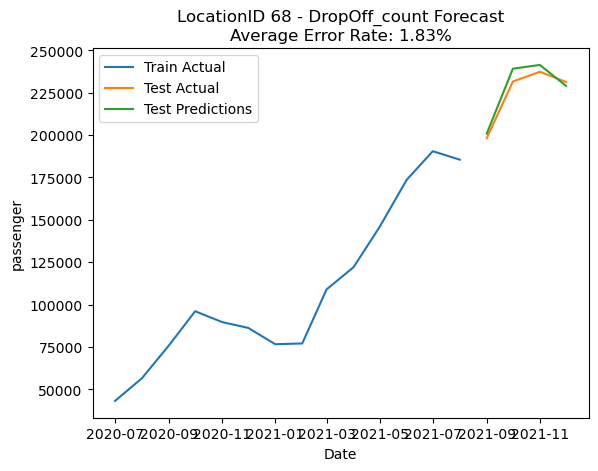

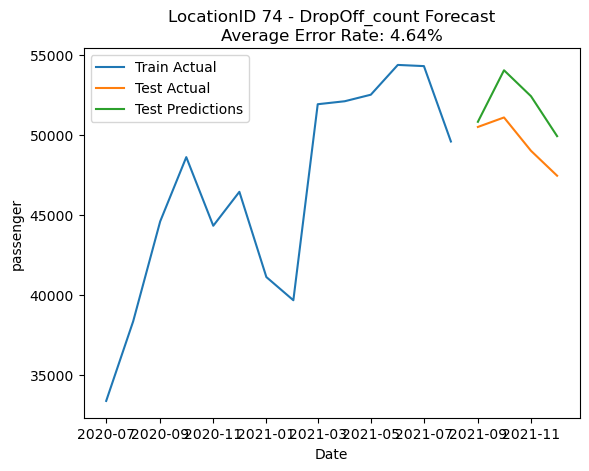

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


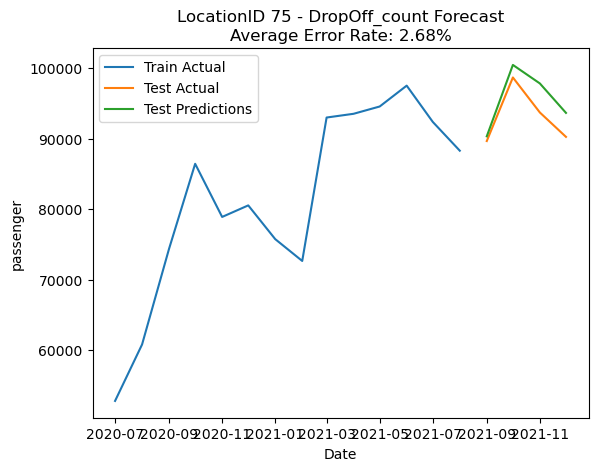

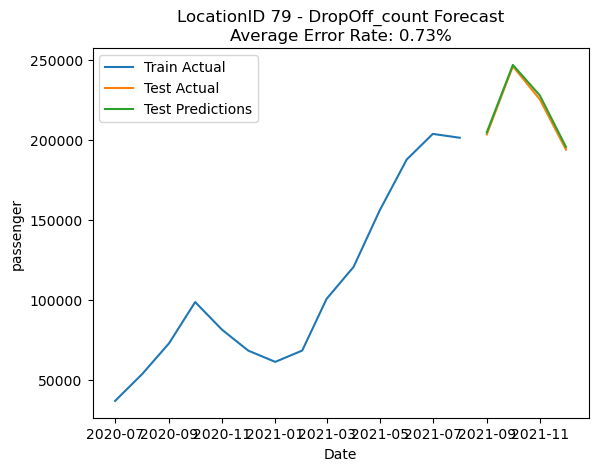

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


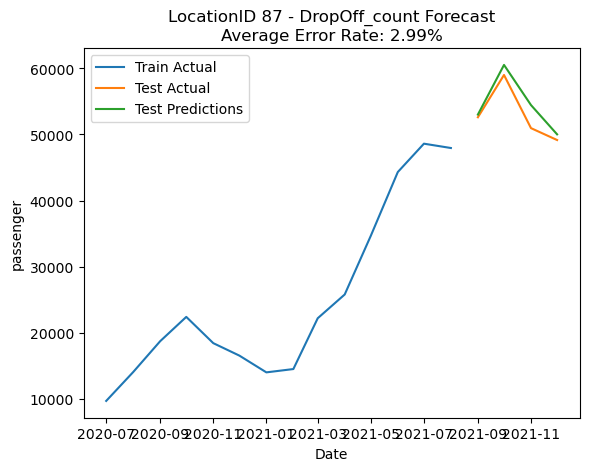

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


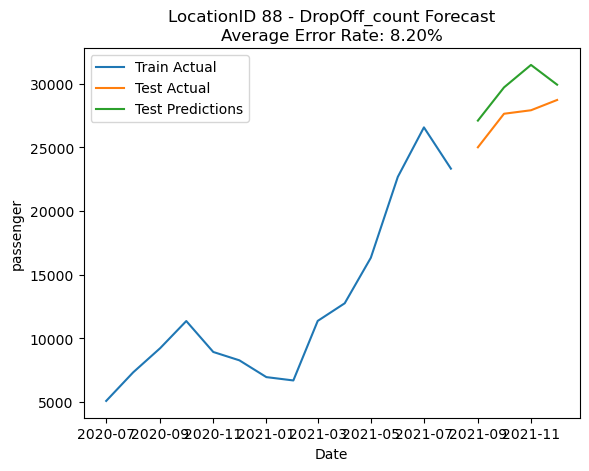

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


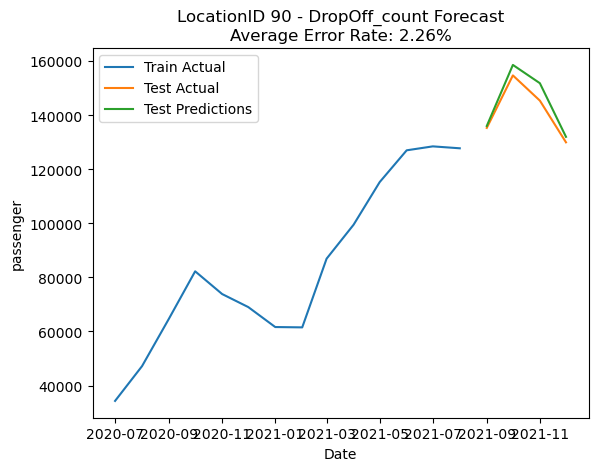

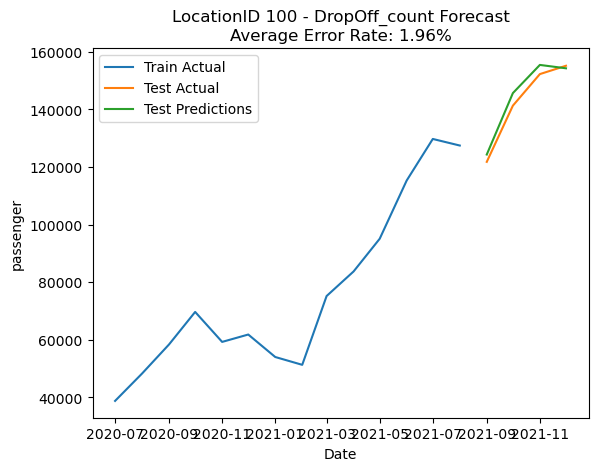

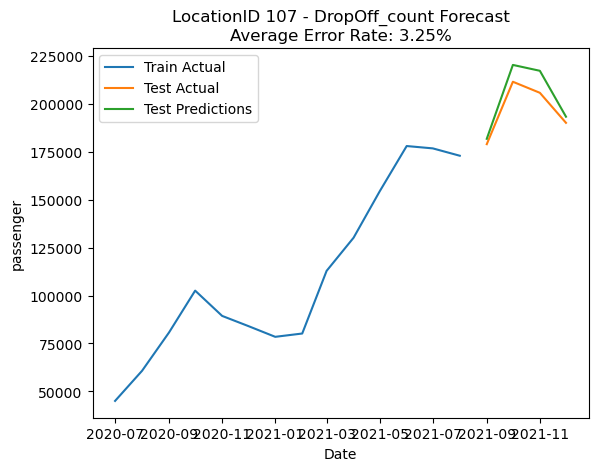

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


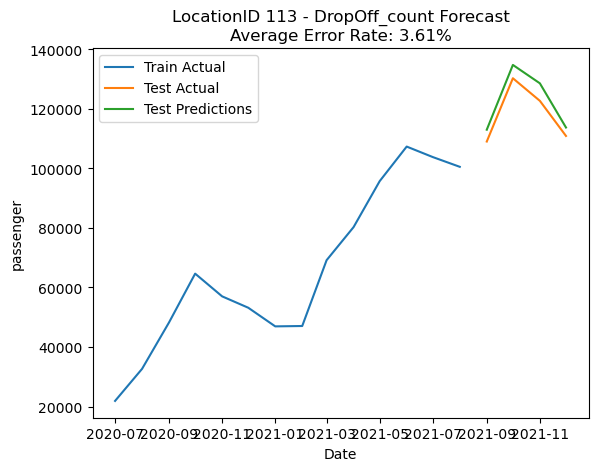

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


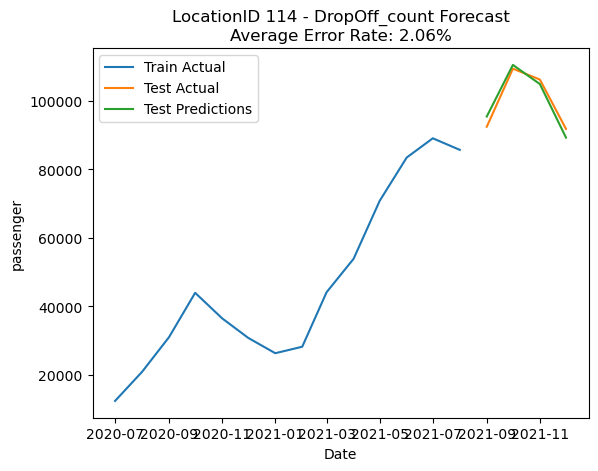

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


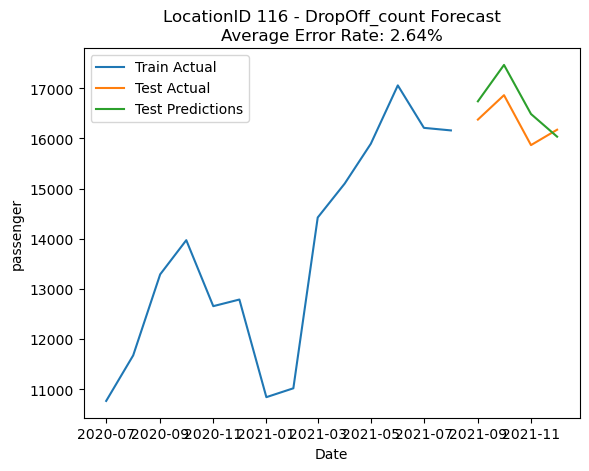

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


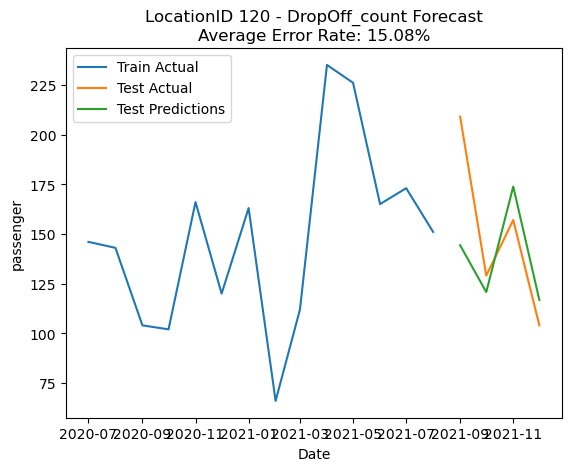

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


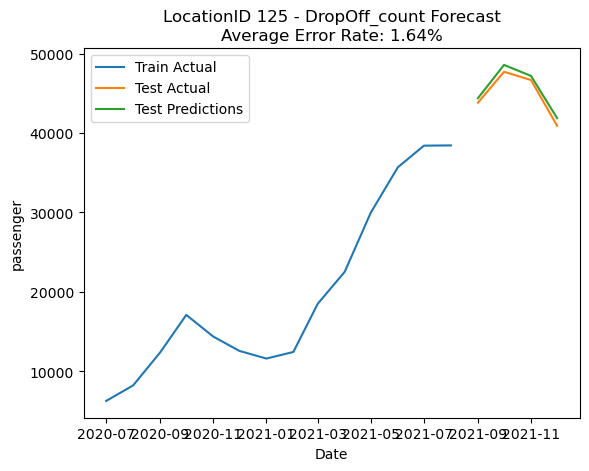

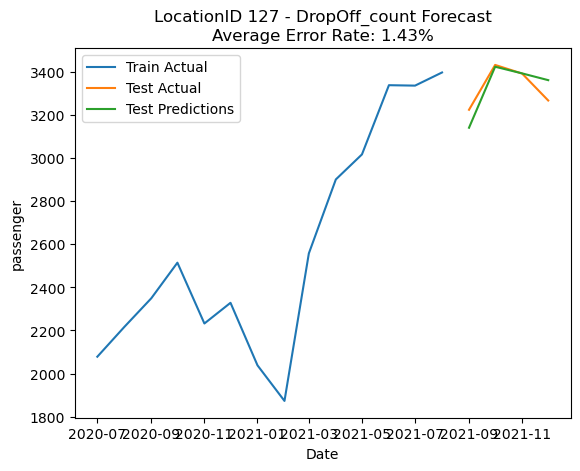

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


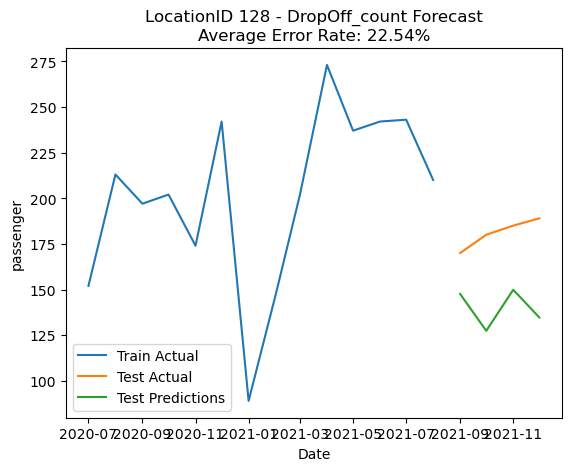

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


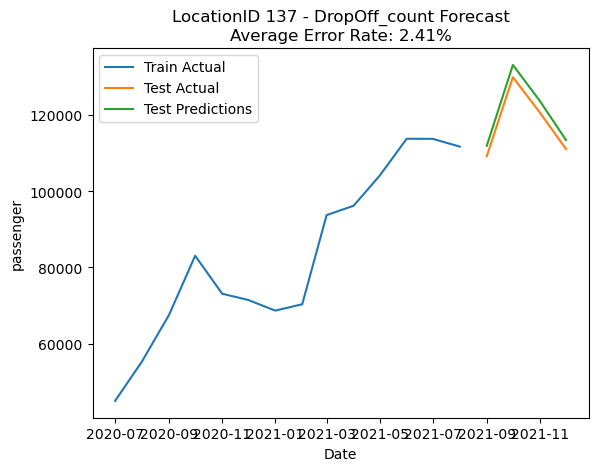

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


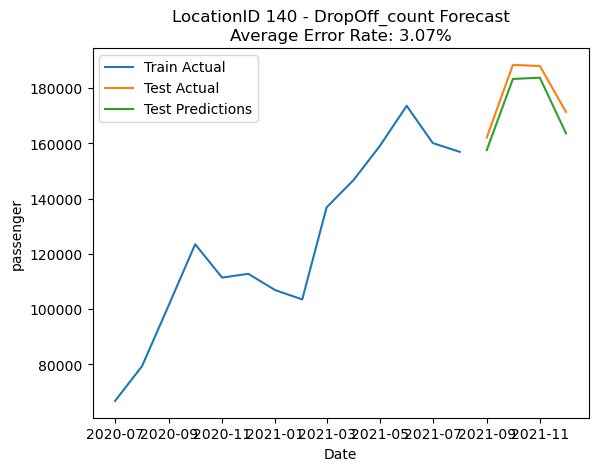

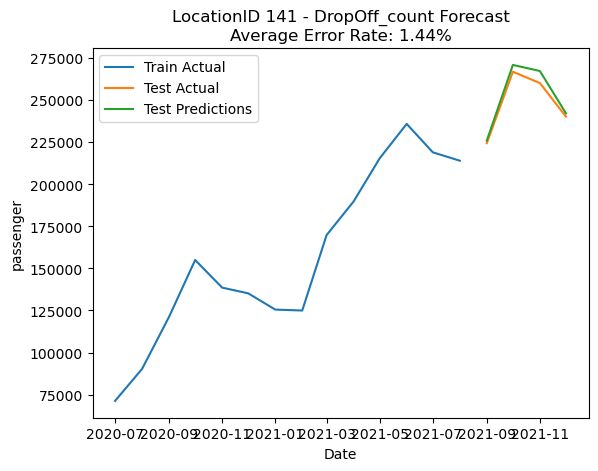

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


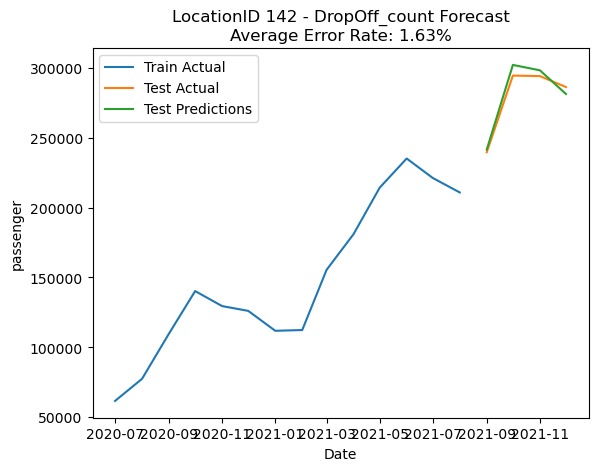

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


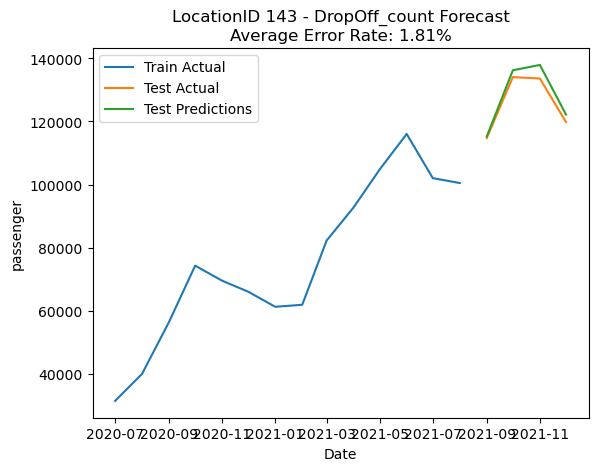

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


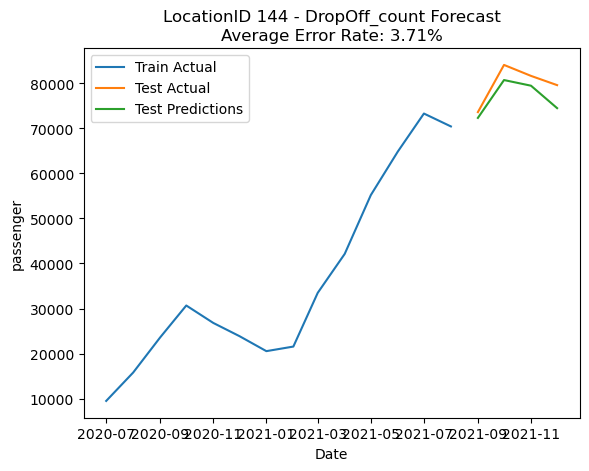

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


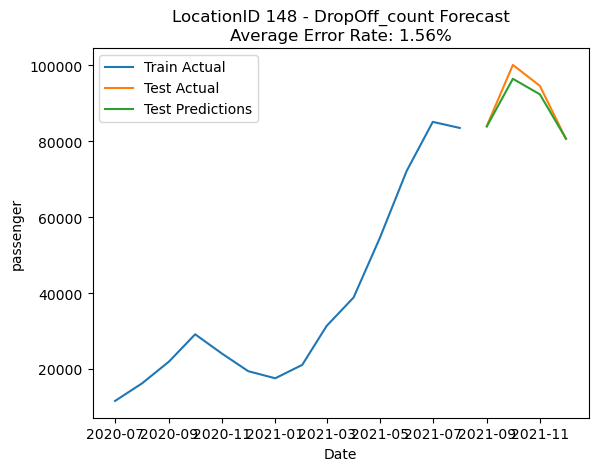

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


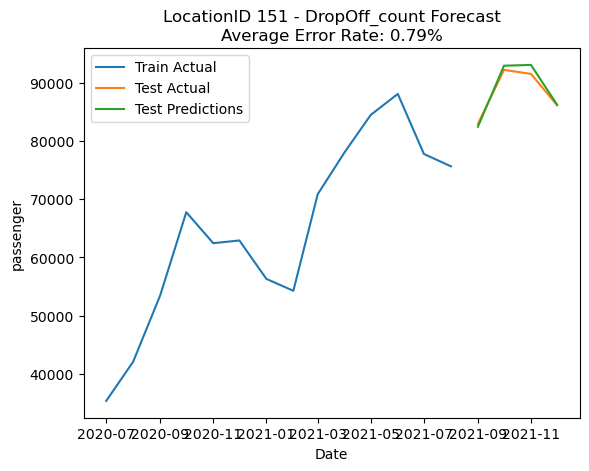

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


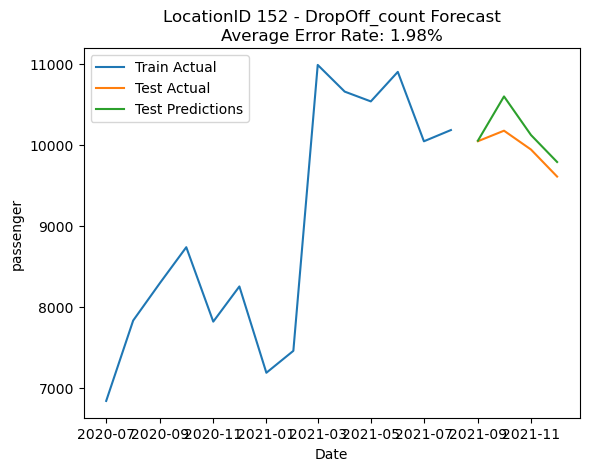

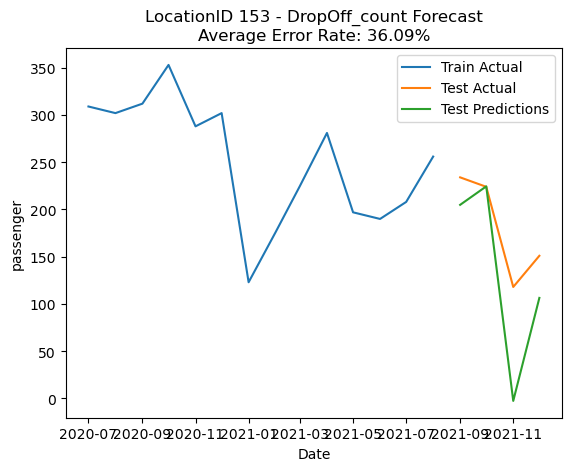

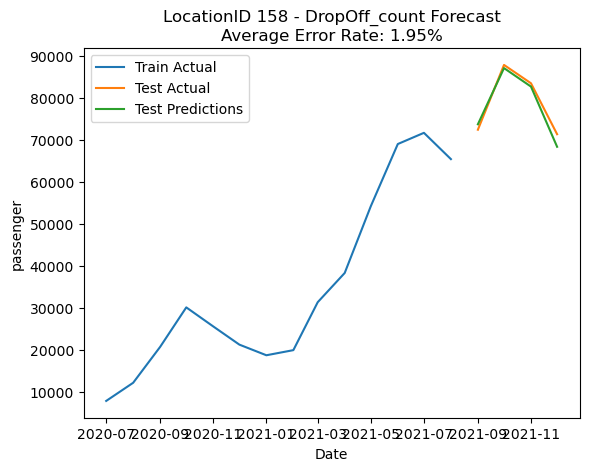

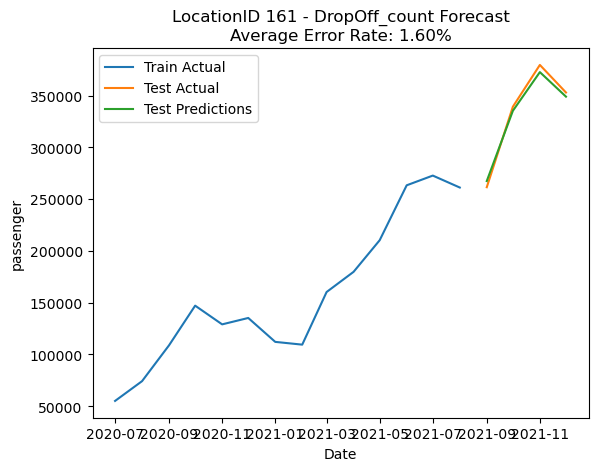

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


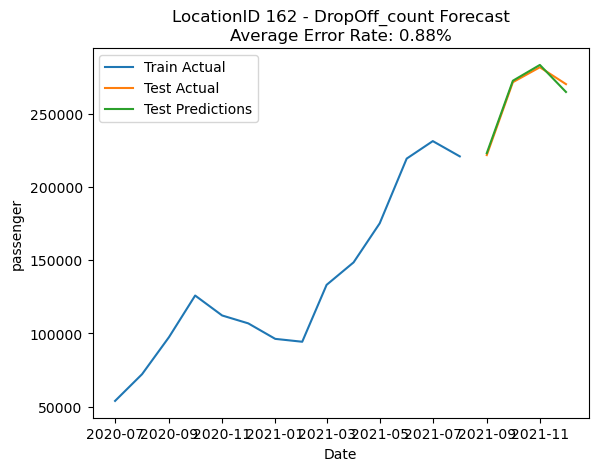

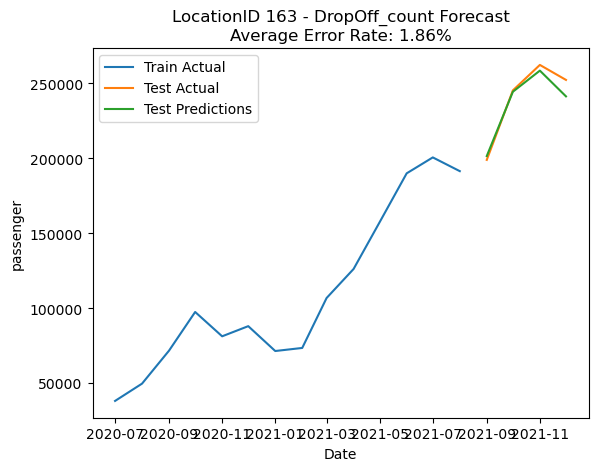

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


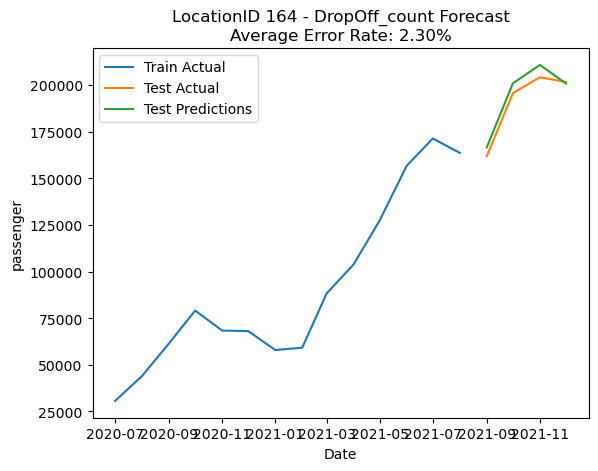

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


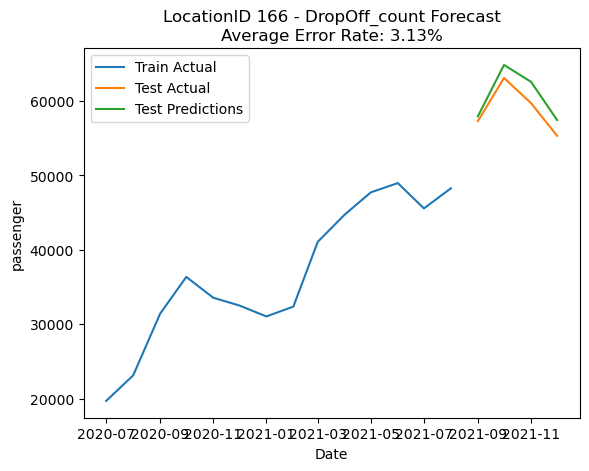

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


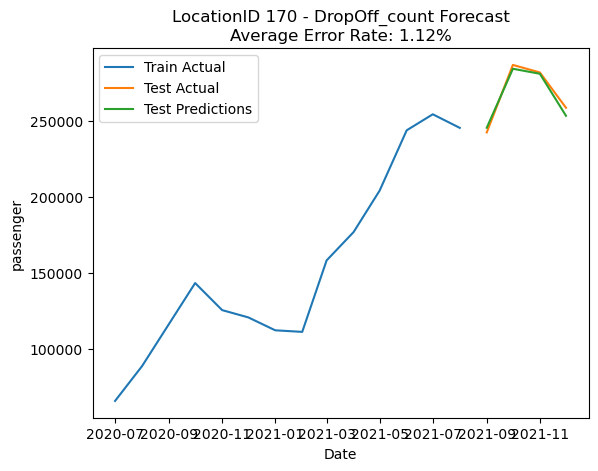

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


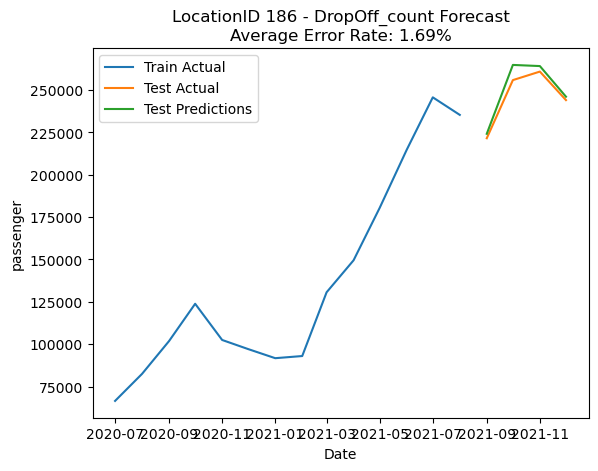

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


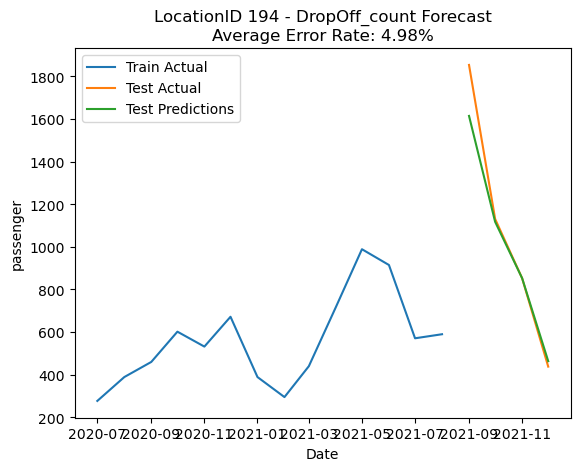

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


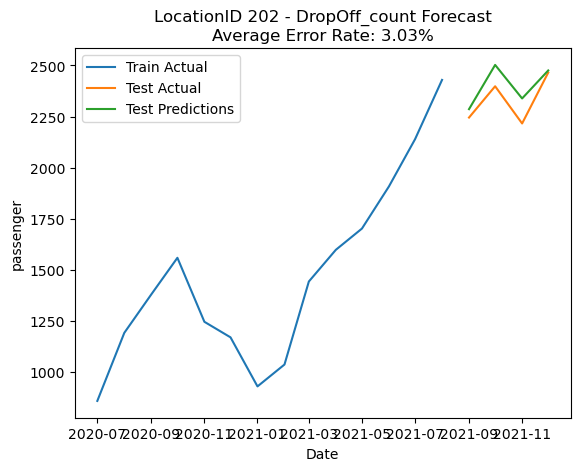

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


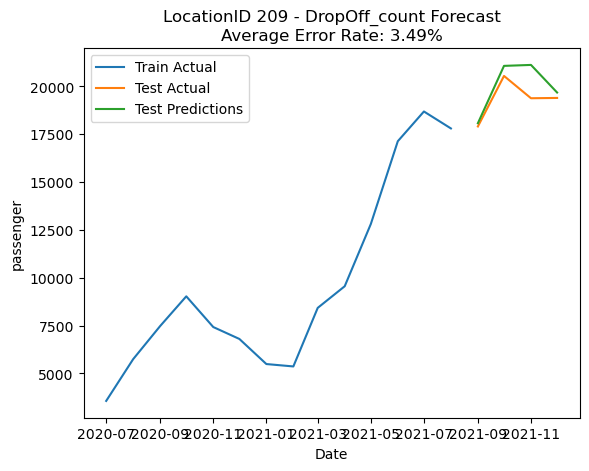

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


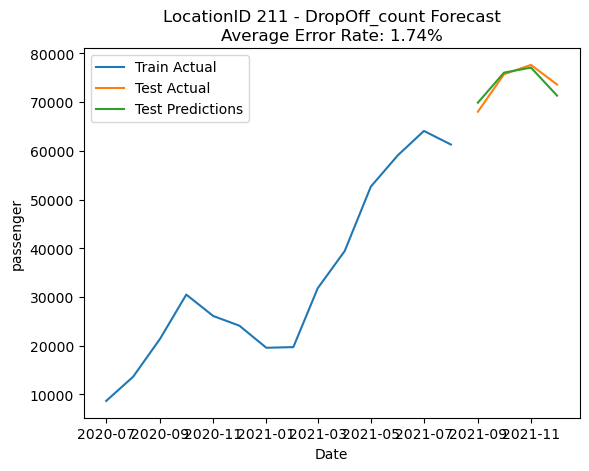

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


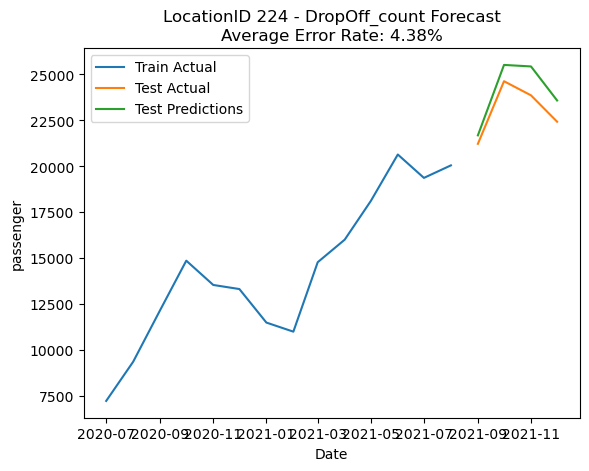

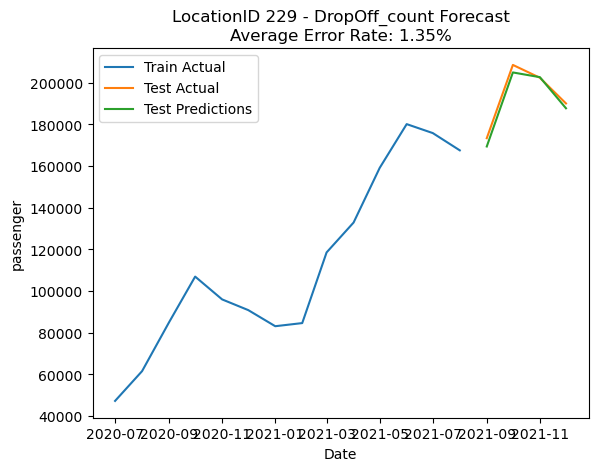

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


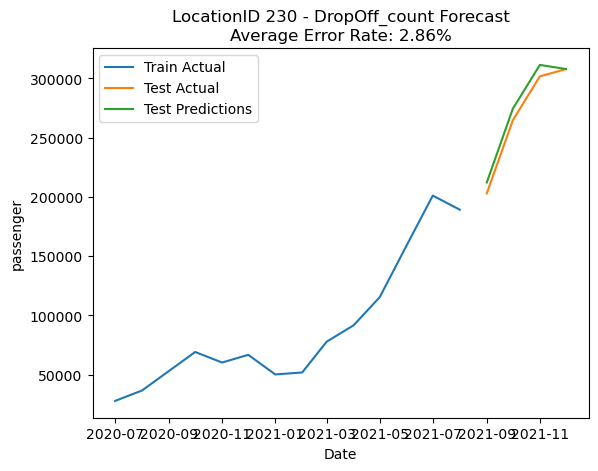

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


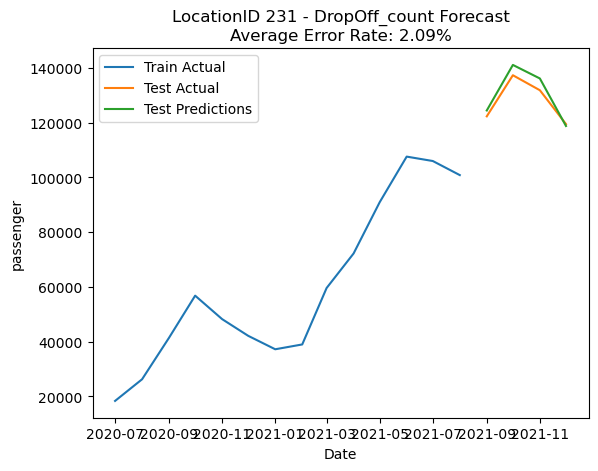

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


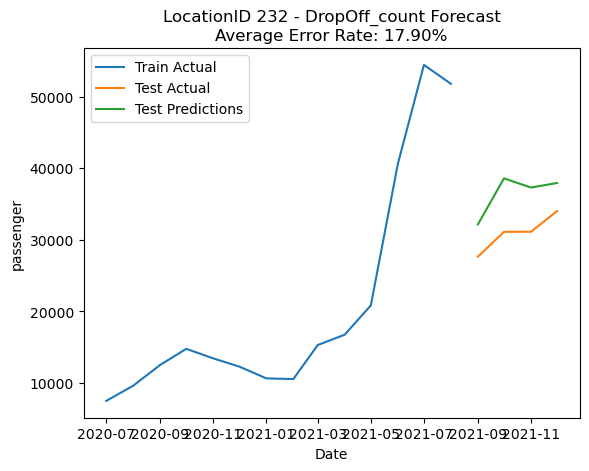

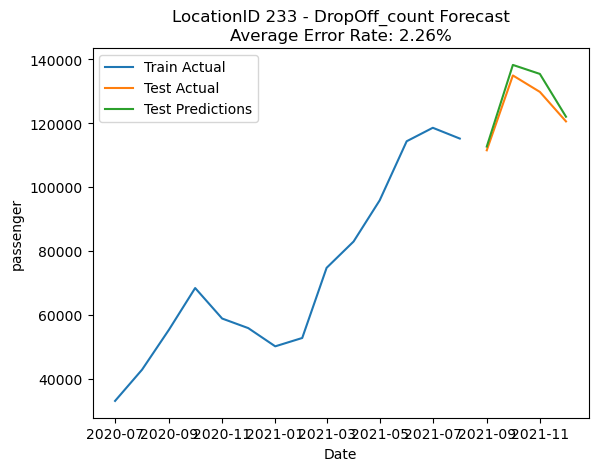

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


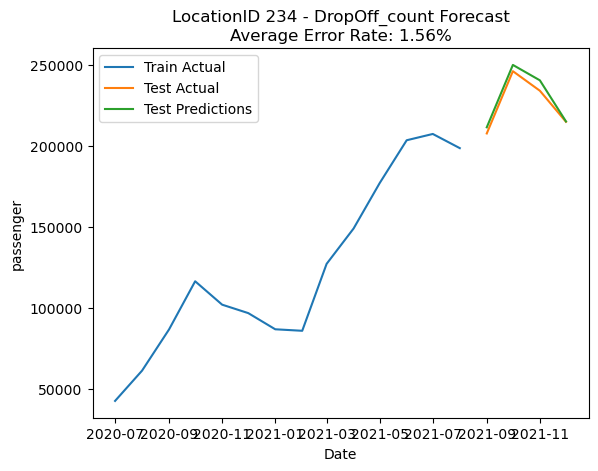

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


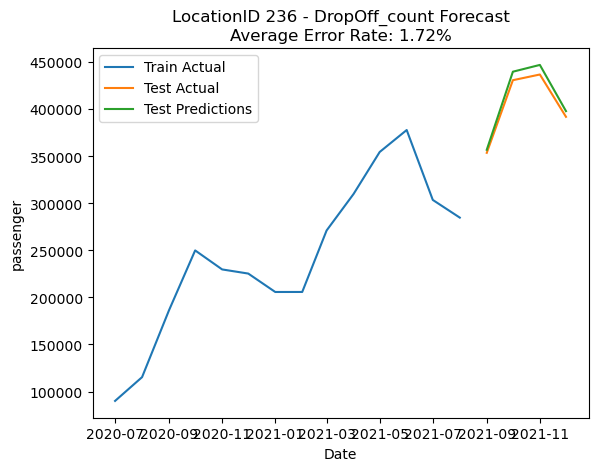

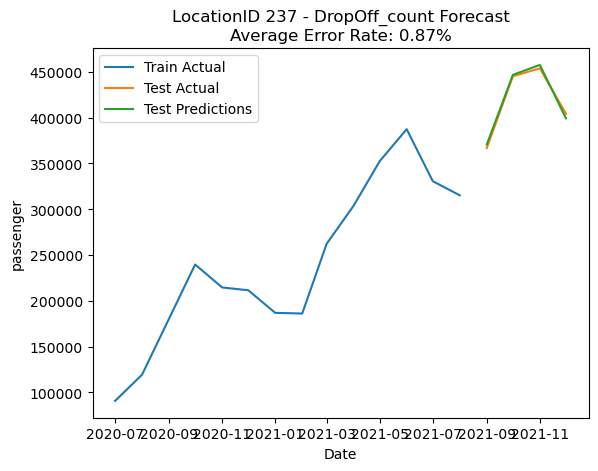

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


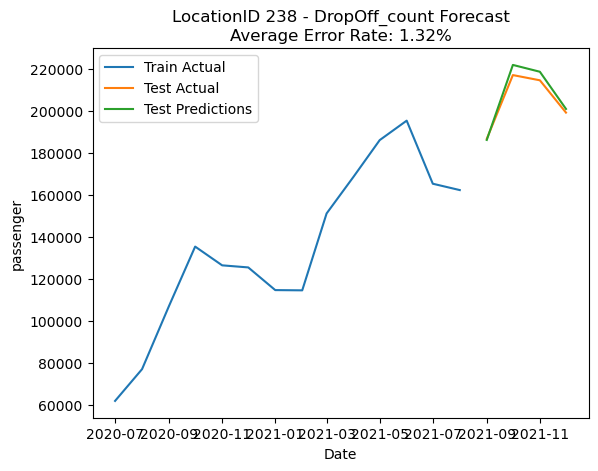

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


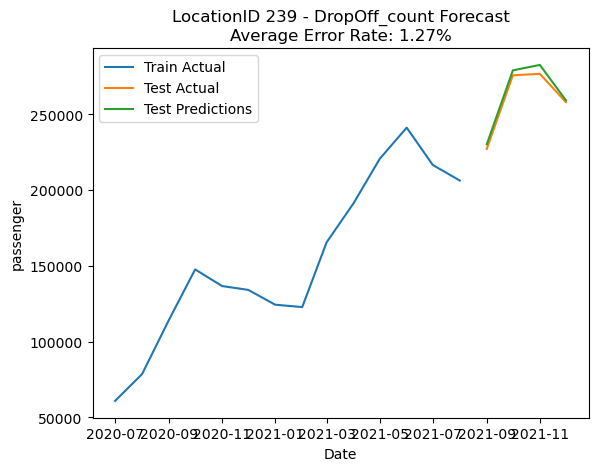

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


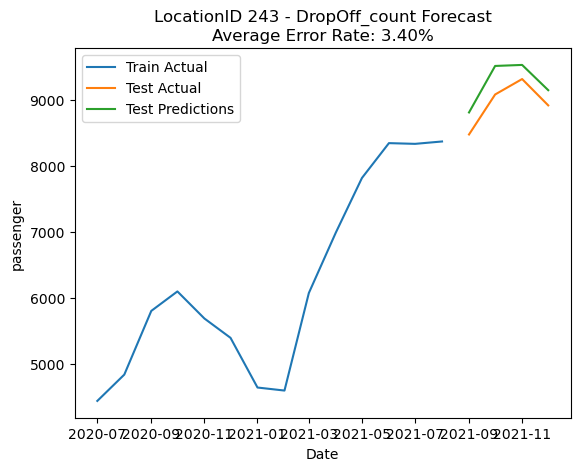

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


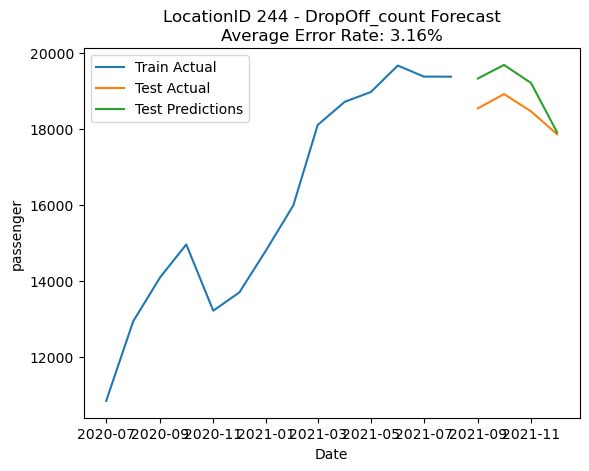

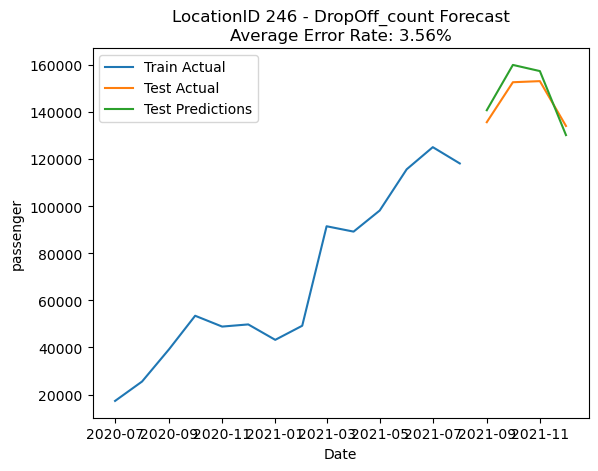

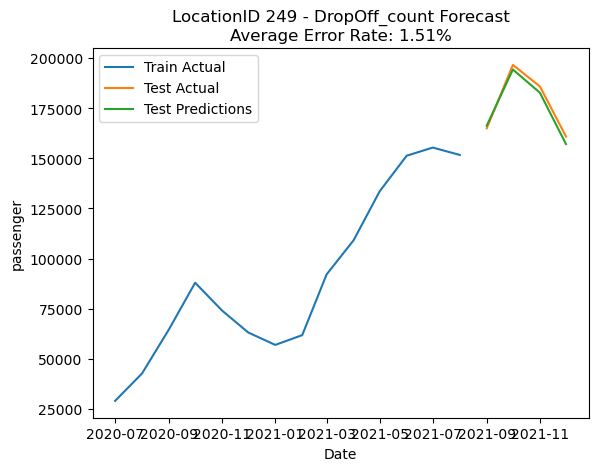

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


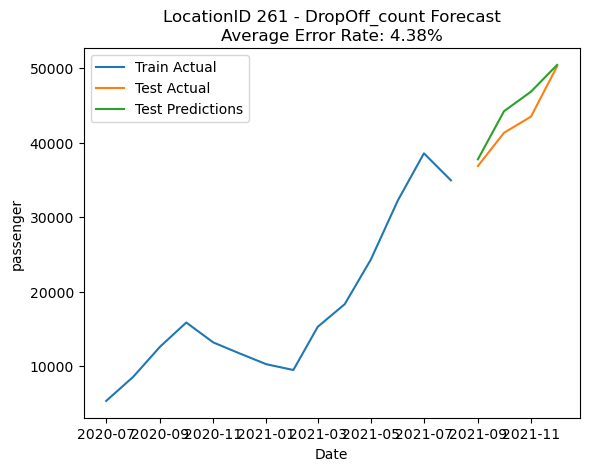

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


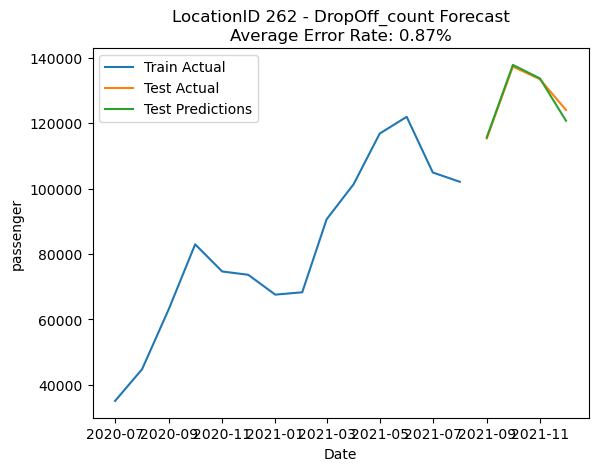

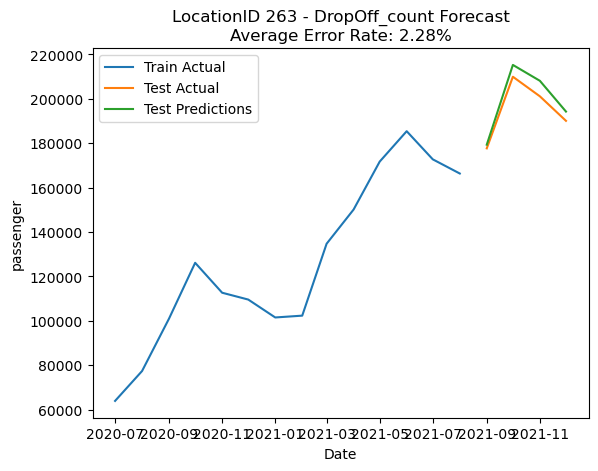

In [37]:
# Convert Date column to date time type
data['Date'] = pd.to_datetime(data['Date'])

values_to_delete = []

# Obtain a unique LocationID list
unique_location_ids = data['LocationID'].unique()

# Using the delete function from numpy to remove specific values.
updated_location_ids = np.delete(unique_location_ids, np.where(np.isin(unique_location_ids, values_to_delete)))

# Define ARIMA model parameters
order = (2, 1, 2)  # (AR order, difference order, MA order)


# Predict and plot data for each LocationID
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group = data[data['LocationID'] == location_id]

    # splitting the dataset into training and testing data
    train_size = int(len(group) * 0.8)
    train_data = group.iloc[:train_size]
    test_data = group.iloc[train_size:]

    # extracting training data and testing data
    train_PUcount = train_data['PickUp_count'].values
    train_DOcount = train_data['DropOff_count'].values
    
    train_features = np.column_stack((train_PUcount, train_DOcount))
    train_target = train_data['passenger'].values

    # To train an ARIMA
    model = ARIMA(train_target, exog=train_features, order=order)
    model_fit = model.fit()

    # To make predictions
    test_features = np.column_stack((test_data['PickUp_count'].values, test_data['DropOff_count'].values))
    test_predictions_passenger = model_fit.predict(start=train_size, end=len(group)-1, exog=test_features)

    # To calculate the error rate for the predictions
    error_rate = np.abs(test_predictions_passenger - test_data['passenger'].values) / test_data['passenger'].values
    average_error_rate = np.mean(error_rate)
    

    # Draw Line chart
    plt.plot(train_data['Date'], train_target, label='Train Actual')
    plt.plot(test_data['Date'], test_data['passenger'].values, label='Test Actual')
    plt.plot(test_data['Date'], test_predictions_passenger, label='Test Predictions')
    plt.xlabel('Date')
    plt.ylabel('passenger')
    plt.title(f'LocationID {location_id} - DropOff_count Forecast\nAverage Error Rate: {average_error_rate:.2%}')
    plt.legend()
    plt.show()



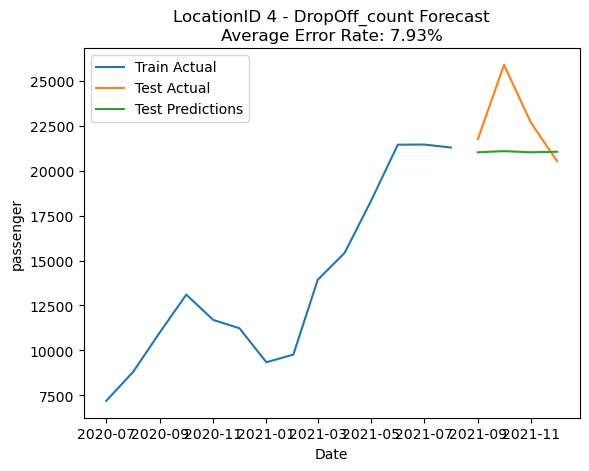

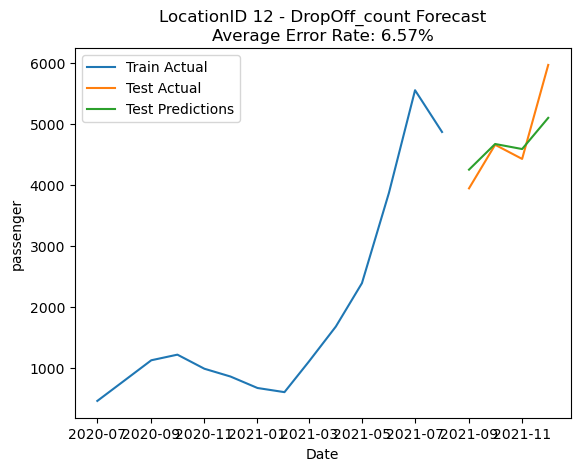

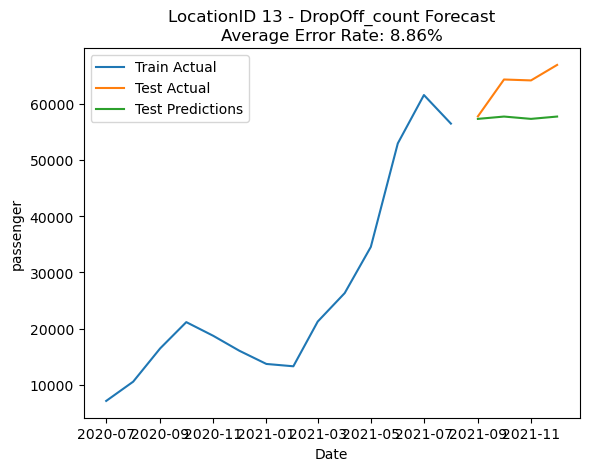

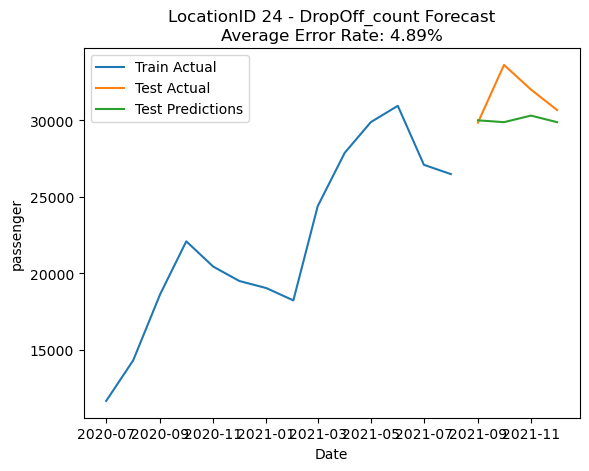

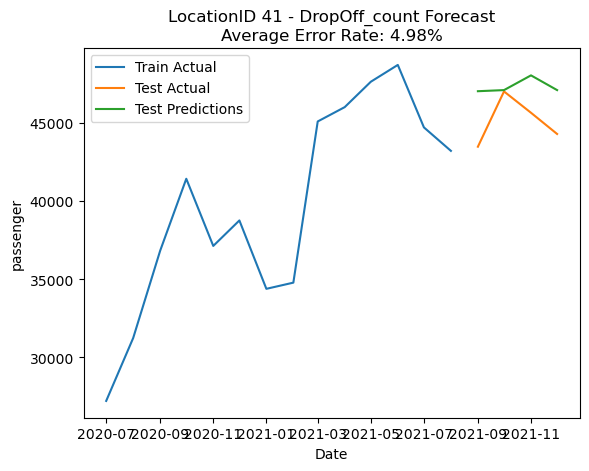

...

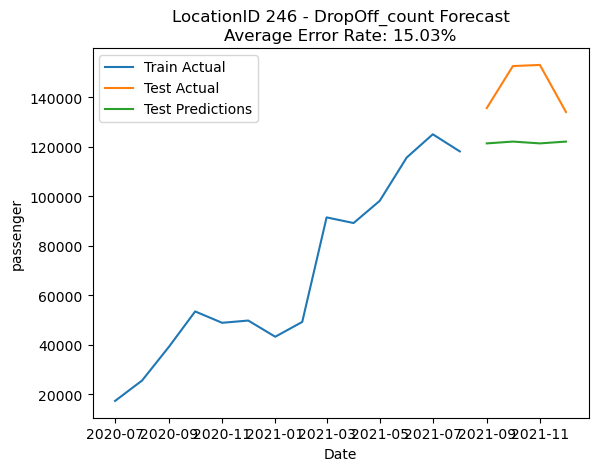

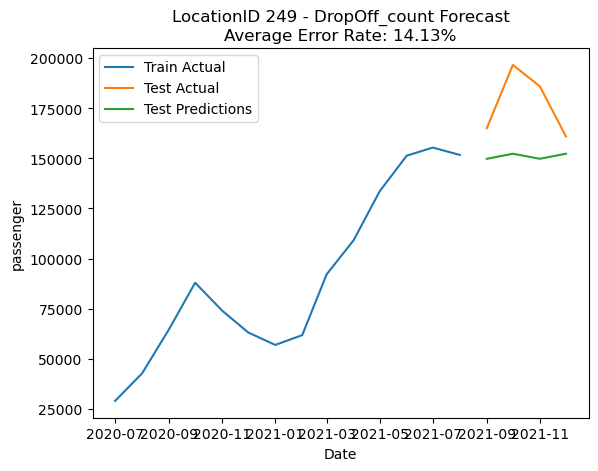

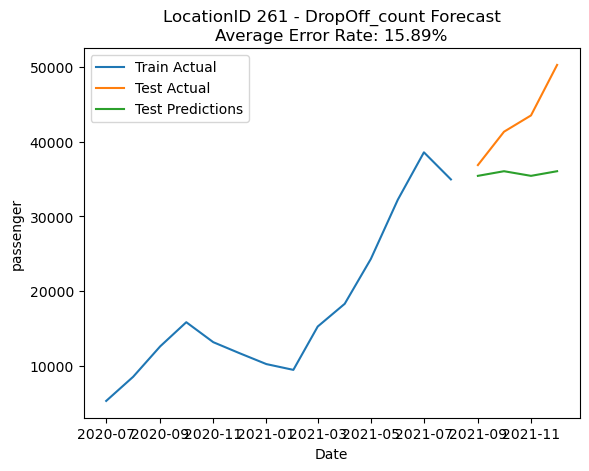

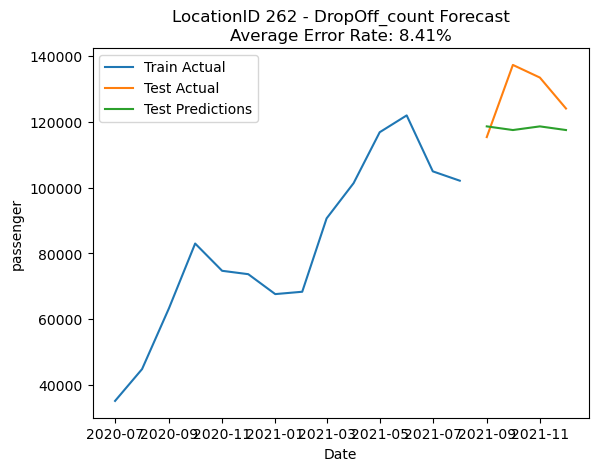

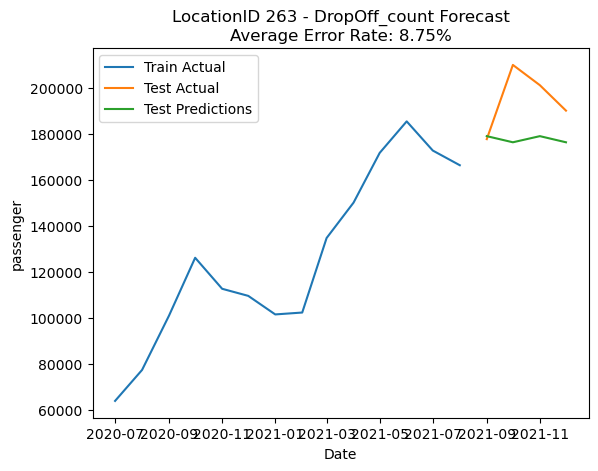

In [38]:
# Convert Date column to date time type
data['Date'] = pd.to_datetime(data['Date'])

# Obtain a unique LocationID list
unique_location_ids = data['LocationID'].unique()

# Define parameters of Random forest model
n_estimators = 100  # Number of decision trees
max_features = 'auto'  # Automatic selection of feature quantity

# Predict and plot data for each LocationID
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group = data[data['LocationID'] == location_id]

    # splitting the dataset into training and testing data
    train_size = int(len(group) * 0.8)
    train_data = group.iloc[:train_size]
    test_data = group.iloc[train_size:]

    # extracting training data and testing data
    train_features = train_data[['PickUp_count', 'DropOff_count']]
    train_target = train_data['passenger']

    # To train a Random Forest model
    model = RandomForestRegressor(n_estimators=n_estimators, max_features=max_features)
    model.fit(train_features, train_target)

    # To make predictions
    test_features = test_data[['PickUp_count', 'DropOff_count']]
    test_predictions_passenger = model.predict(test_features)

    # To calculate the error rate for the predictions
    error_rate = np.abs(test_predictions_passenger - test_data['passenger']) / test_data['passenger']
    average_error_rate = np.mean(error_rate)

    # Draw Line chart
    plt.plot(train_data['Date'], train_target, label='Train Actual')
    plt.plot(test_data['Date'], test_data['passenger'], label='Test Actual')
    plt.plot(test_data['Date'], test_predictions_passenger, label='Test Predictions')
    plt.xlabel('Date')
    plt.ylabel('passenger')
    plt.title(f'LocationID {location_id} - DropOff_count Forecast\nAverage Error Rate: {average_error_rate:.2%}')
    plt.legend()
    plt.show()



- Comparing the two models, the ARIMA model has relatively lower error rates, with most regions maintaining around 2% error. Therefore, the ARIMA model is utilized for data training.

#### Model training and  encapsulation 

In [39]:
values_to_delete = []

# Use numpy's delete function to delete a specific value
updated_location_ids = np.delete(unique_location_ids, np.where(np.isin(unique_location_ids, values_to_delete)))

# Define ARIMA model parameters
order = (2, 1, 2)  # (AR order, difference order, MA order)

# Convert Date column to date time type
data['Date'] = pd.to_datetime(data['Date'])

# Obtain a unique LocationID list
unique_location_ids = data['LocationID'].unique()

# Use numpy's delete function to delete a specific value
updated_location_ids = np.delete(unique_location_ids, np.where(np.isin(unique_location_ids, values_to_delete)))

# To create an empty model dictionary.
models_dict = {}

# Predict and plot data for each LocationID
for location_id in updated_location_ids:
        # Filter data based on LocationID
        group = data[data['LocationID'] == location_id]

        # splitting the dataset into training and testing data
        train_PUcount = group['PickUp_count'].values
        train_DOcount = group['DropOff_count'].values

        train_features = np.column_stack((train_PUcount, train_DOcount))
        train_target = group['passenger'].values

        # To train an ARIMA
        model = ARIMA(train_target, exog=train_features, order=order)
        model_fit = model.fit()

        # Save the models to the dictionary.
        models_dict[location_id] = model_fit


/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packag

- To encapsulate the model as a pickle file.

In [40]:
with open('models_Passenger.pkl', 'wb') as f:
    pickle.dump(models_dict, f)


### Part B: Forecasting the Overall Trend of Real Estate Prices using Linear Features of Real Estate Total Value:

###### Linear Regression Model 
    - FULLVAL

/var/folders/6g/ybj4cz9s1wd3hg435tvgpfb00000gn/T/ipykernel_42242/1365193551.py:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv('programing data/Real_Estate.csv')


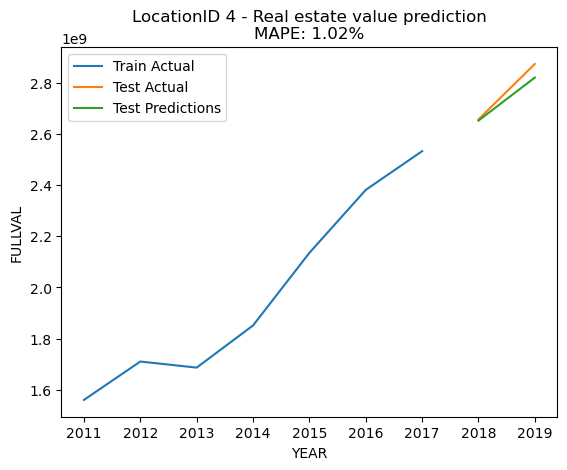

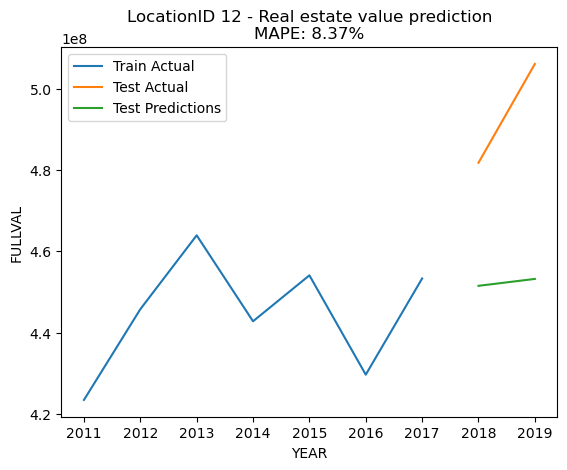

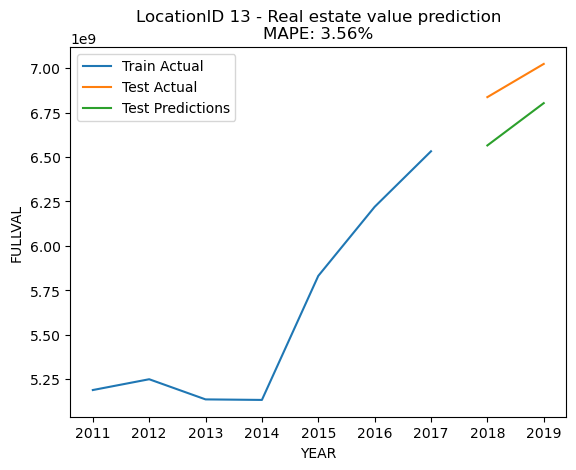

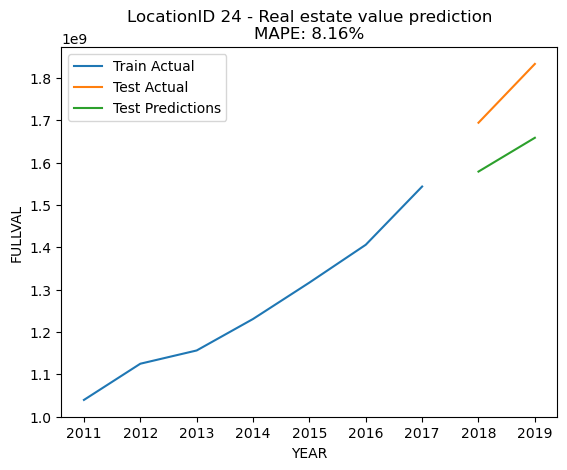

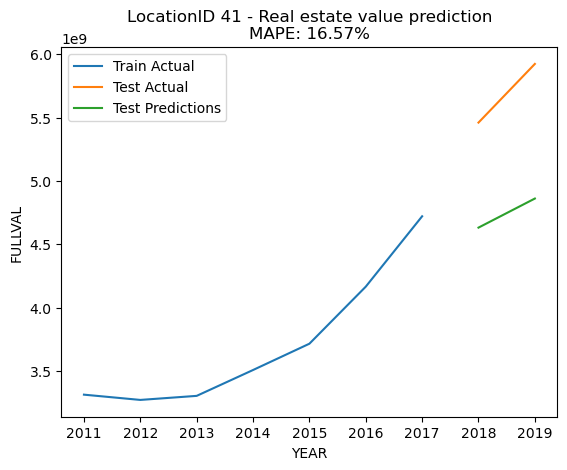

...

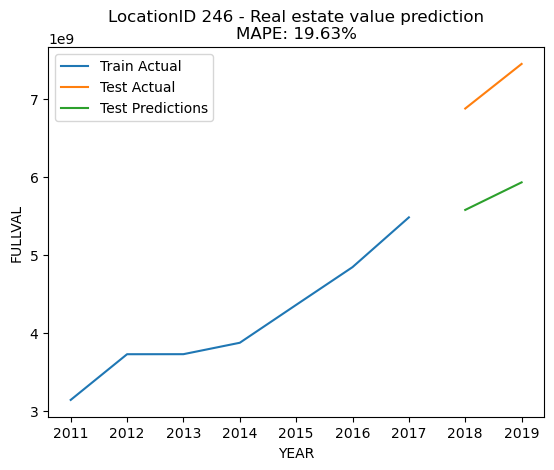

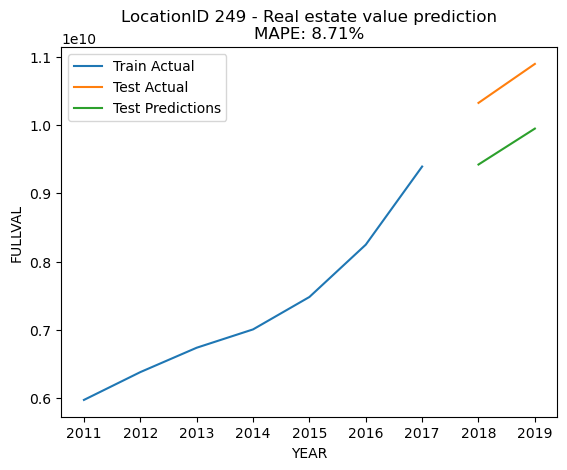

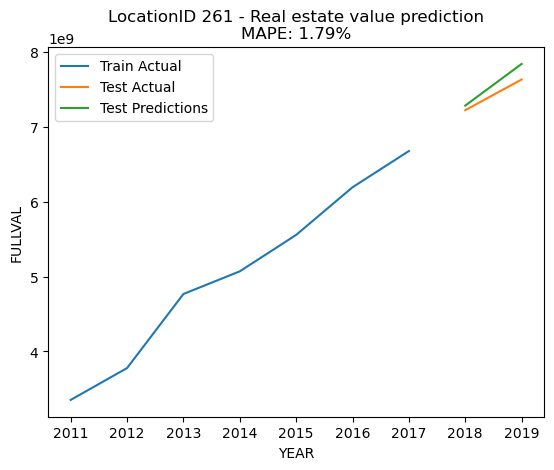

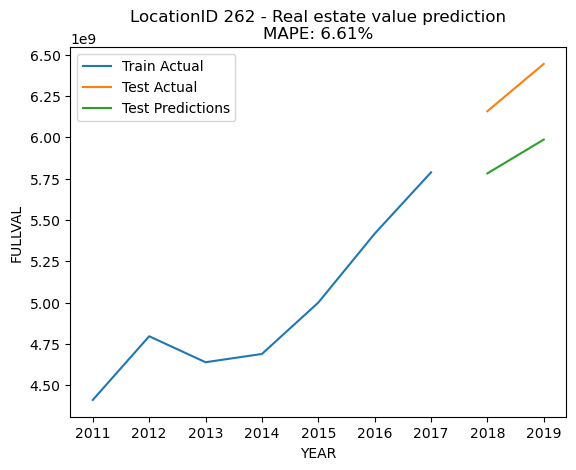

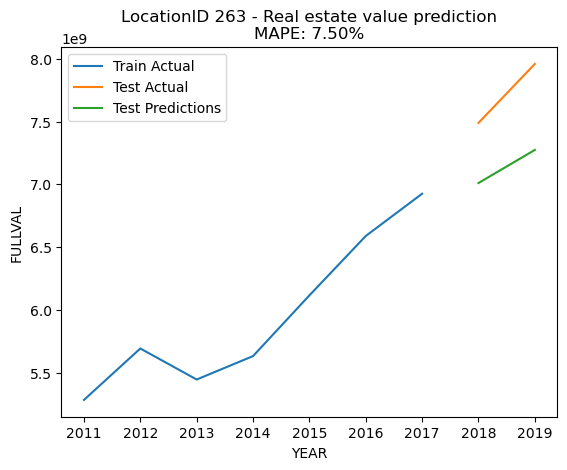

In [42]:
data = pd.read_csv('programing data/Real_Estate.csv')

data['YEAR'] = data['YEAR'].astype(int)
grouped_data = data.groupby(['YEAR', 'LocationID'])['FULLVAL'].sum().reset_index()
train_data = grouped_data[(grouped_data['YEAR'] >= 2011) & (grouped_data['YEAR'] <= 2017)]
test_data = grouped_data[(grouped_data['YEAR'] >= 2018) & (grouped_data['YEAR'] <= 2019)]
unique_location_ids = grouped_data['LocationID'].unique()
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group_train = train_data[train_data['LocationID'] == location_id]
    group_test = test_data[test_data['LocationID'] == location_id]

    # splitting the dataset into training and testing data
    train_features = group_train['YEAR'].values.reshape(-1, 1)
    train_target = group_train['FULLVAL'].values
    test_features = group_test['YEAR'].values.reshape(-1, 1)
    test_target_actual = group_test['FULLVAL'].values

    # Create a linear regression model
    model = LinearRegression()
    model.fit(train_features, train_target)

    # To make predictions
    test_target_predicted = model.predict(test_features)

    # To calculate the error rate for the predictions
    mape = mean_absolute_percentage_error(test_target_actual, test_target_predicted)

    # Draw Line chart
    plt.plot(group_train['YEAR'], group_train['FULLVAL'], label='Train Actual')
    plt.plot(group_test['YEAR'], test_target_actual, label='Test Actual')
    plt.plot(group_test['YEAR'], test_target_predicted, label='Test Predictions')
    plt.xlabel('YEAR')
    plt.ylabel('FULLVAL')
    plt.title(f'LocationID {location_id} - Real estate value prediction\nMAPE: {mape:.2%}')
    plt.legend()
    plt.show()


###### Random Forest model
    - FULLVAL

/var/folders/6g/ybj4cz9s1wd3hg435tvgpfb00000gn/T/ipykernel_42242/135701317.py:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv('programing data/Real_Estate.csv')


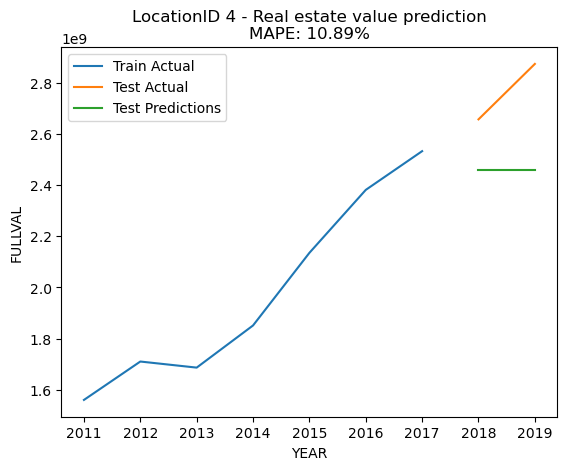

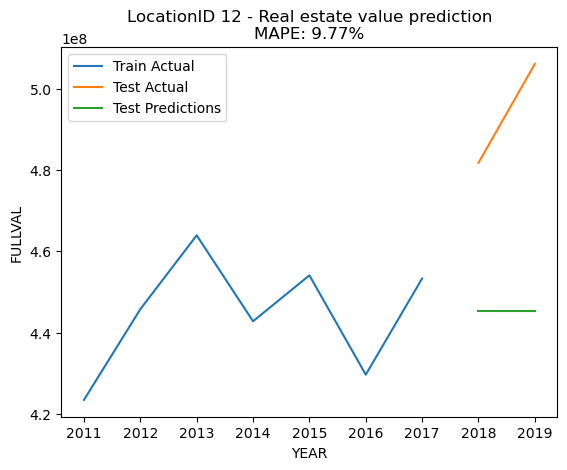

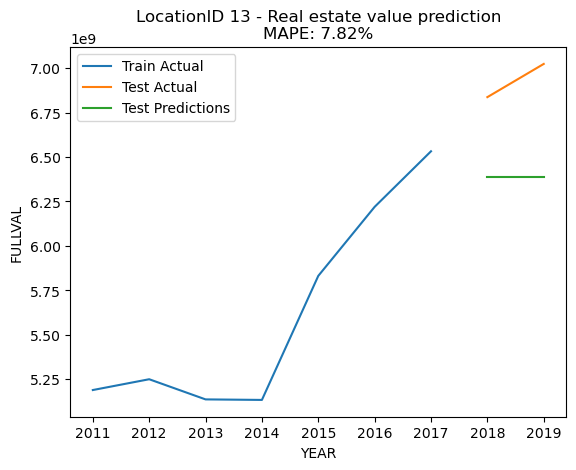

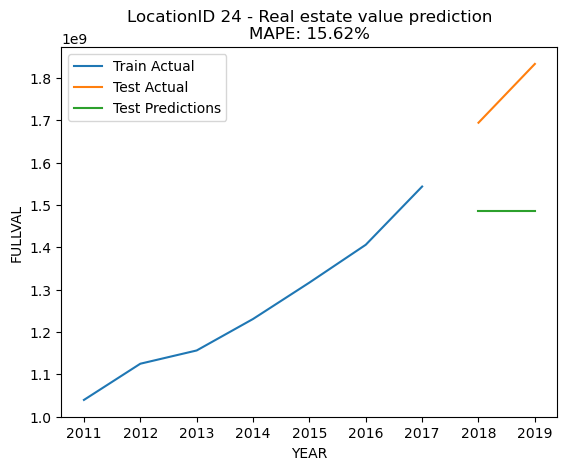

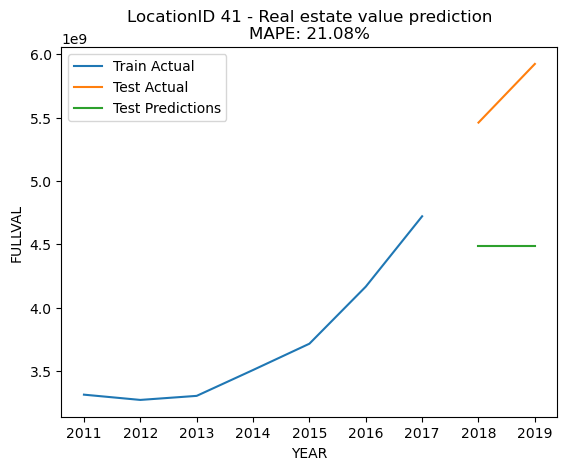

...

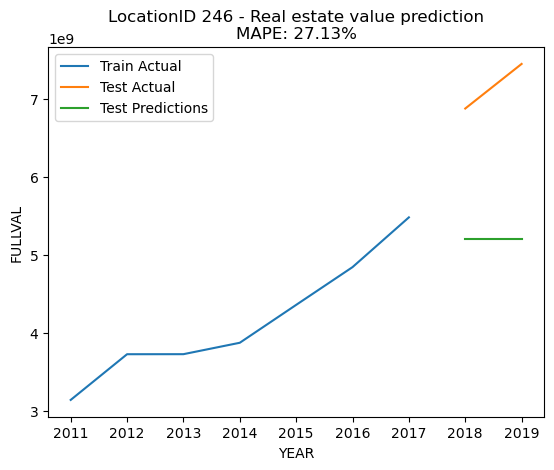

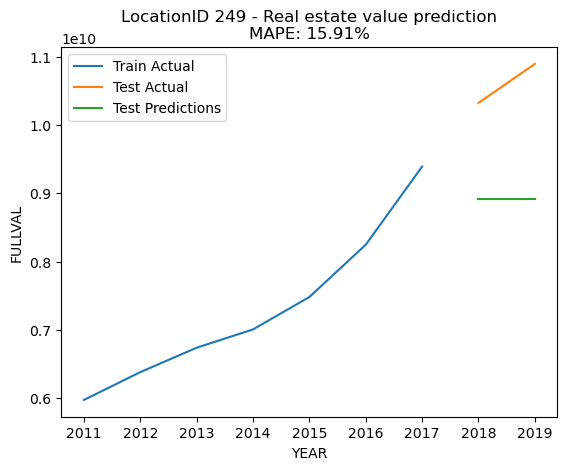

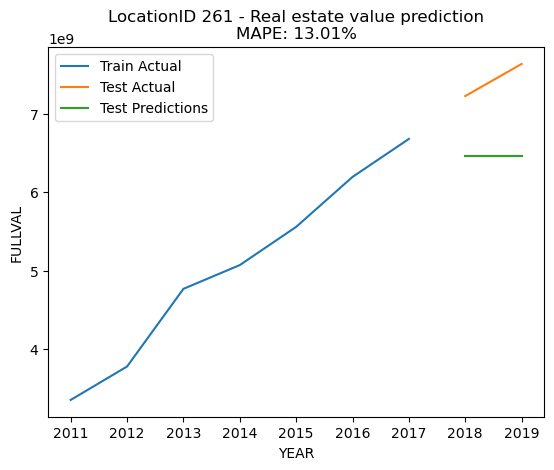

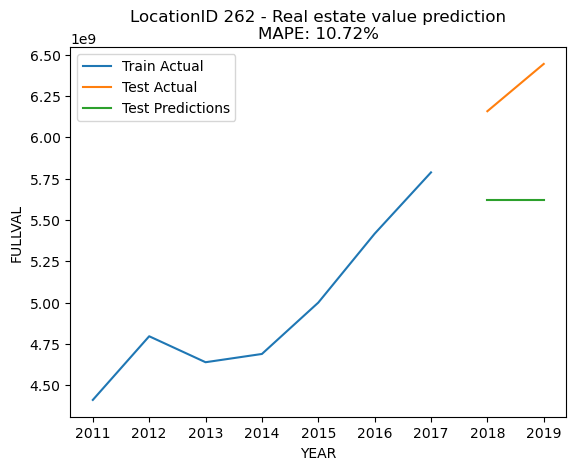

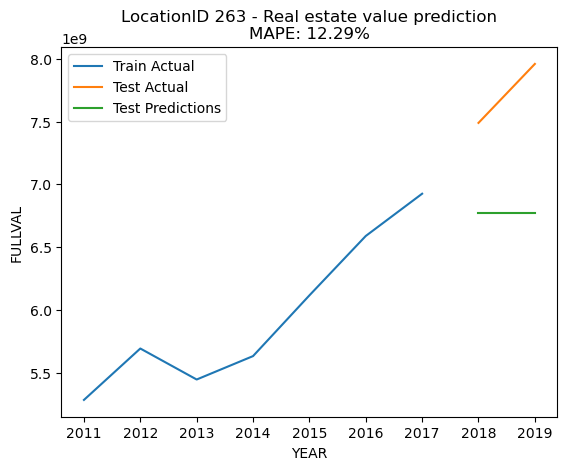

In [43]:
data = pd.read_csv('programing data/Real_Estate.csv')

data['YEAR'] = data['YEAR'].astype(int)
grouped_data = data.groupby(['YEAR', 'LocationID'])['FULLVAL'].sum().reset_index()
train_data = grouped_data[(grouped_data['YEAR'] >= 2011) & (grouped_data['YEAR'] <= 2017)]
test_data = grouped_data[(grouped_data['YEAR'] >= 2018) & (grouped_data['YEAR'] <= 2019)]
unique_location_ids = grouped_data['LocationID'].unique()

for location_id in unique_location_ids:
    # Filter data based on LocationID
    group_train = train_data[train_data['LocationID'] == location_id]
    group_test = test_data[test_data['LocationID'] == location_id]

    # splitting the dataset into training and testing data
    train_features = group_train[['YEAR']]  # Use 'YEAR' as the only feature
    train_target = group_train['FULLVAL']
    test_features = group_test[['YEAR']]
    test_target_actual = group_test['FULLVAL']

    # Create a Random Forest regression model
    n_estimators = 100
    max_depth = 5
    model = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, random_state=42)
    model.fit(train_features, train_target)

    # To make predictions
    test_target_predicted = model.predict(test_features)

    # To calculate the error rate for the predictions
    mape = mean_absolute_percentage_error(test_target_actual, test_target_predicted)

    # Draw Line chart
    plt.plot(group_train['YEAR'], group_train['FULLVAL'], label='Train Actual')
    plt.plot(group_test['YEAR'], test_target_actual, label='Test Actual')
    plt.plot(group_test['YEAR'], test_target_predicted, label='Test Predictions')
    plt.xlabel('YEAR')
    plt.ylabel('FULLVAL')
    plt.title(f'LocationID {location_id} - Real estate value prediction\nMAPE: {mape:.2%}')
    plt.legend()
    plt.show()


- Comparing the two models, the  Linear Regression Model  has relatively lower error rates. Therefore, the  Linear Regression Model  is utilized for data training.

#### Model training and  encapsulation 

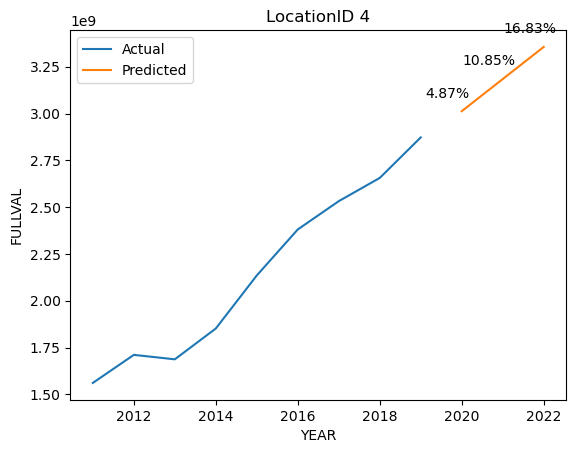

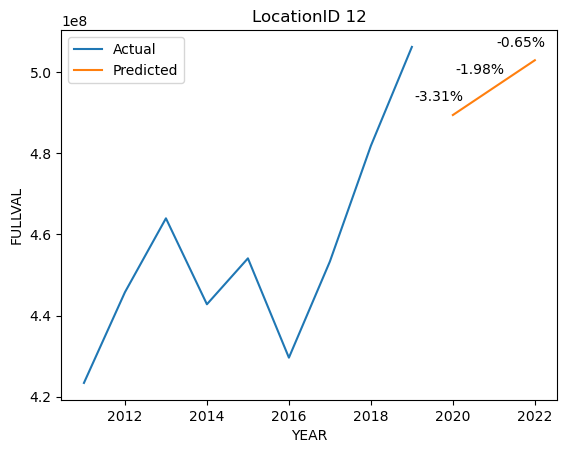

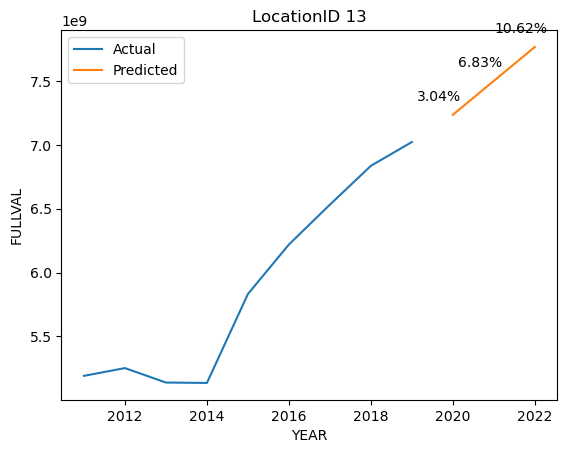

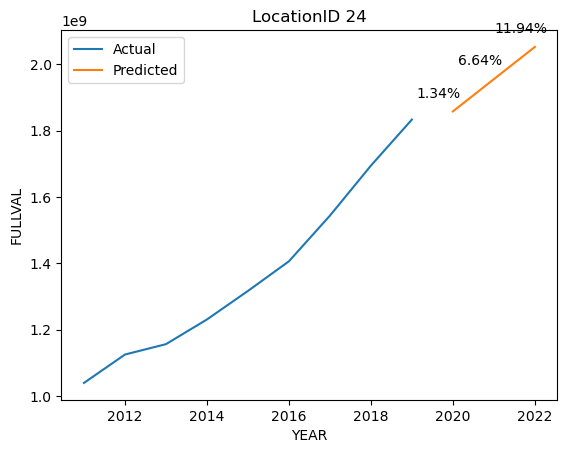

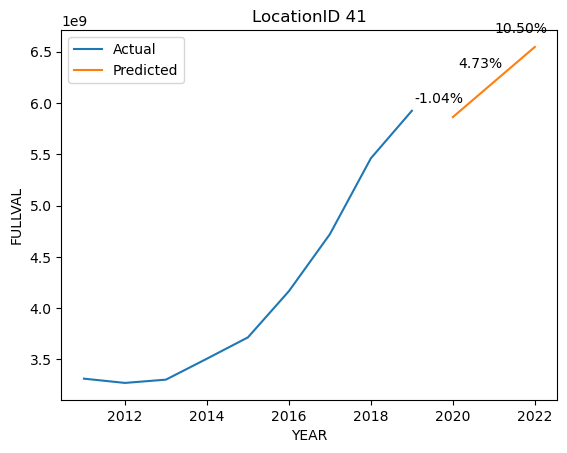

...

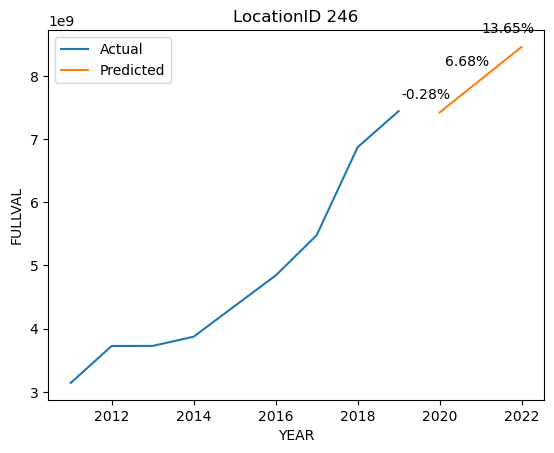

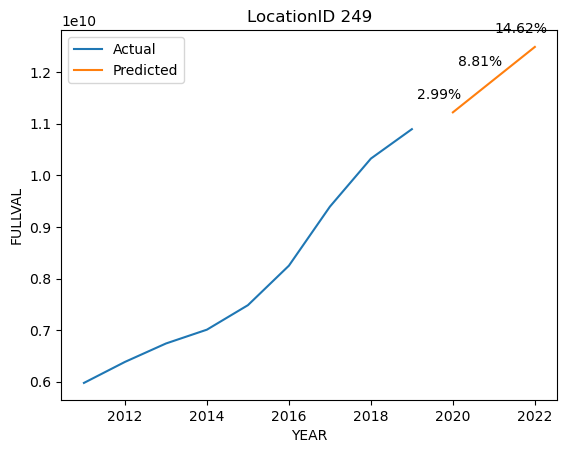

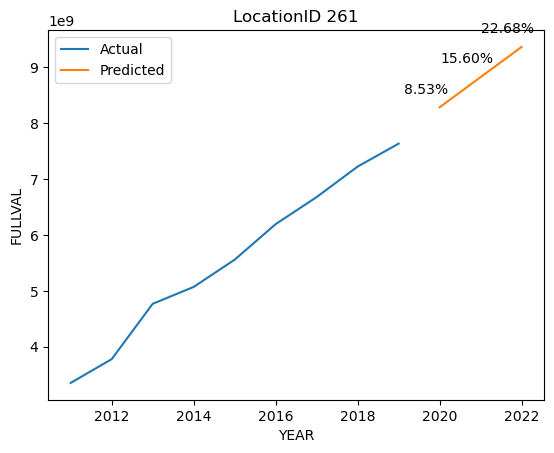

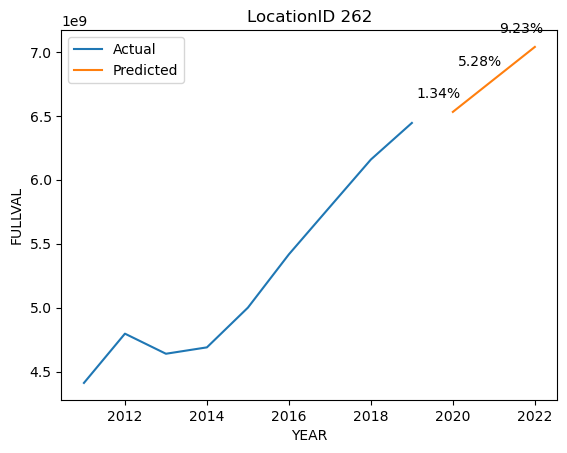

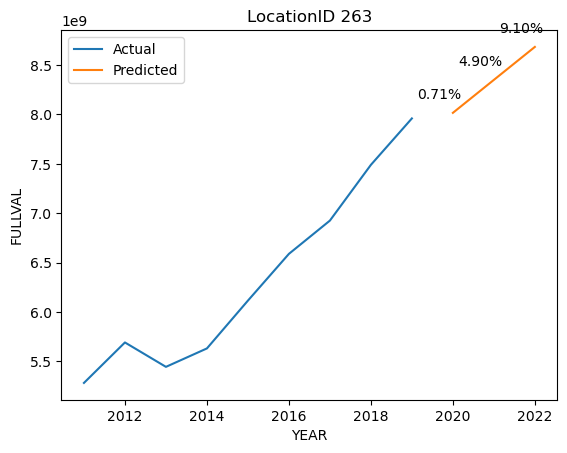

In [44]:

# To group the data based on YEAR and LocationID.
grouped_data = data.groupby(['YEAR', 'LocationID'])['FULLVAL'].sum().reset_index()

# To obtain a unique list of LocationID
unique_location_ids = grouped_data['LocationID'].unique()

# Create an empty model dictionary
models_dict = {}

# Modeling and forecasting for each LocationID
for i, location_id in enumerate(unique_location_ids):
    # Filter data based on LocationID
    group_data = grouped_data[grouped_data['LocationID'] == location_id]

    # To extract training features and target variables.
    train_features = group_data['YEAR'].values.reshape(-1, 1)
    train_target = group_data['FULLVAL'].values

    # To create a linear regression model.
    model = LinearRegression()
    model.fit(train_features, train_target)

    # To add the model to a dictionary.
    models_dict[location_id] = model

    # To generate a list of future 3 years' date data.
    future_years = np.array([2020, 2021, 2022]).reshape(-1, 1)

    # Make predictions for the next 3 years
    predictions = model.predict(future_years)

    # To calculate the growth rate.
    growth_rate = (predictions - train_target[-1]) / train_target[-1] * 100

    # To plot a line graph showing the predicted FULLVAL values and the growth rate.
    plt.plot(group_data['YEAR'], group_data['FULLVAL'], label='Actual')
    plt.plot(future_years.flatten(), predictions, label='Predicted')
    plt.xlabel('YEAR')
    plt.ylabel('FULLVAL')
    plt.title(f'LocationID {location_id}')
    plt.legend()

    # To add growth rate labels to the graphs.
    for j in range(len(future_years)):
        plt.annotate(f'{growth_rate[j]:.2f}%', (future_years[j], predictions[j]),
                     textcoords="offset points", xytext=(-10, 10), ha='center')

    # To display the graphs.
    plt.show()


- To encapsulate the model as a pickle file.

In [45]:
with open('models_RealEstate.pkl', 'wb') as f:
    pickle.dump(models_dict, f)

### C. Understanding the Impact of Different Variables on Real Estate Prices through OLS Regression Results:

- Reading the cleaned csv

In [46]:
taxi_data = pd.read_csv('programing data/month.csv')
property_data = pd.read_csv('programing data/Real_Estate.csv')

/var/folders/6g/ybj4cz9s1wd3hg435tvgpfb00000gn/T/ipykernel_42242/2861432041.py:2: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  property_data = pd.read_csv('programing data/Real_Estate.csv')


- merge data by YEAR and LocationID

In [47]:
property_data = property_data.groupby(['YEAR', 'LocationID'])['FULLVAL'].sum().reset_index()

# Convert 'Date' column to datetime format
taxi_data['Date'] = pd.to_datetime(taxi_data['Date'])
taxi_data['YEAR'] = taxi_data['Date'].dt.year

# Group by LocationID and Year, and sum the desired columns
taxi_data_grouped = taxi_data.groupby(['LocationID', 'YEAR']).agg({
    'PU_passenger': 'sum',
    'PUTripDistance_count': 'sum',
    'PickUp_count': 'sum',
    'PU_fare': 'sum',
    'DO_passenger': 'sum',
    'DropOff_count': 'sum',
    'DO_fare': 'sum',
    'DOT_fare': 'sum',
    'DOTripDistance_count': 'sum',
}).reset_index()

# Filter the data for 2017-2019
taxi_data_filtered = taxi_data_grouped[(taxi_data_grouped['YEAR'] >= 2017) & (taxi_data_grouped['YEAR'] <= 2019)]

property_data_filtered = property_data[(property_data['YEAR'] >= 2017) & (property_data['YEAR'] <= 2019)]

# Merge the filtered datasets
merged_data = pd.merge(taxi_data_filtered, property_data_filtered, on=['LocationID', 'YEAR'], suffixes=('_taxi', '_property'))


In [48]:
merged_data.head(5)

,LocationID,YEAR,PU_passenger,PUTripDistance_count,PickUp_count,PU_fare,DO_passenger,DropOff_count,DO_fare,DOT_fare,DOTripDistance_count,FULLVAL
0,4,2017,470891.0,758775.91,365,3428308.72,916970.0,567280,6231473.74,7802188.76,1335507.40,2532009971
1,4,2018,376428.0,616788.85,365,2801663.78,840303.0,528058,6248510.10,7734020.95,1254379.62,2656080255
2,4,2019,224544.0,384917.15,365,1746732.64,562997.0,361977,4147042.33,6110651.06,912459.63,2872525864
3,12,2017,97071.0,224369.84,365,931773.57,145406.0,82459,1279091.21,1478300.85,308744.75,453304000
4,12,2018,87401.0,211849.78,365,872375.89,138614.0,79184,1283244.19,1481318.89,309681.70,481795000


- Merge DO_passenger and PU_passenger into passenger; Merge DO_fare and PU_fare into fare;

In [49]:
merged_data['passenger'] = merged_data['DO_passenger'] + merged_data['PU_passenger']
merged_data['fare'] = merged_data['DO_fare'] + merged_data['PU_fare']

- The following are the statistical indicators (R-squared) achieved with the minimum number of columns that resulted in the highest fit

In [50]:
X = merged_data[['passenger','fare', 'DO_passenger', 'DropOff_count']]
y = merged_data['FULLVAL']
X = sm.add_constant(X)
model = sm.OLS(y, X)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                FULLVAL   R-squared:                       0.834
Model:                            OLS   Adj. R-squared:                  0.830
Method:                 Least Squares   F-statistic:                     242.3
Date:                Sat, 29 Jul 2023   Prob (F-statistic):           4.68e-74
Time:                        23:53:17   Log-Likelihood:                -4574.3
No. Observations:                 198   AIC:                             9159.
Df Residuals:                     193   BIC:                             9175.
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const          9.149e+07   3.46e+08      0.264

- To obtain coefficients for all communities (LocationIDs)

In [51]:
unique_location_ids = merged_data['LocationID'].unique()
# Create an empty dictionary
coef_dict = {}

# Modeling and forecasting for each LocationID
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group_data = merged_data[merged_data['LocationID'] == location_id]
    X = group_data[['passenger','fare', 'DO_passenger', 'DropOff_count']]
    y = group_data['FULLVAL']
    X = sm.add_constant(X)
    model = sm.OLS(y, X)
    results = model.fit()
    coef = results.params
    coef_dict[location_id] = coef



- At present, the prediction model of DropOff_count and fare has been established, and the prediction model of DO_passenger and fare needs to be obtained

In [52]:
data = pd.read_csv('programing data/month2020.csv')

In [53]:
data["passenger"] = data["PU_passenger"] + data["DO_passenger"]
data["fare"] = data["PU_fare"] + data["DO_fare"]

- prediction model of fare

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


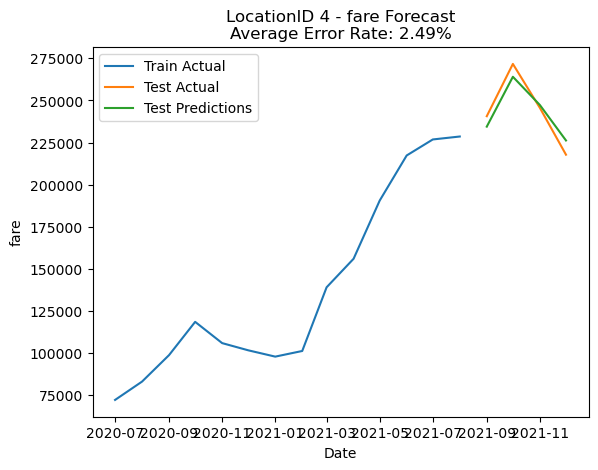

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


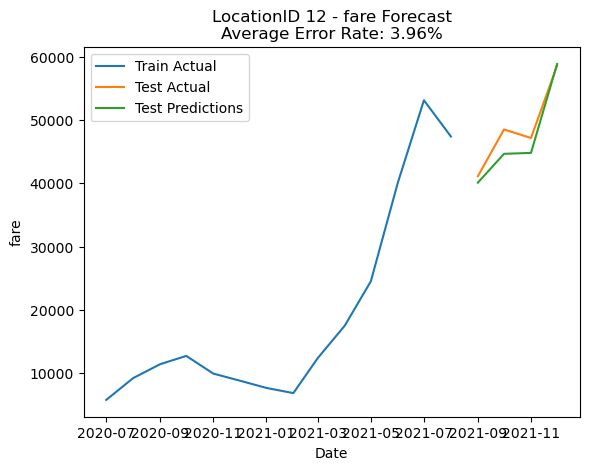

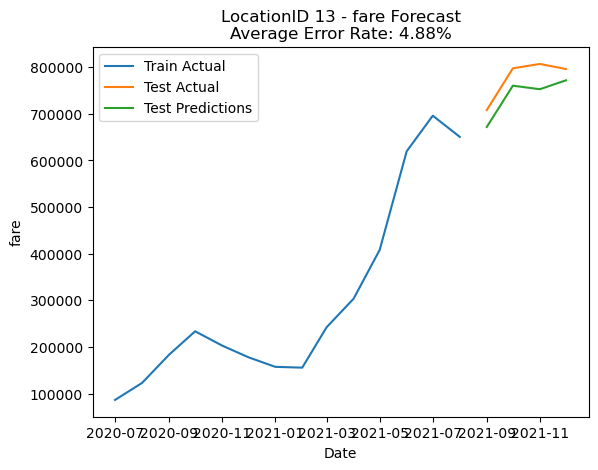

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


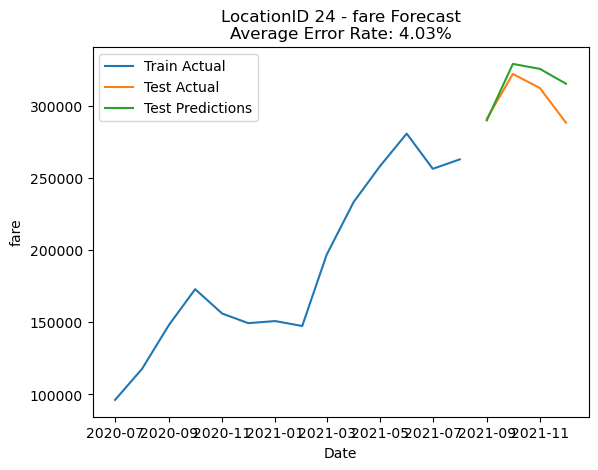

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


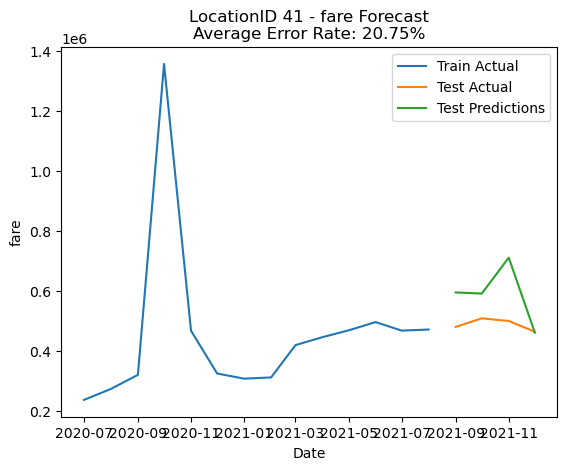

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


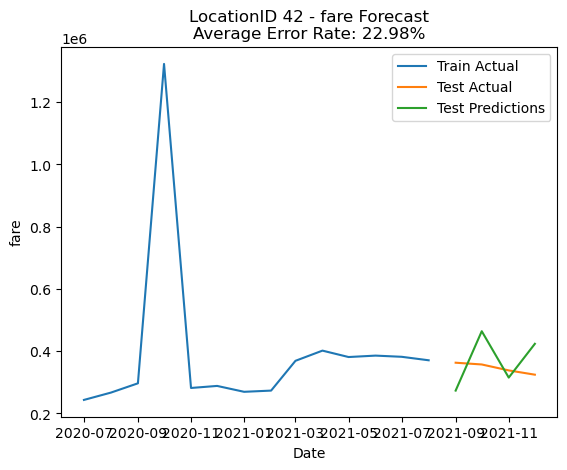

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


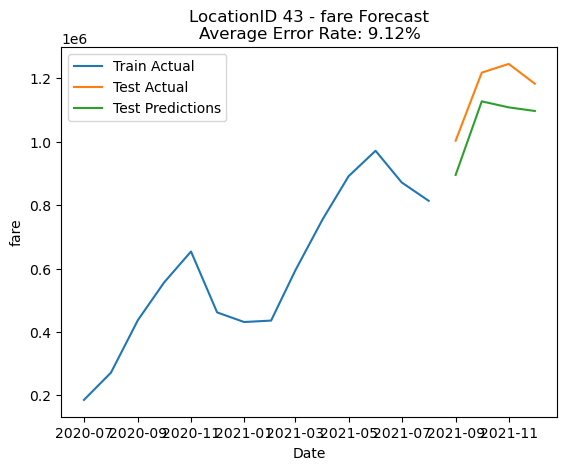

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


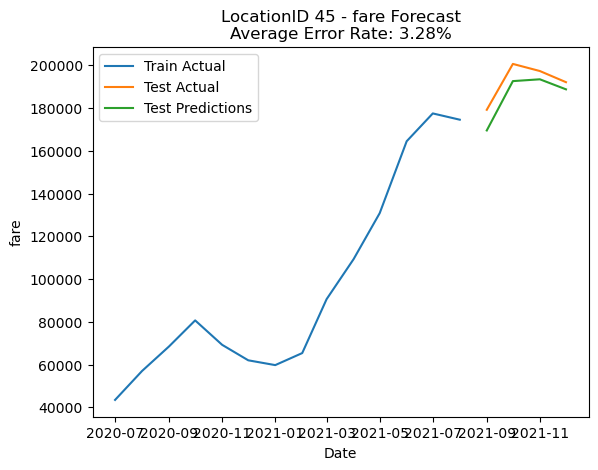

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


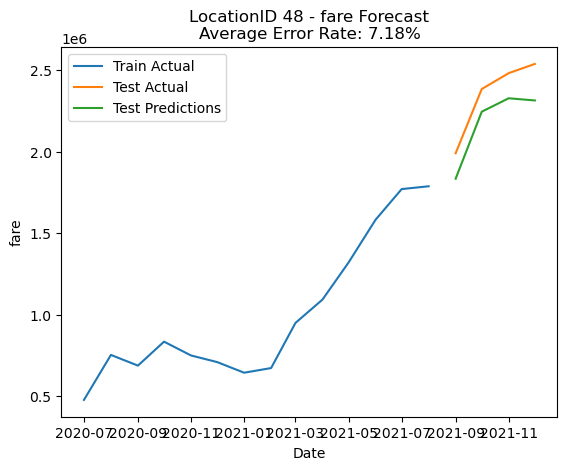

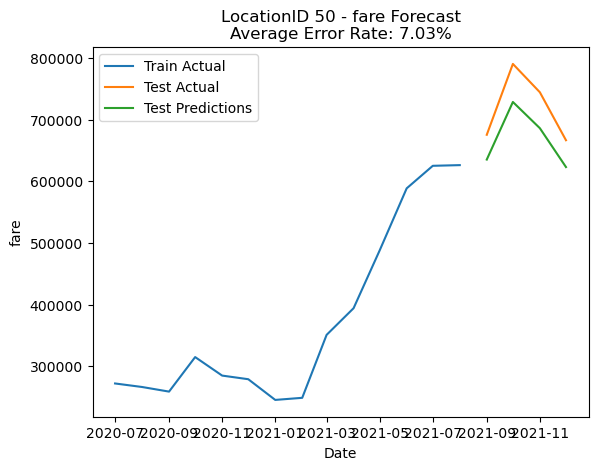

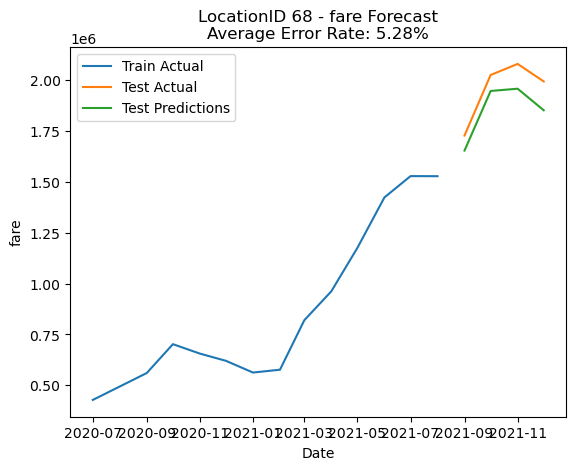

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


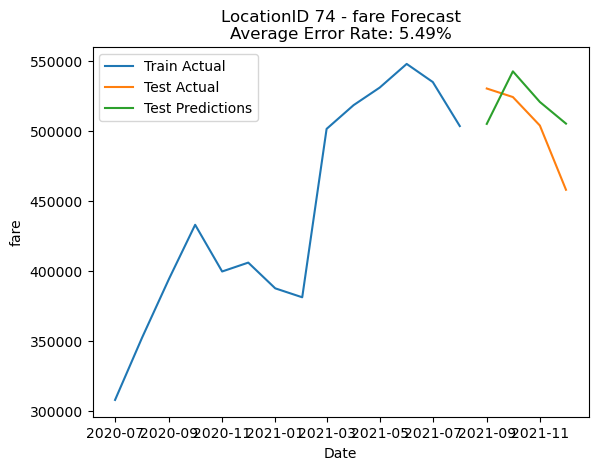

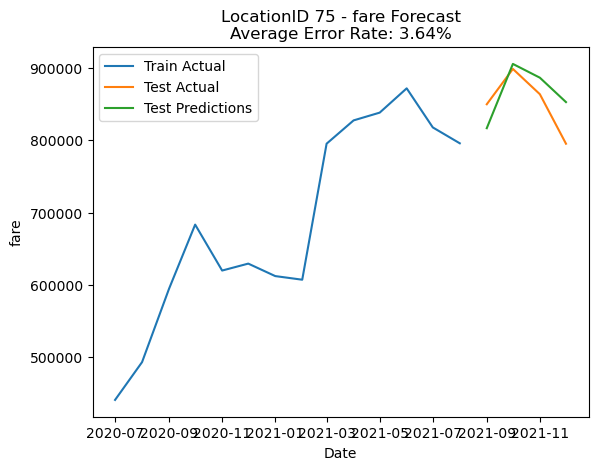

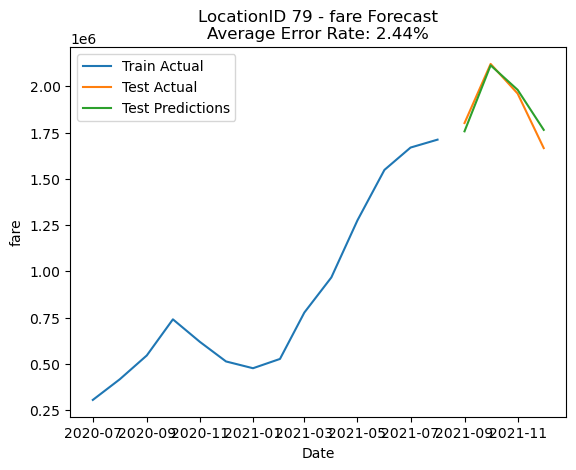

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


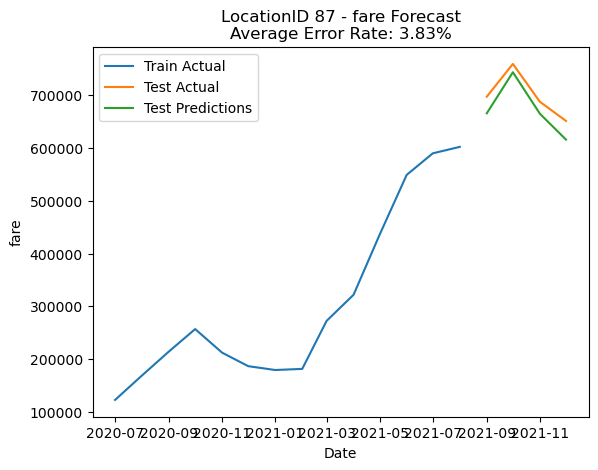

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


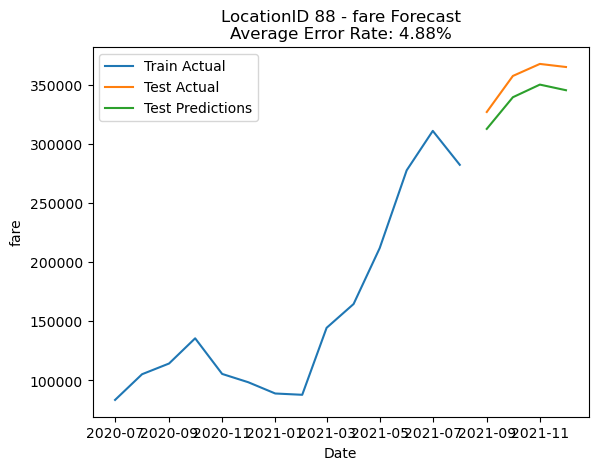

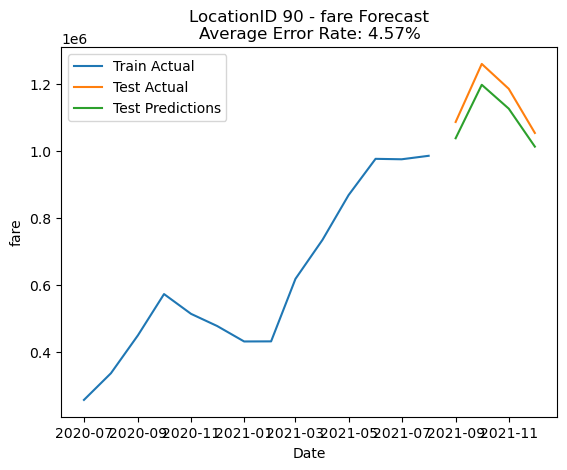

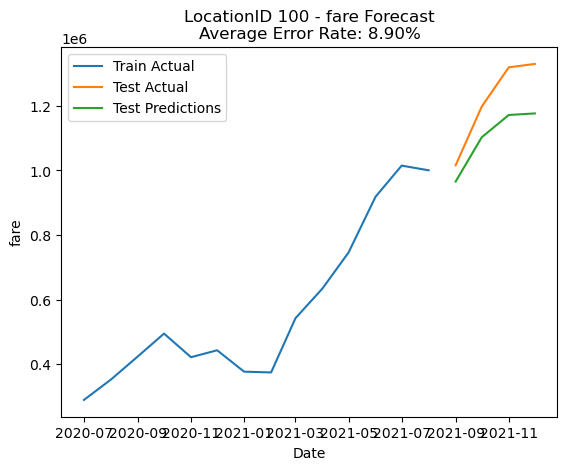

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


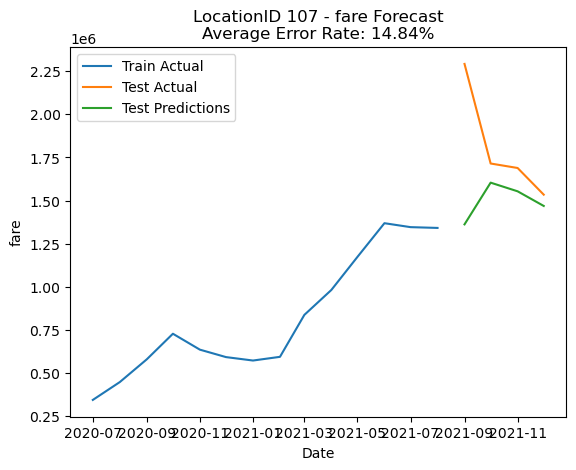

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


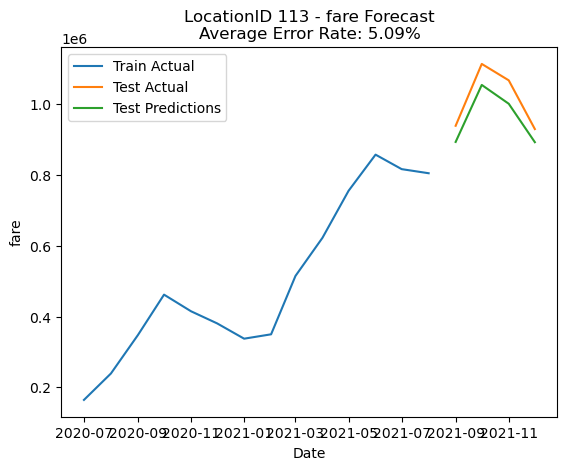

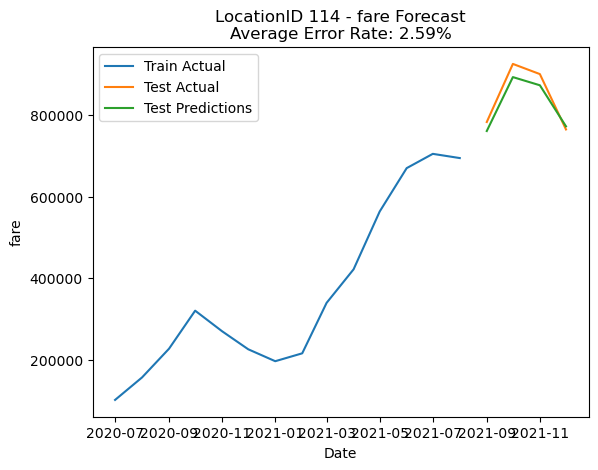

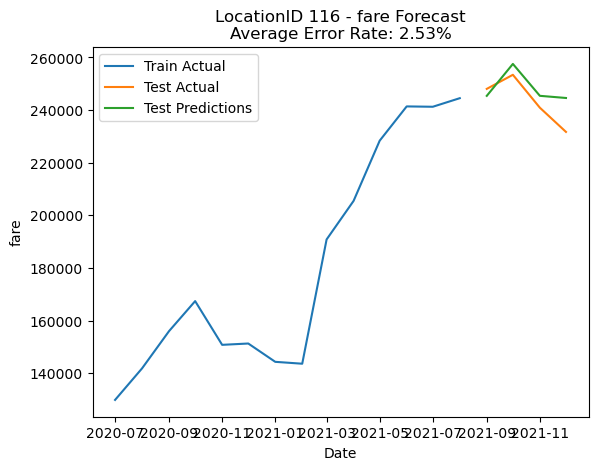

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


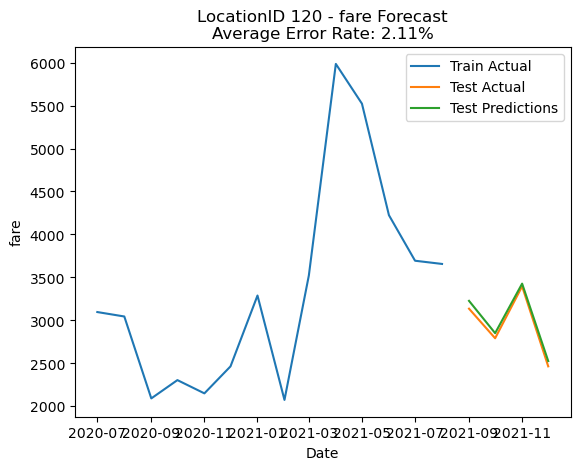

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


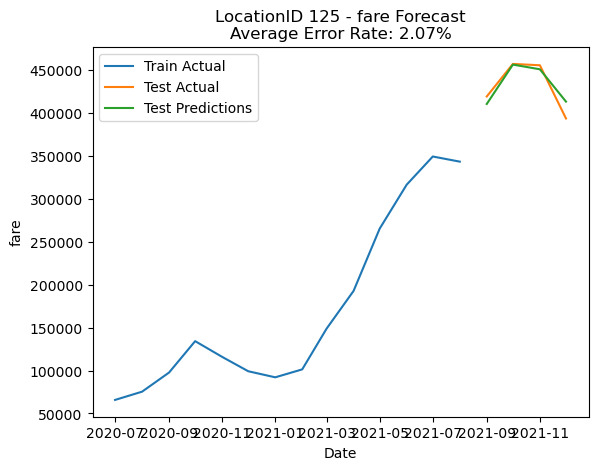

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


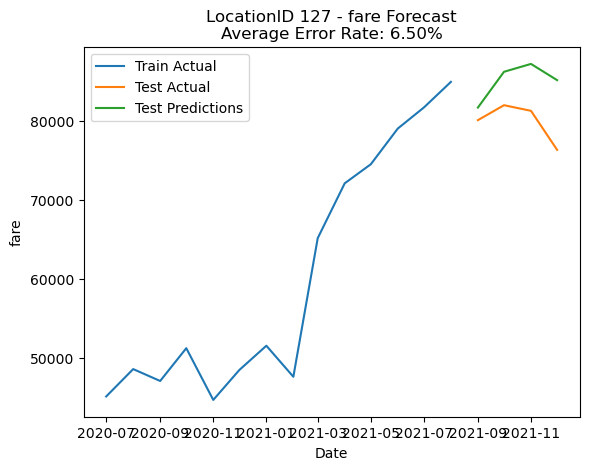

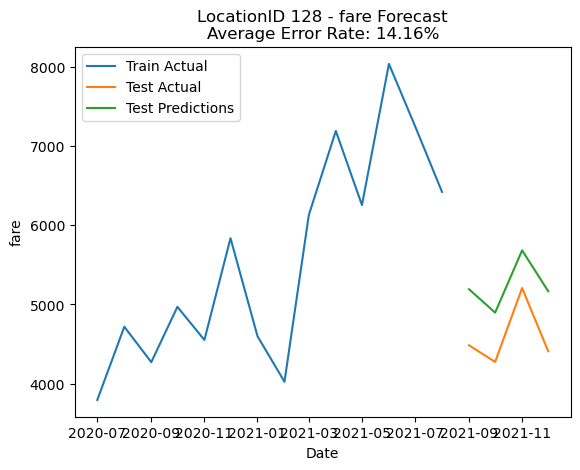

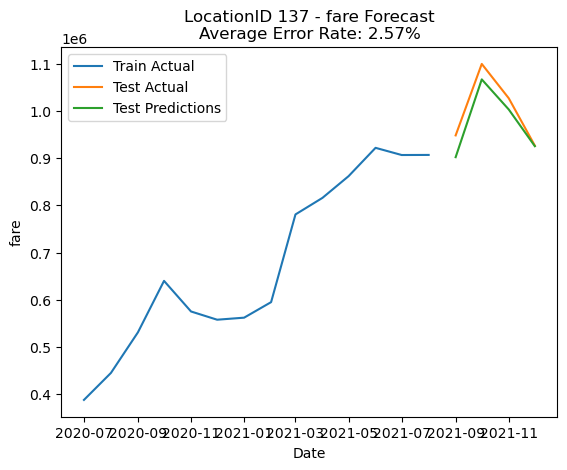

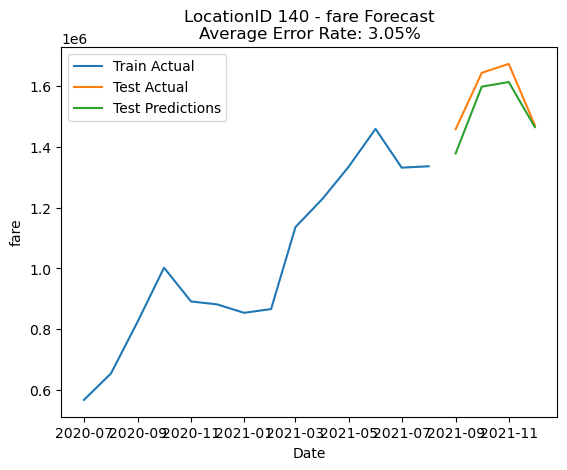

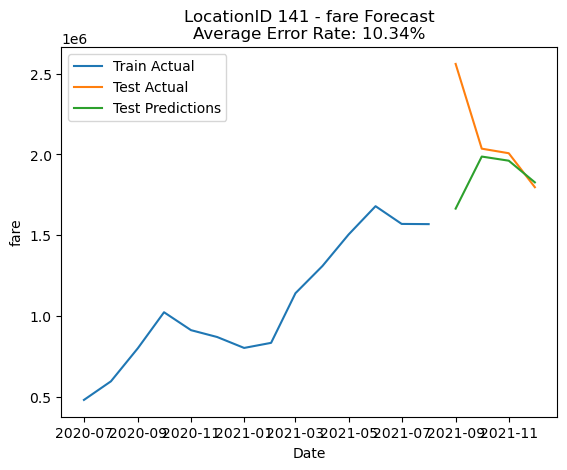

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


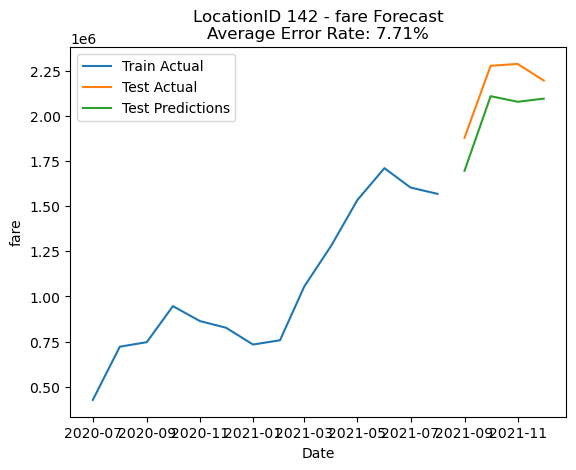

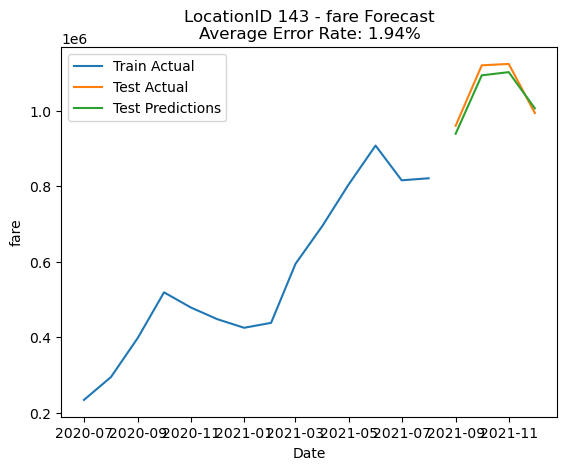

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


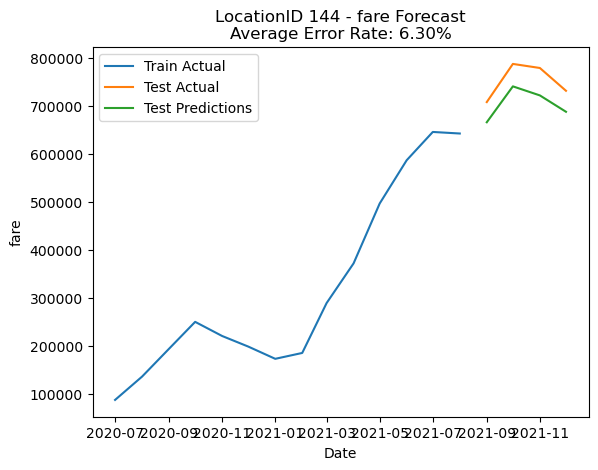

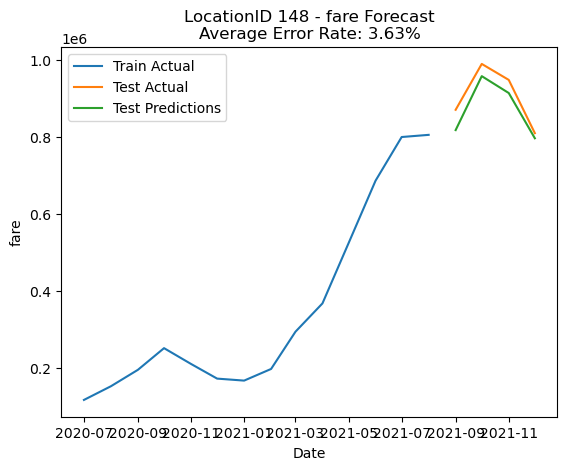

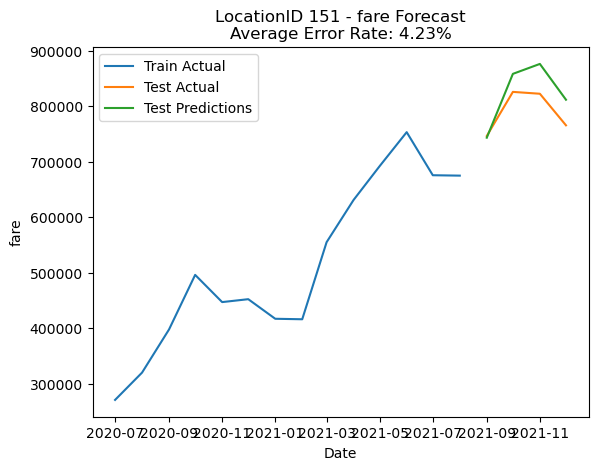

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


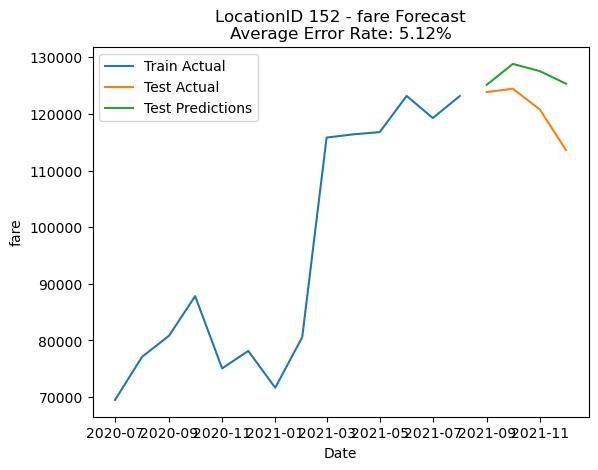

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


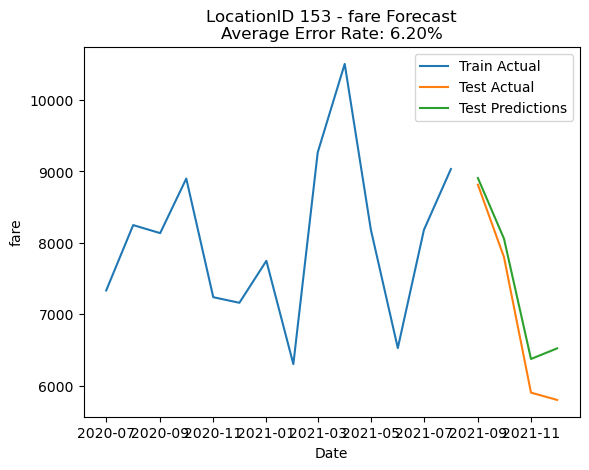

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


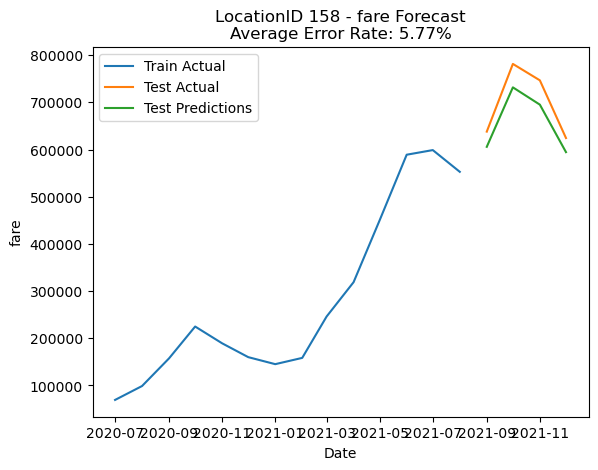

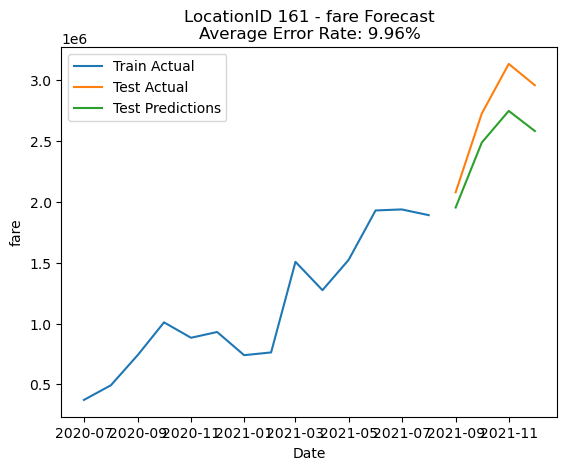

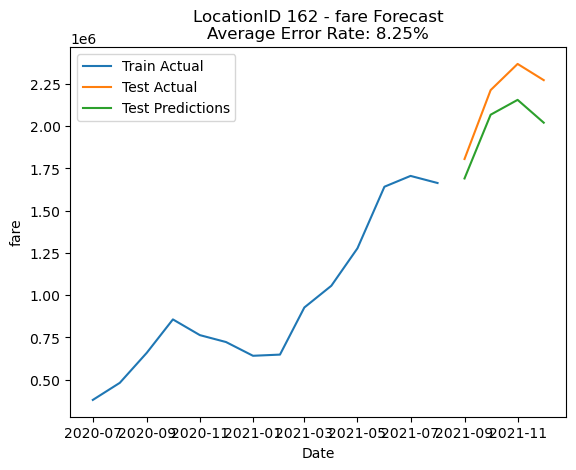

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


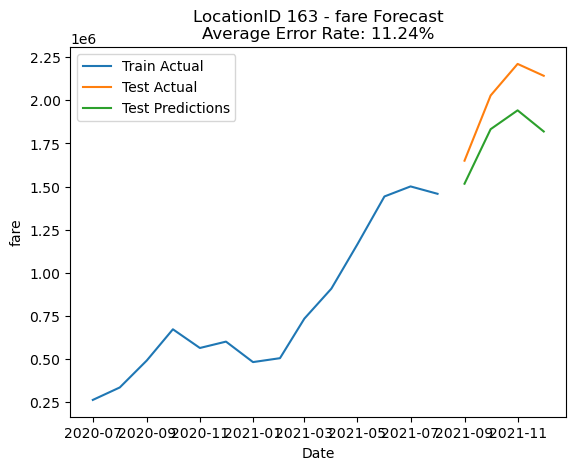

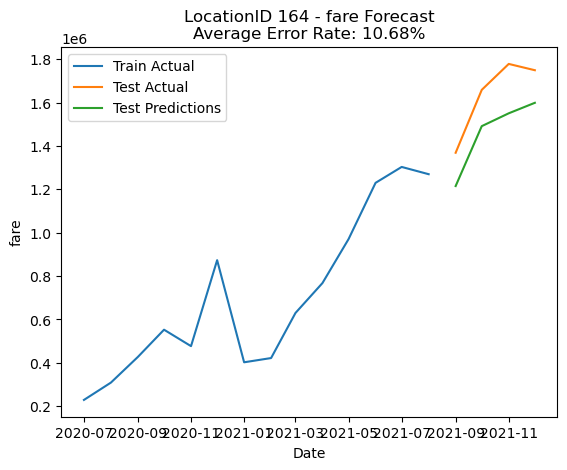

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


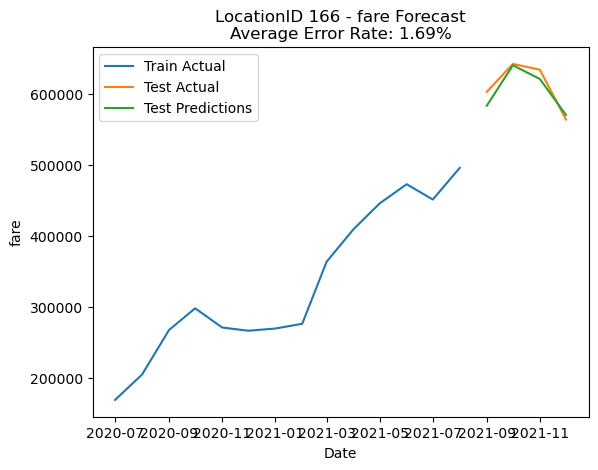

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


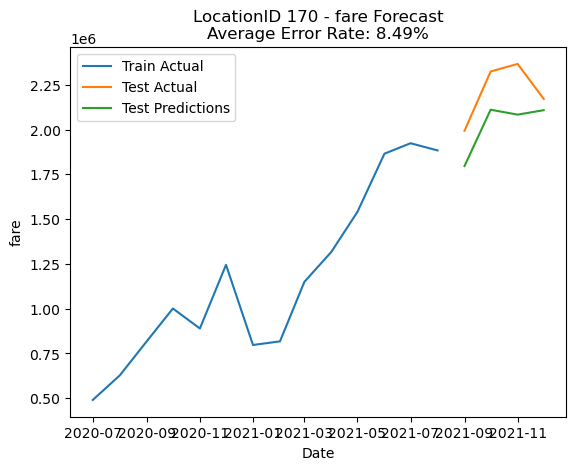

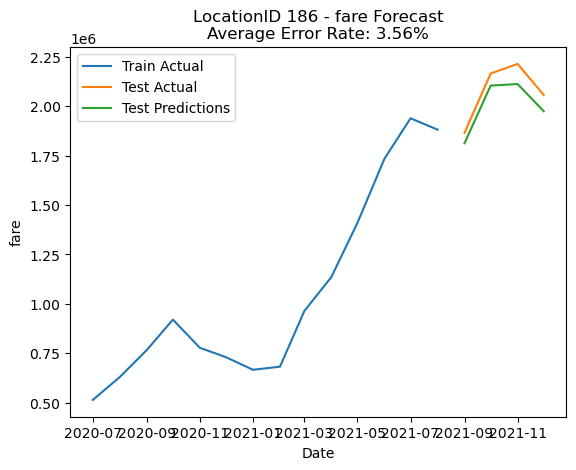

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


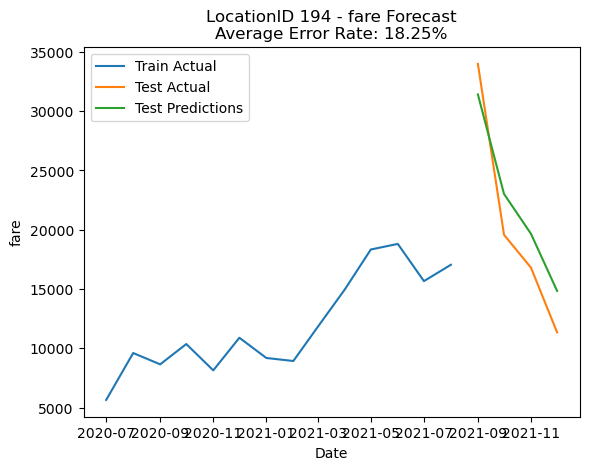

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


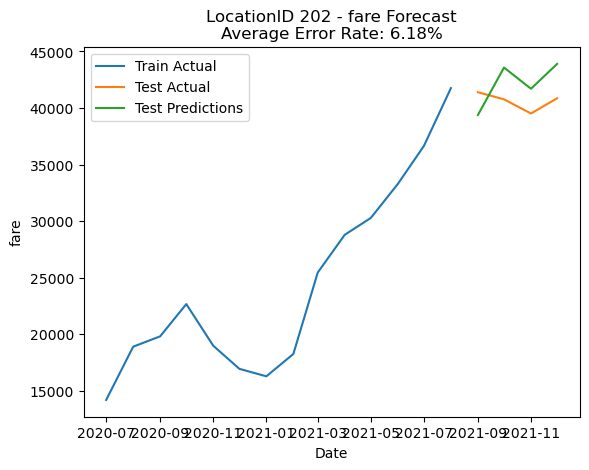

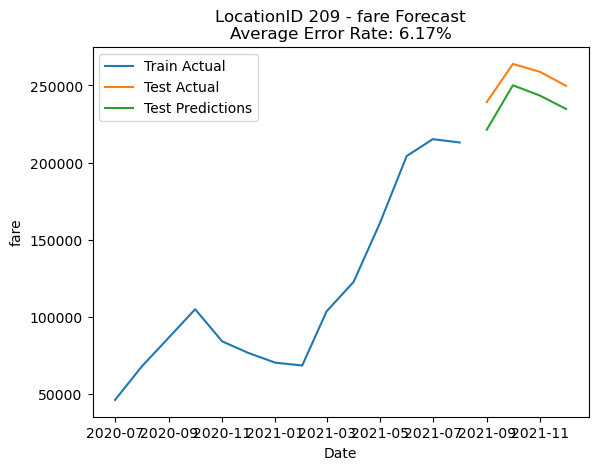

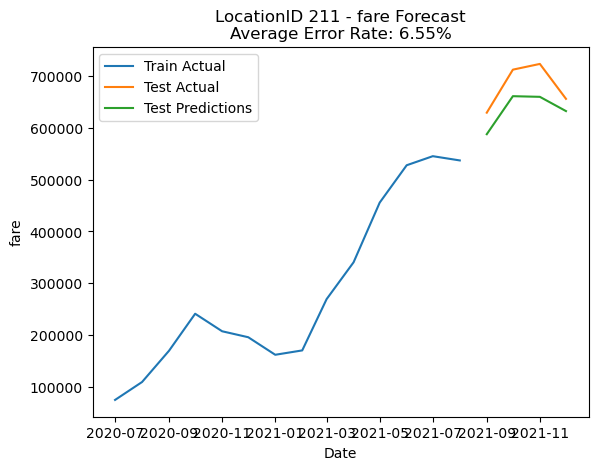

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


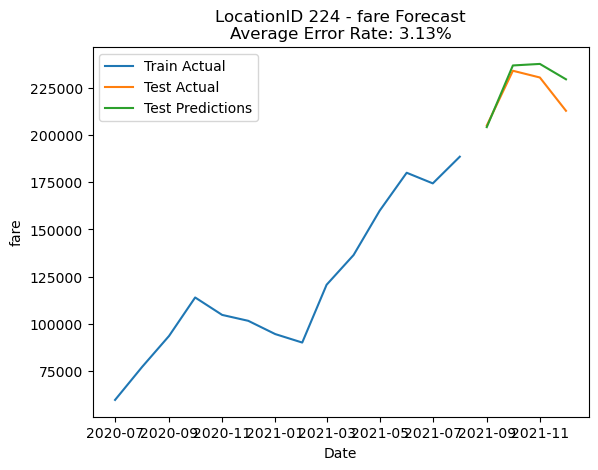

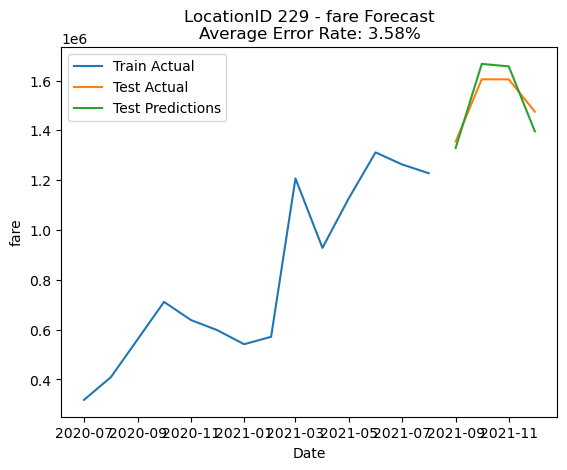

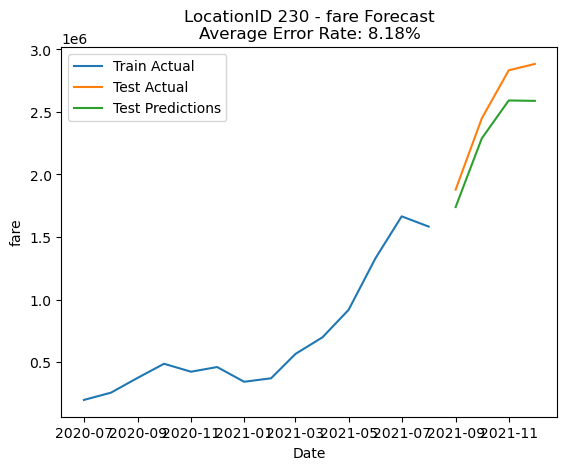

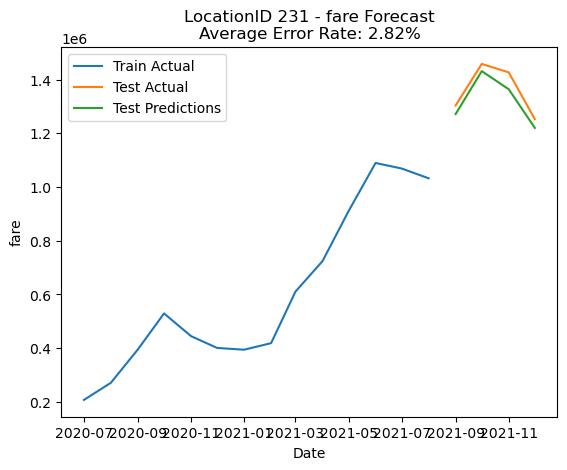

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


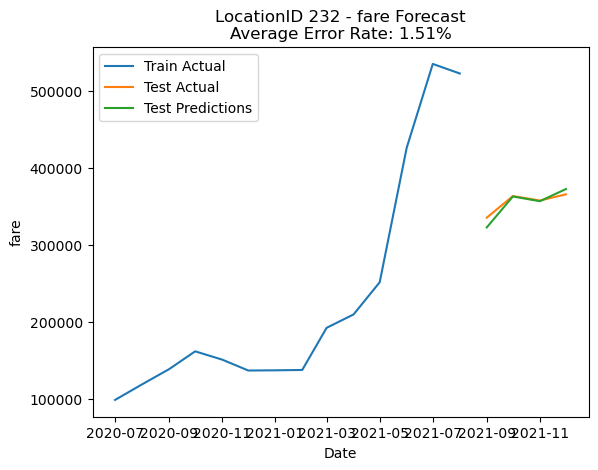

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


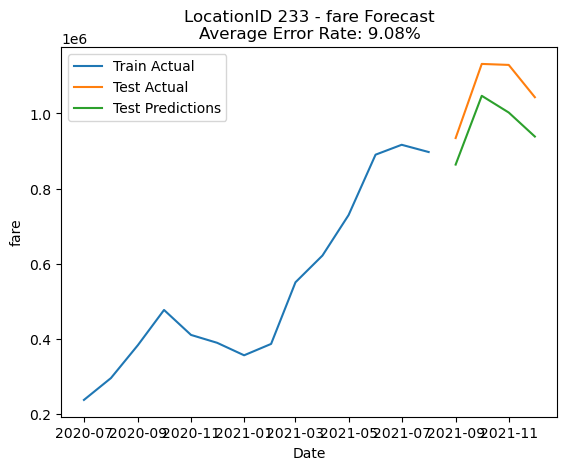

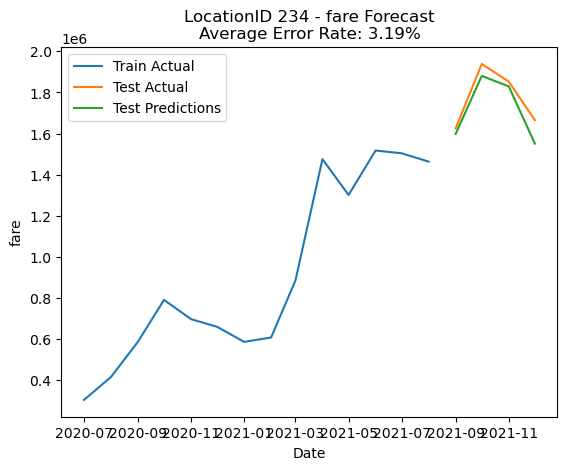

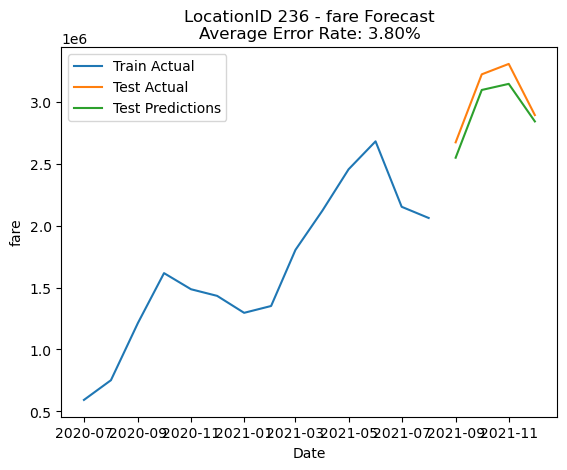

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


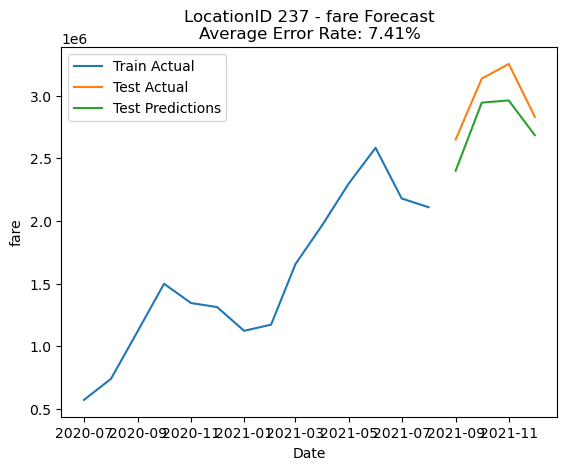

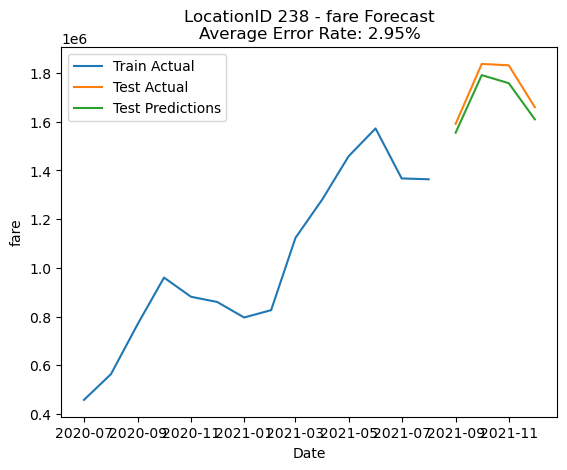

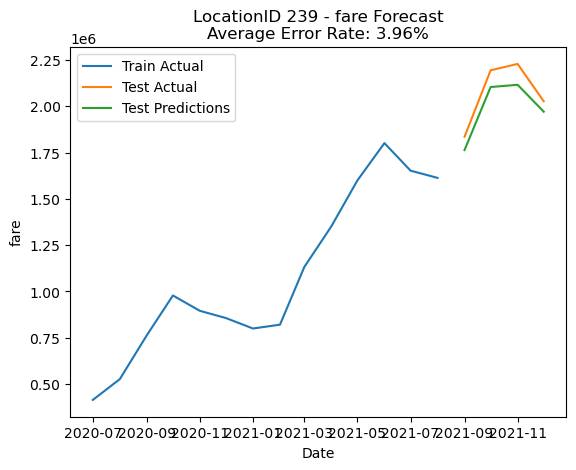

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


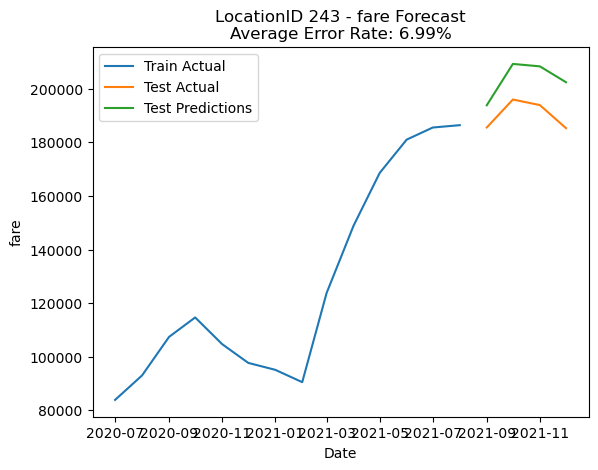

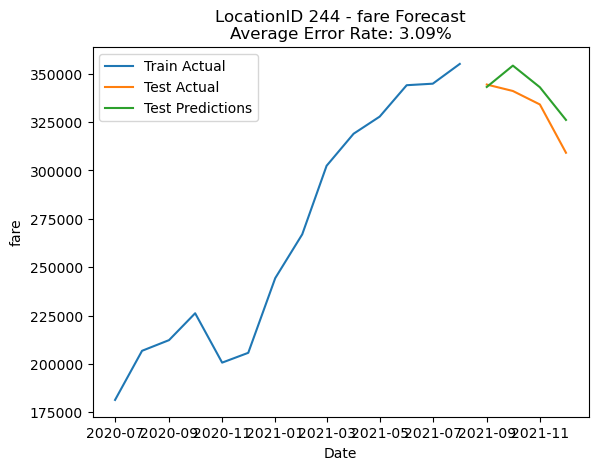

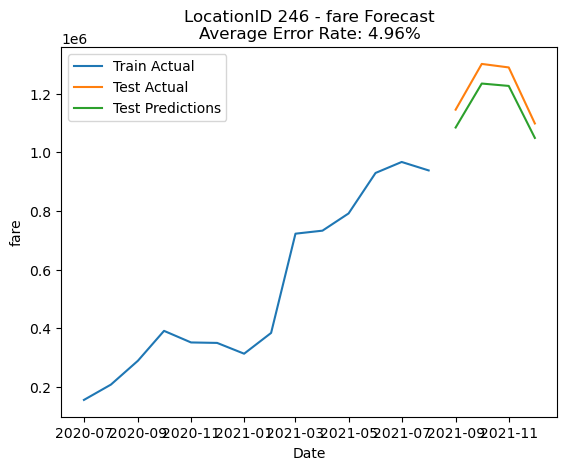

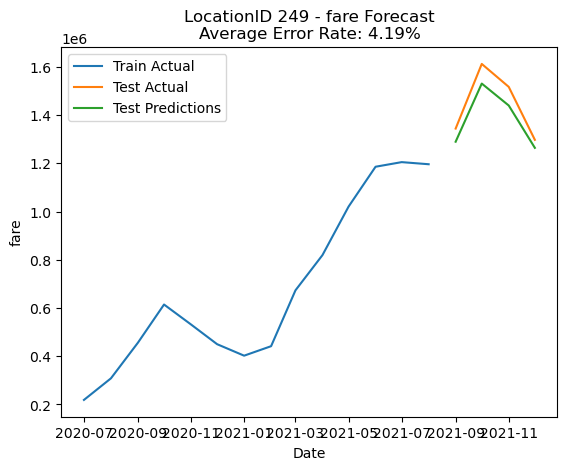

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


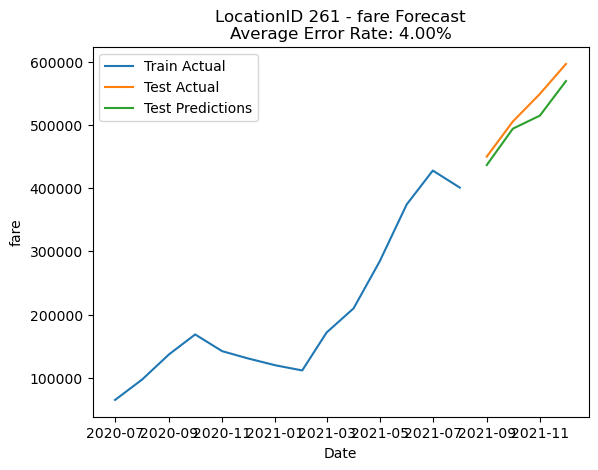

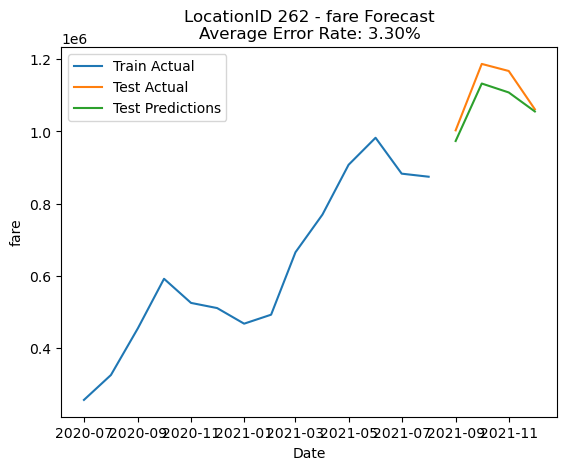

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


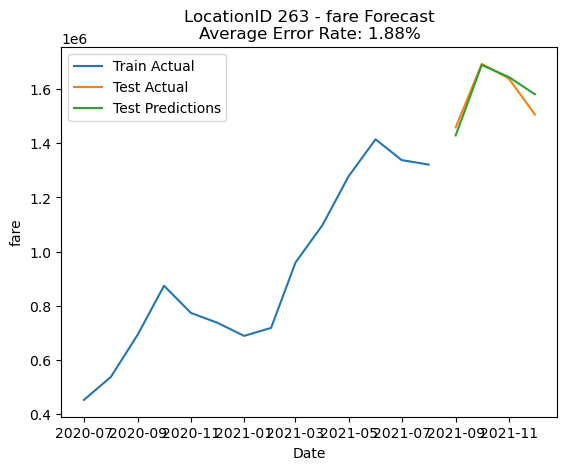

In [54]:
# Convert Date column to date time type
data['Date'] = pd.to_datetime(data['Date'])

values_to_delete = []

# Obtain a unique LocationID list
unique_location_ids = data['LocationID'].unique()

# Using the delete function from numpy to remove specific values.
updated_location_ids = np.delete(unique_location_ids, np.where(np.isin(unique_location_ids, values_to_delete)))

# Define ARIMA model parameters
order = (2, 1, 2)  # (AR order, difference order, MA order)

# Predict and plot data for each LocationID
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group = data[data['LocationID'] == location_id]

    # splitting the dataset into training and testing data
    train_size = int(len(group) * 0.8)
    train_data = group.iloc[:train_size]
    test_data = group.iloc[train_size:]

    # extracting training data and testing data
    train_Passenger = train_data['passenger'].values
    train_DOcount = train_data['DropOff_count'].values
    
    train_features = np.column_stack((train_Passenger, train_DOcount))
    train_target = train_data['fare'].values

    # To train an ARIMA
    model = ARIMA(train_target, exog=train_features, order=order)
    model_fit = model.fit()

    # To make predictions
    test_features = np.column_stack((test_data['passenger'].values, test_data['DropOff_count'].values))
    test_predictions_fare = model_fit.predict(start=train_size, end=len(group)-1, exog=test_features)

    # To calculate the error rate for the predictions
    error_rate = np.abs(test_predictions_fare - test_data['fare'].values) / test_data['fare'].values
    average_error_rate = np.mean(error_rate)
    

    # Draw Line chart
    plt.plot(train_data['Date'], train_target, label='Train Actual')
    plt.plot(test_data['Date'], test_data['fare'].values, label='Test Actual')
    plt.plot(test_data['Date'], test_predictions_fare, label='Test Predictions')
    plt.xlabel('Date')
    plt.ylabel('fare')
    plt.title(f'LocationID {location_id} - fare Forecast\nAverage Error Rate: {average_error_rate:.2%}')
    plt.legend()
    plt.show()



In [55]:

values_to_delete = []

# Obtain a unique LocationID list
unique_location_ids = data['LocationID'].unique()

# Using the delete function from numpy to remove specific values.
updated_location_ids = np.delete(unique_location_ids, np.where(np.isin(unique_location_ids, values_to_delete)))

# Define ARIMA model parameters
order = (2, 1, 2)  # (AR order, difference order, MA order)

# Create an empty model dictionary
fare_dict = {}

# Predict and plot data for each LocationID
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group = data[data['LocationID'] == location_id]

    # extracting training data
    train_Passenger = train_data['passenger'].values
    train_DOcount = train_data['DropOff_count'].values
    
    train_features = np.column_stack((train_Passenger, train_DOcount))
    train_target = train_data['fare'].values

    # To train an ARIMA
    model = ARIMA(train_target, exog=train_features, order=order)
    model_fit = model.fit()
    
    # To add the model to a dictionary.
    fare_dict[location_id] = model_fit



/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packag

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packag

- prediction model of DO_passenger

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


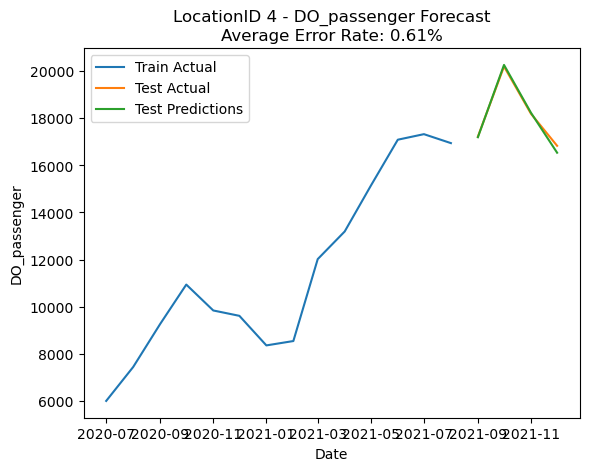

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


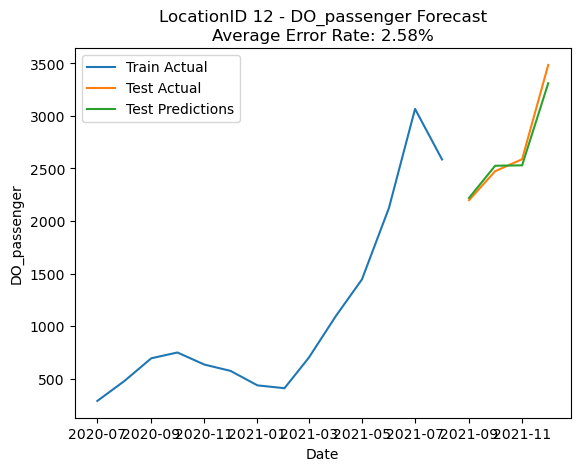

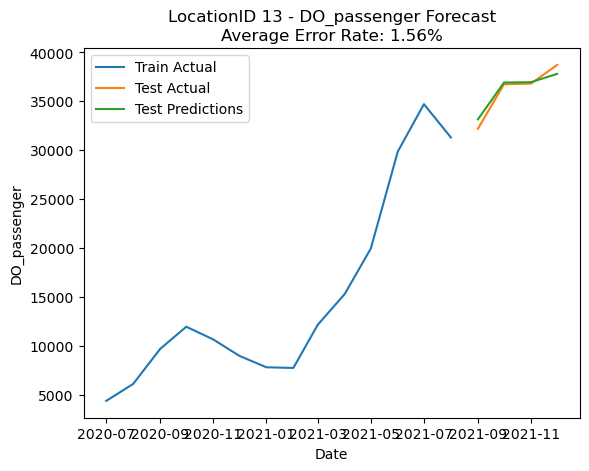

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


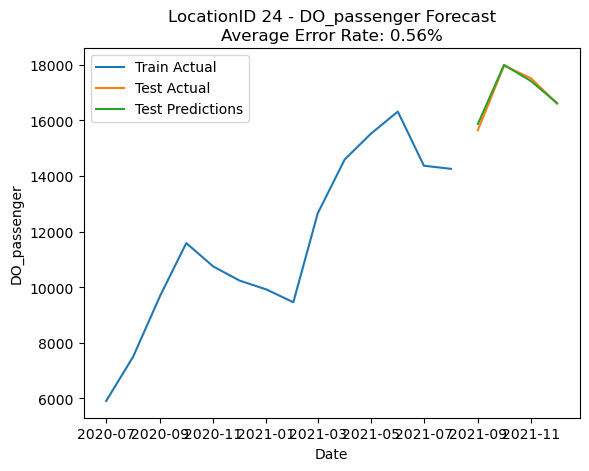

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


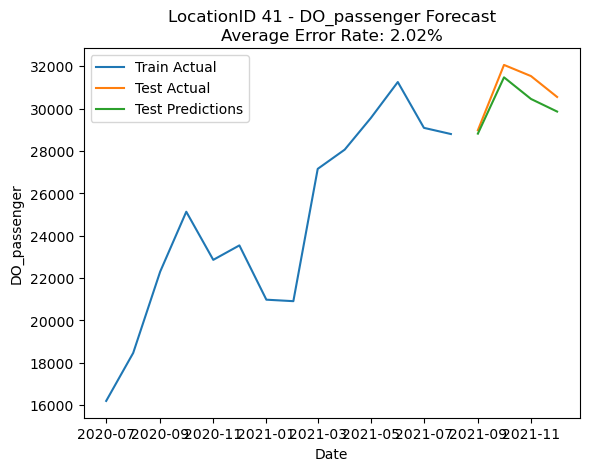

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


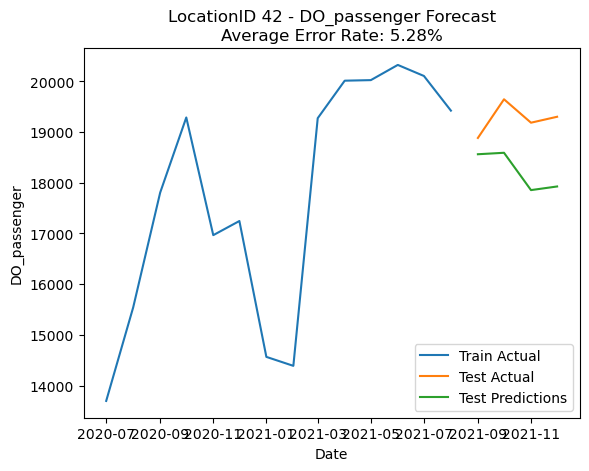

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


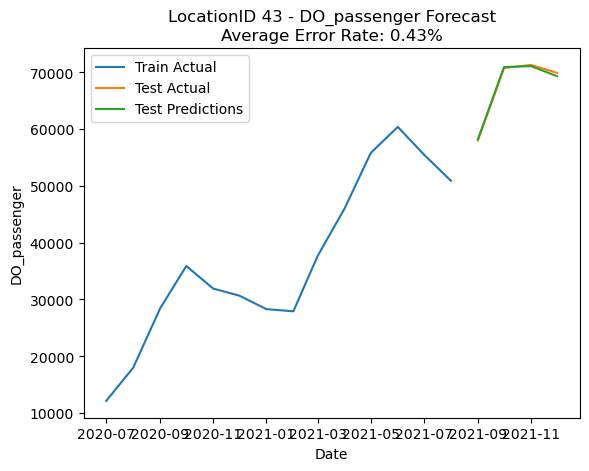

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


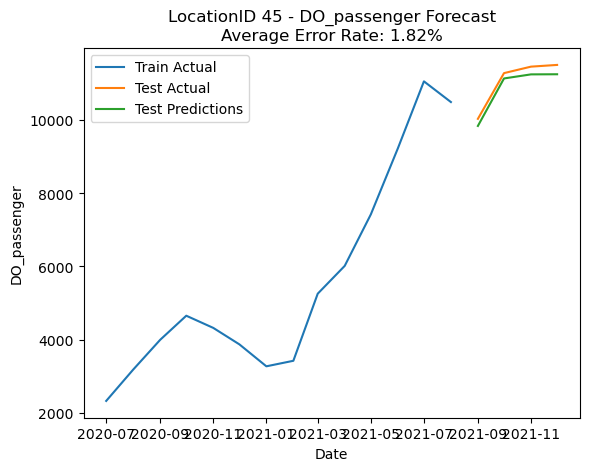

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


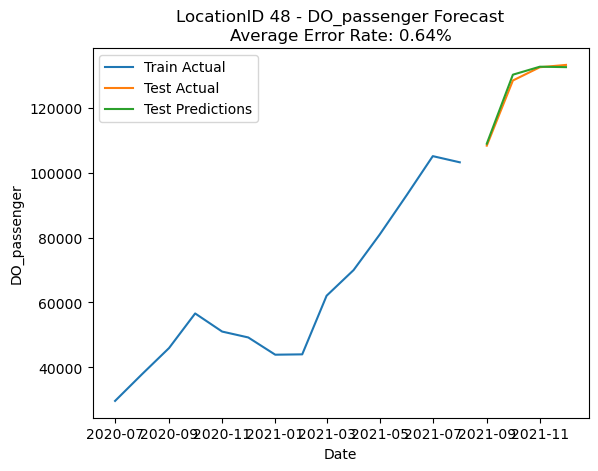

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


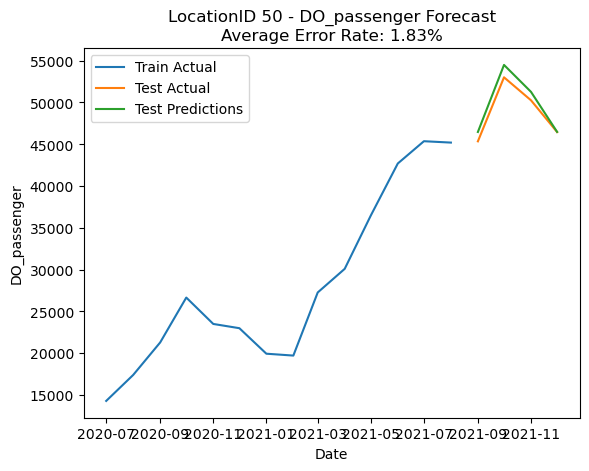

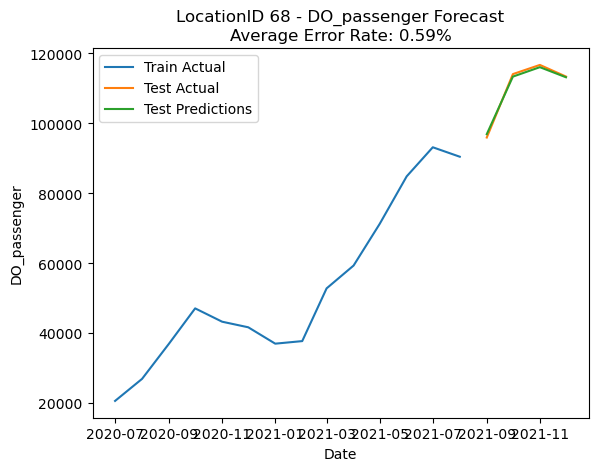

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


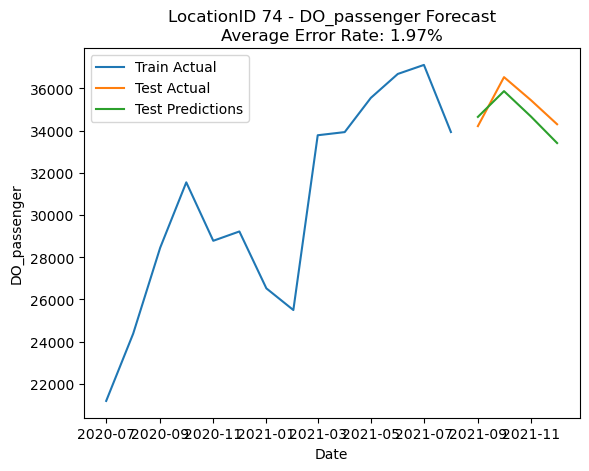

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


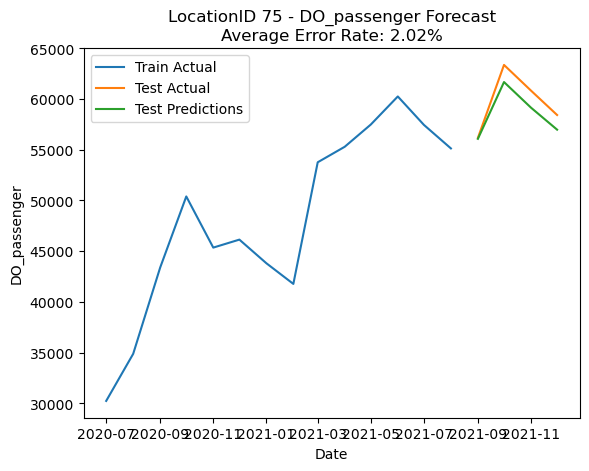

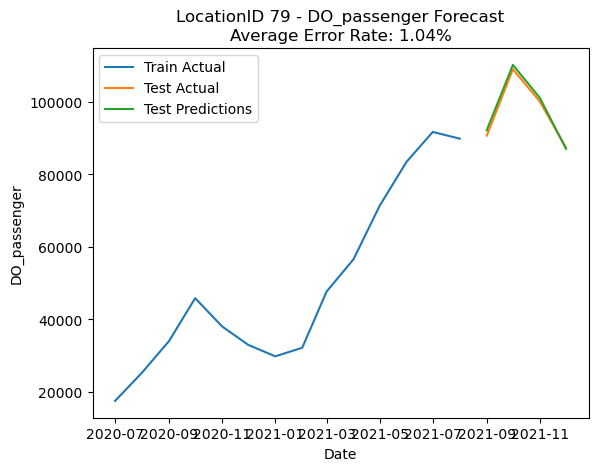

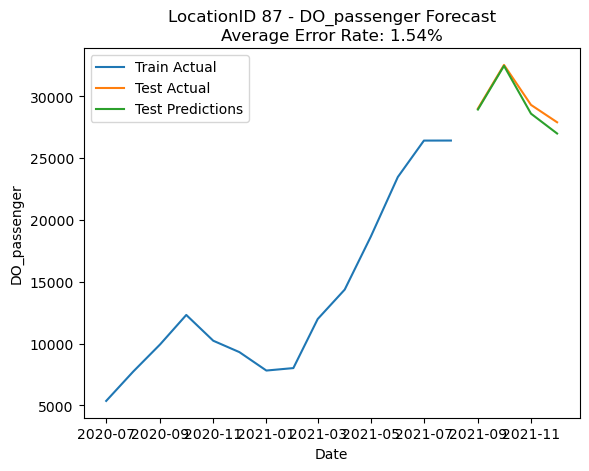

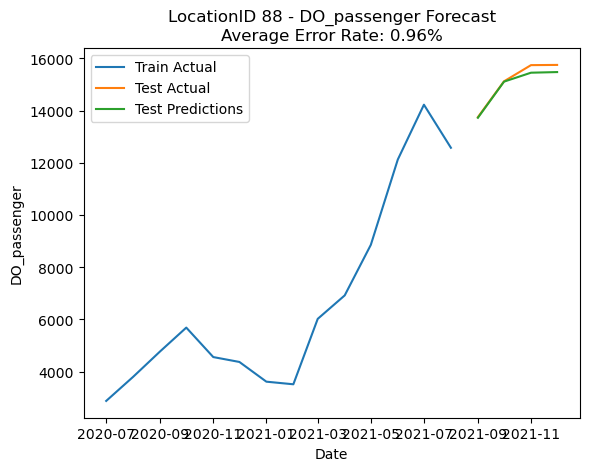

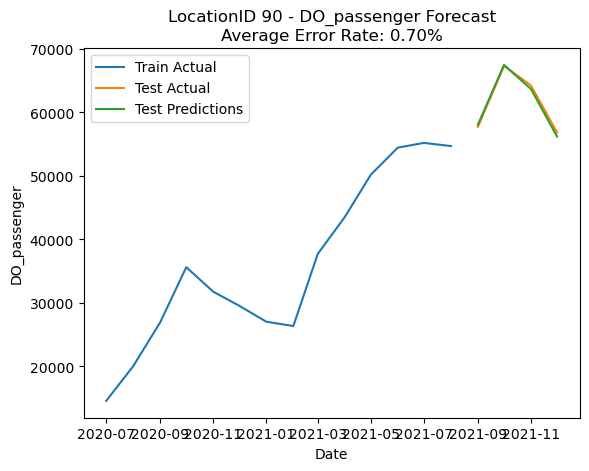

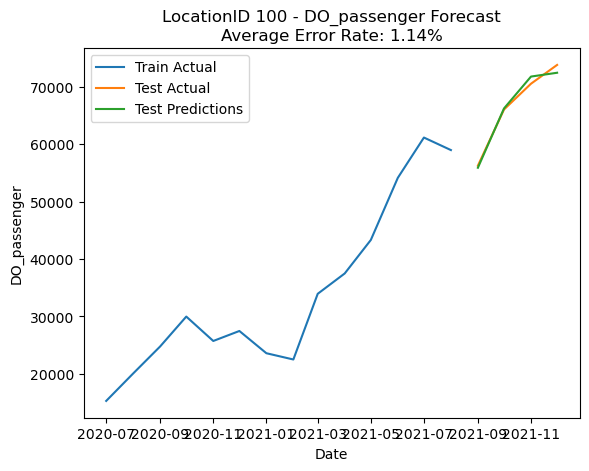

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


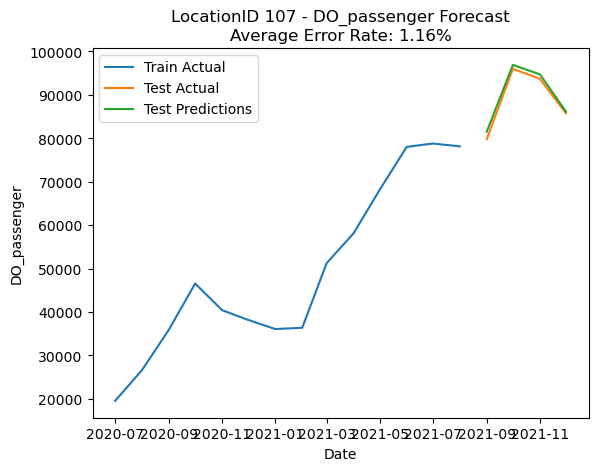

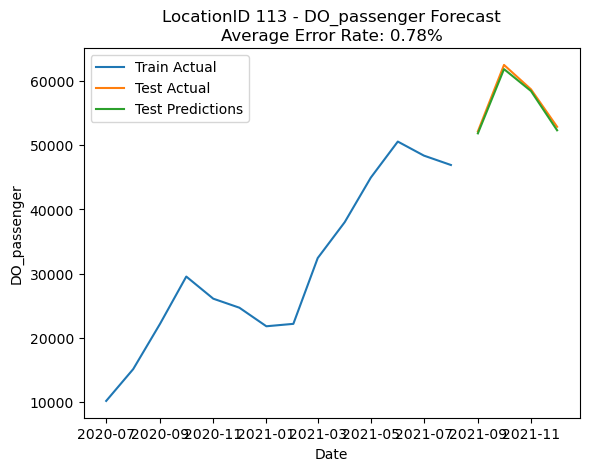

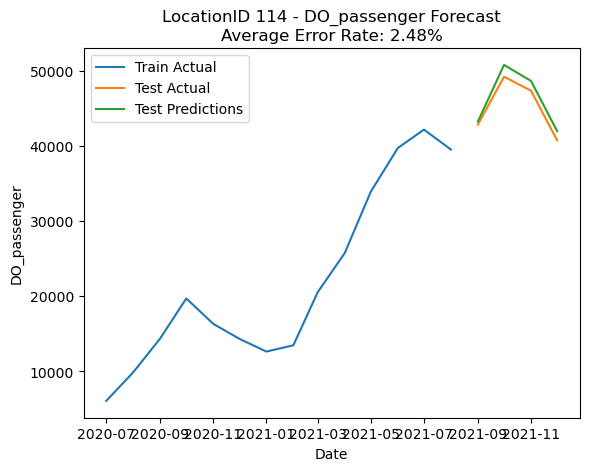

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


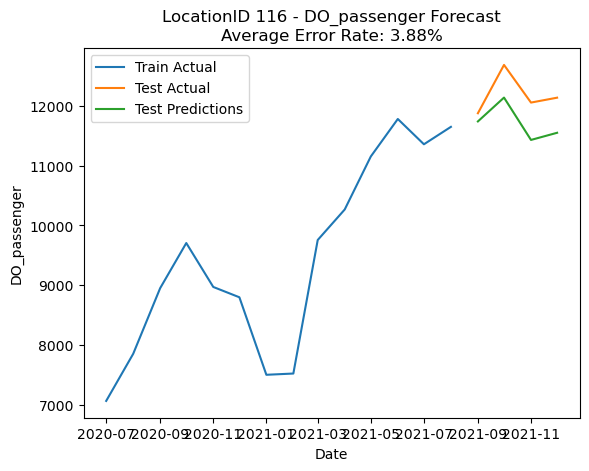

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


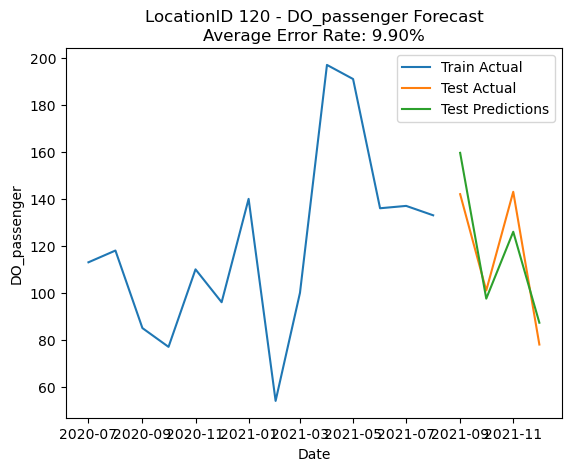

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


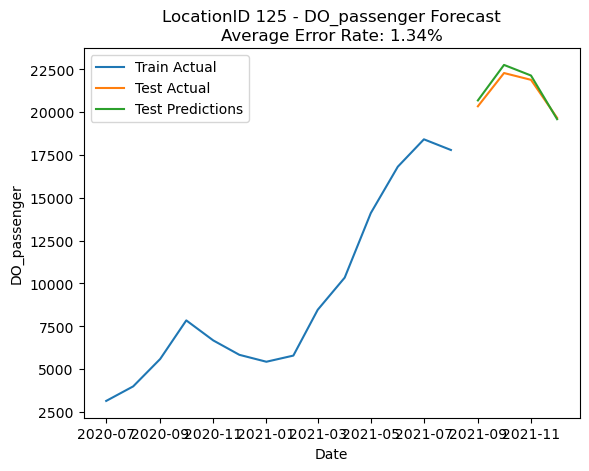

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


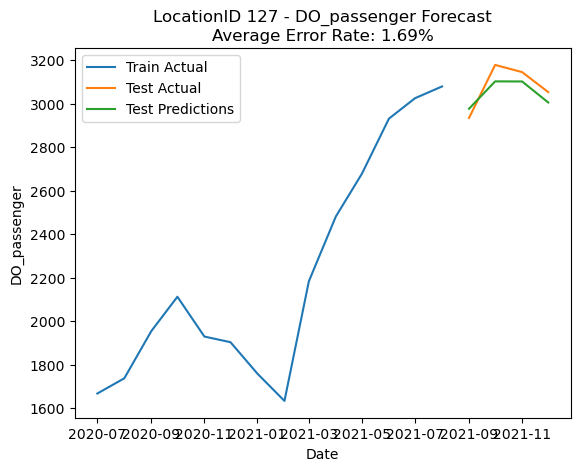

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


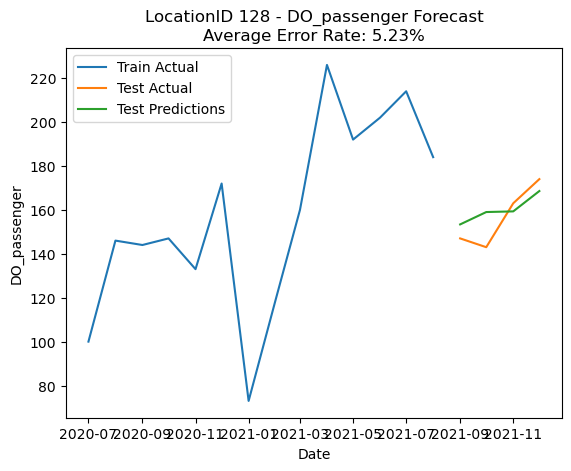

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


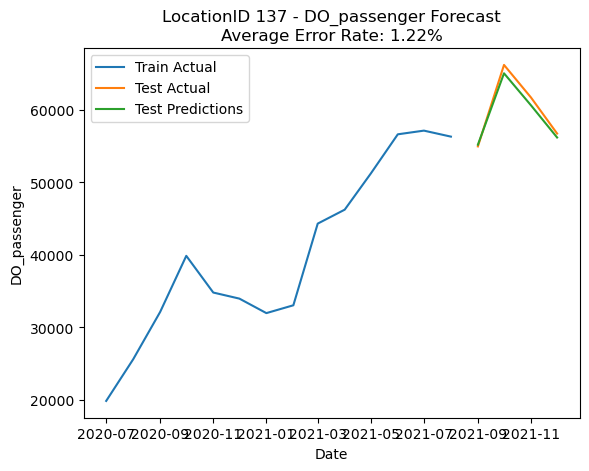

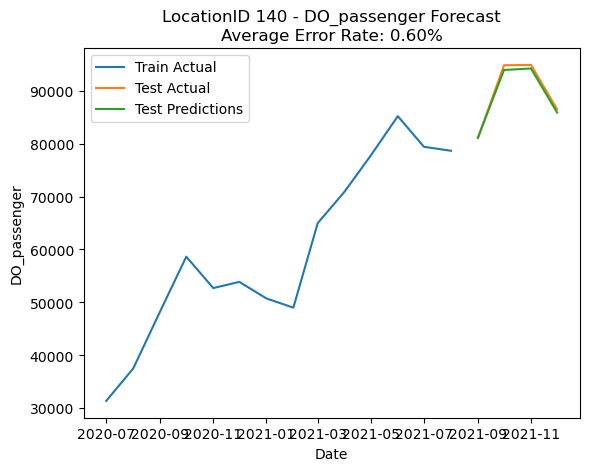

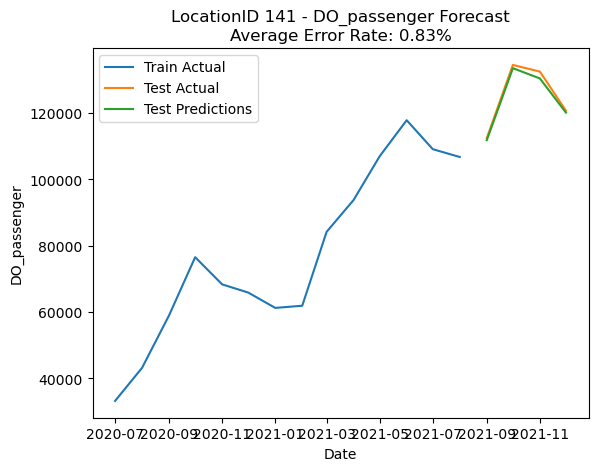

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


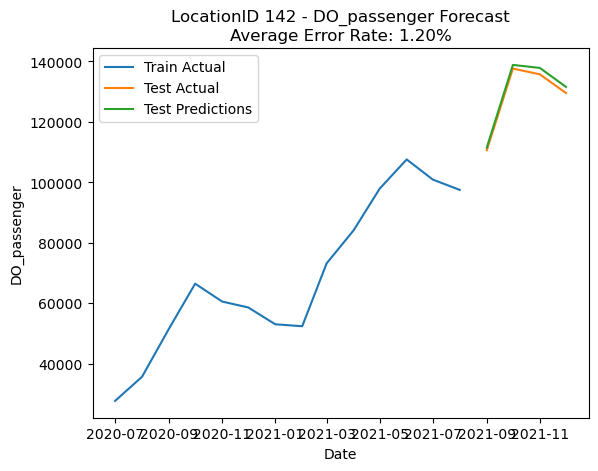

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


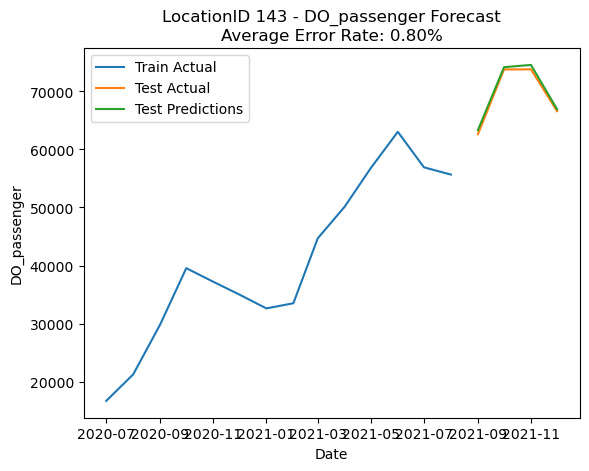

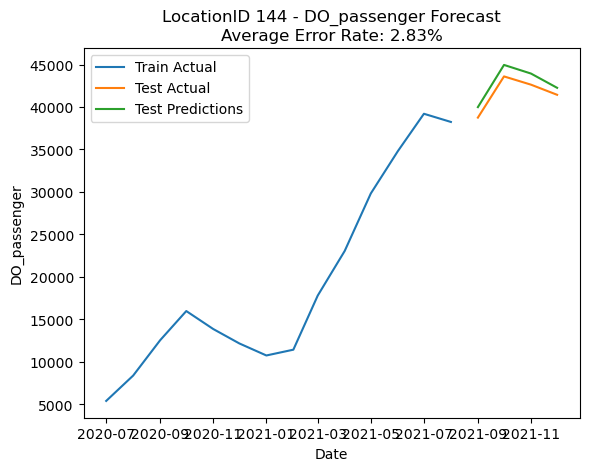

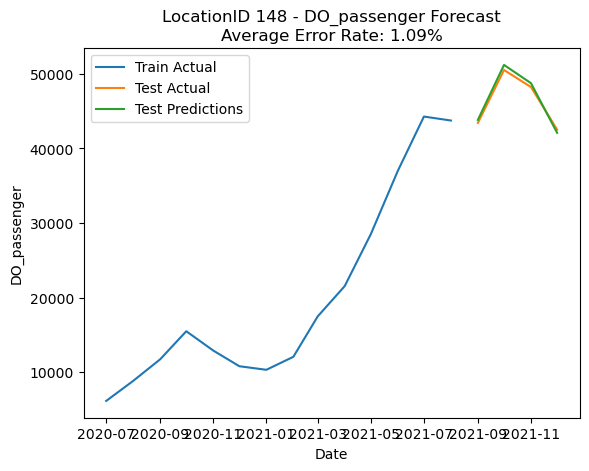

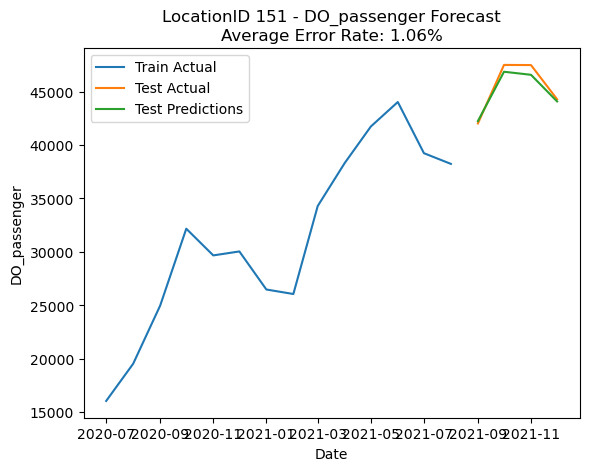

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


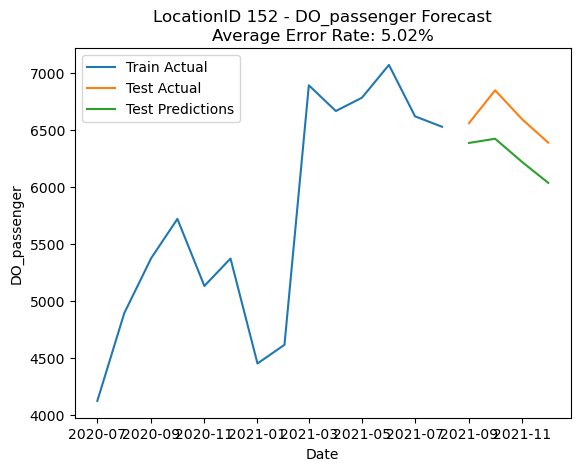

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


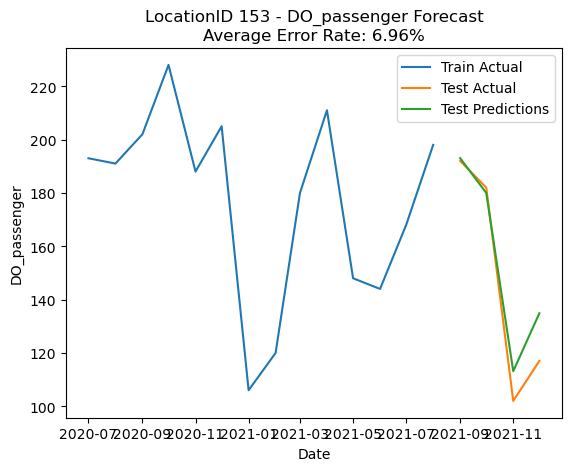

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


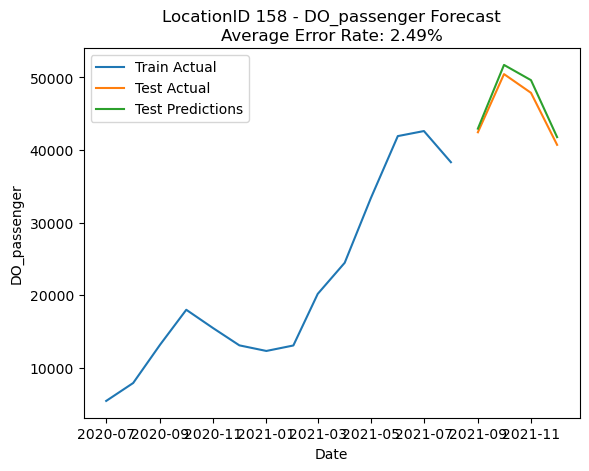

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


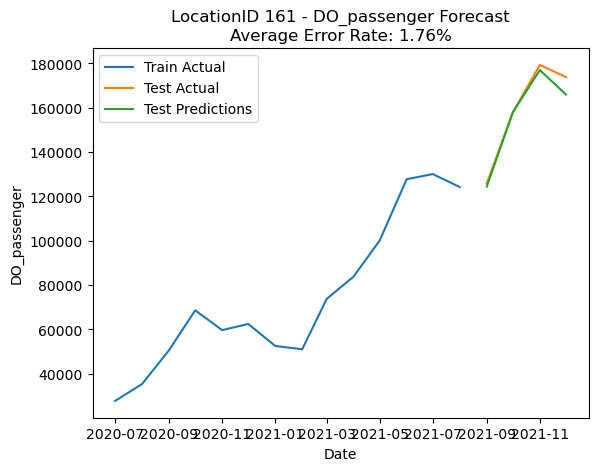

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


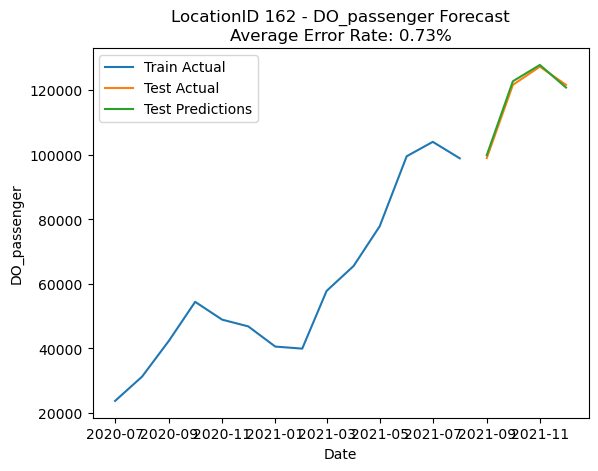

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


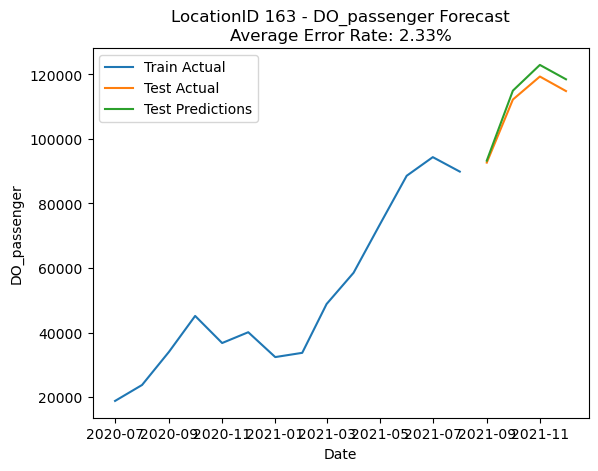

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


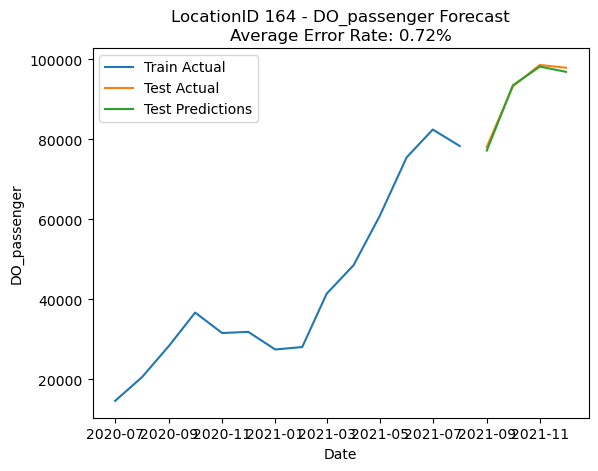

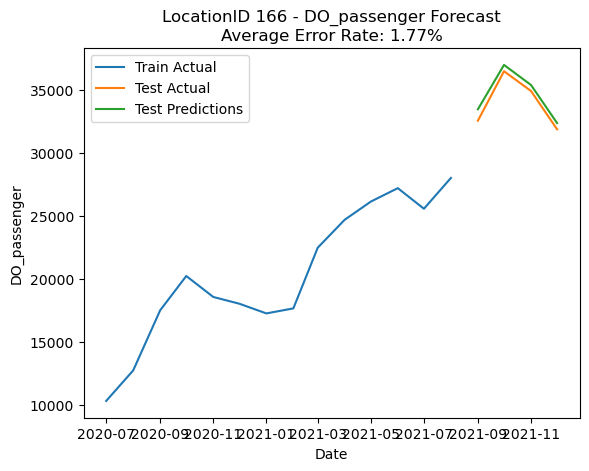

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


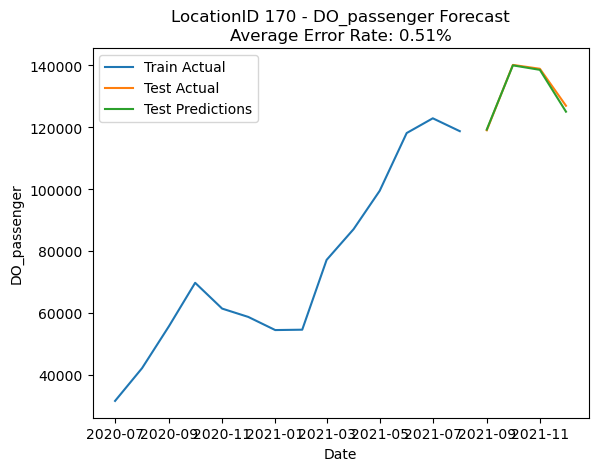

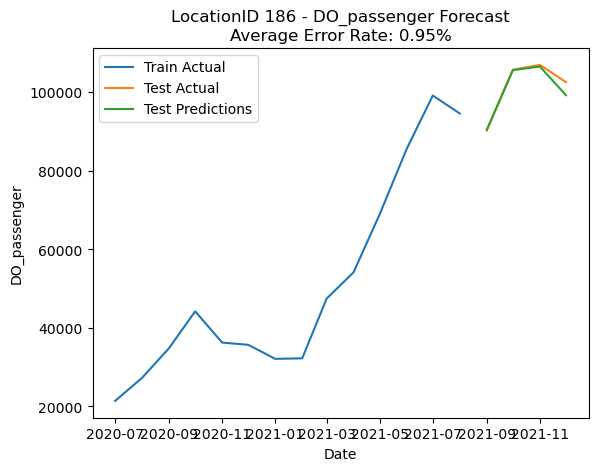

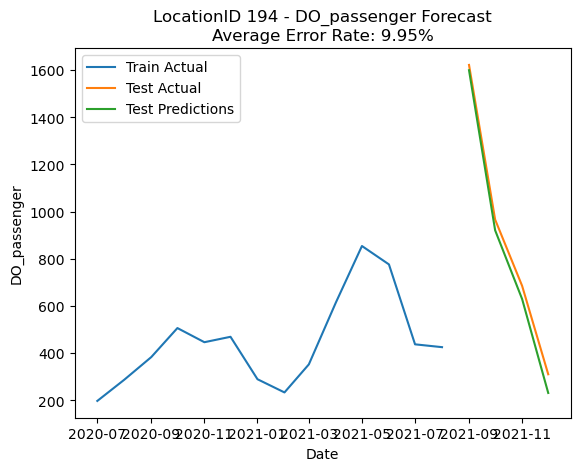

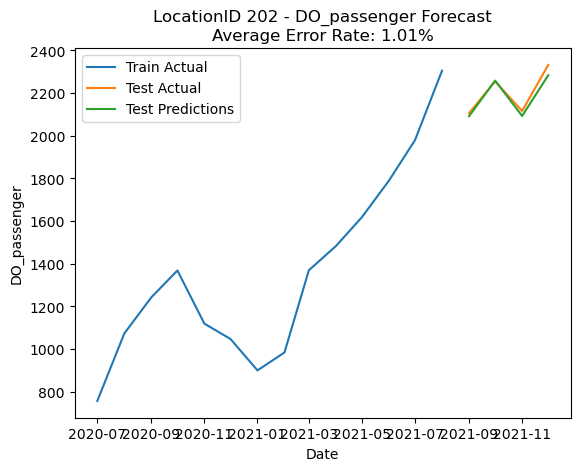

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


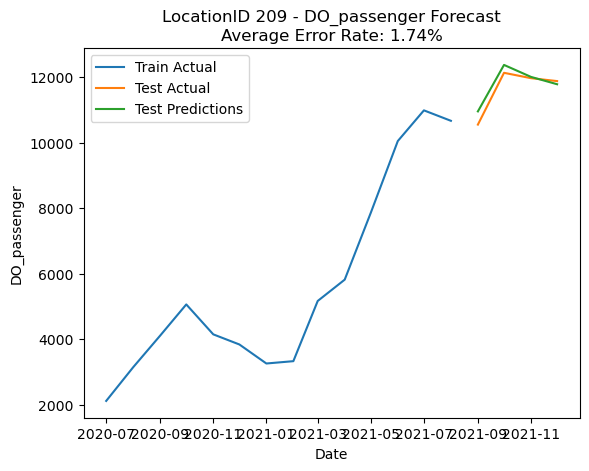

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


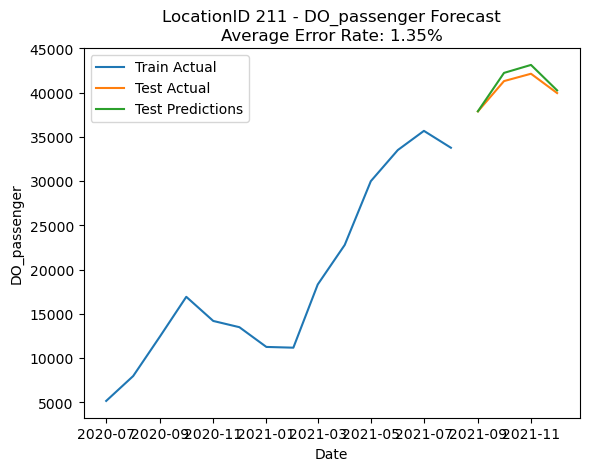

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


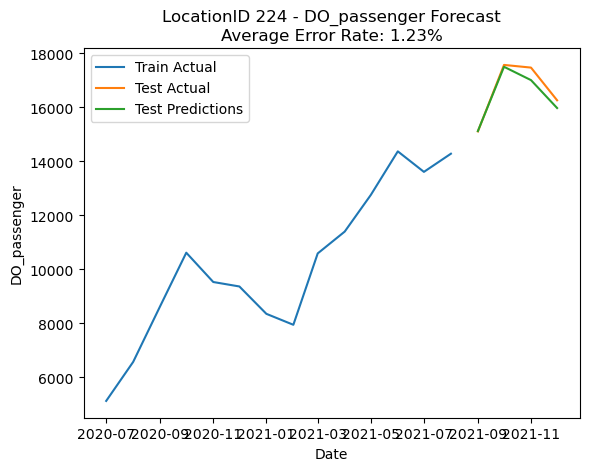

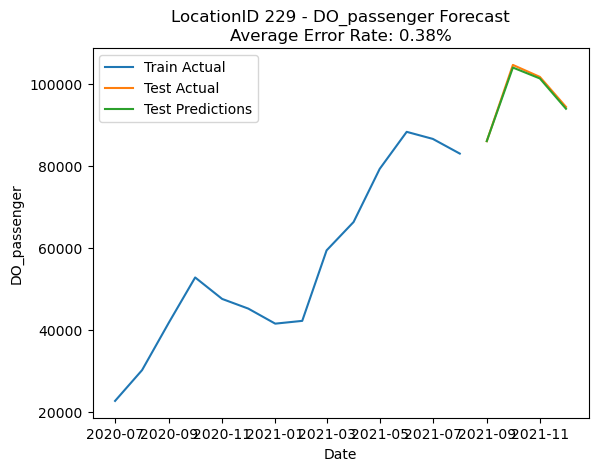

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


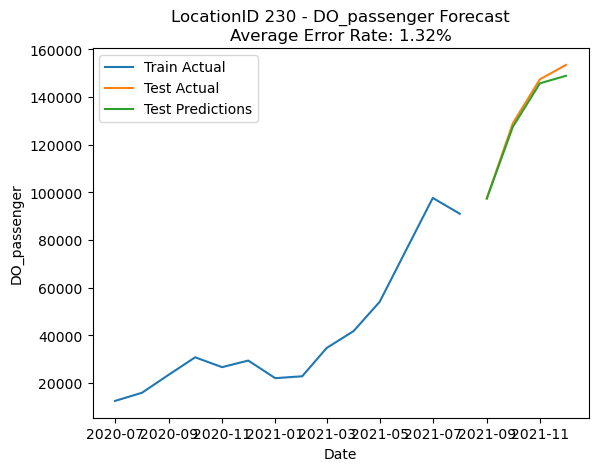

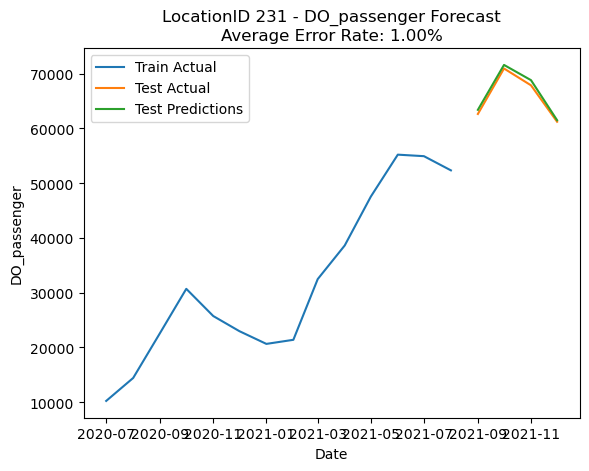

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


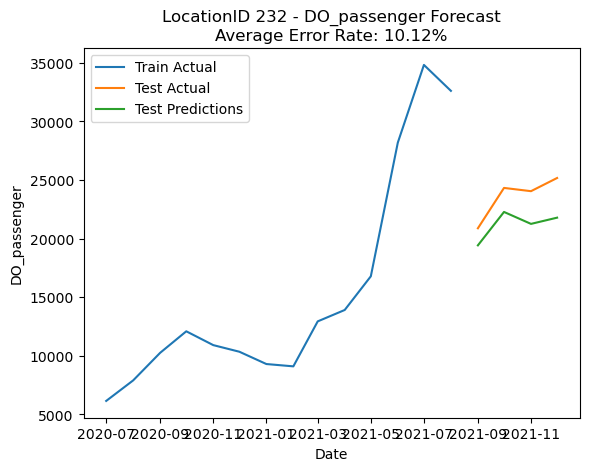

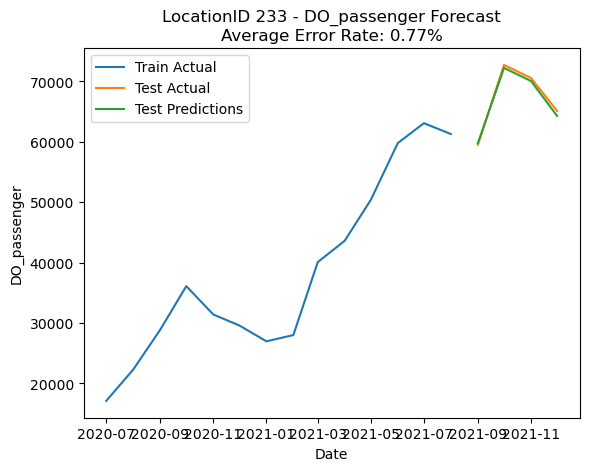

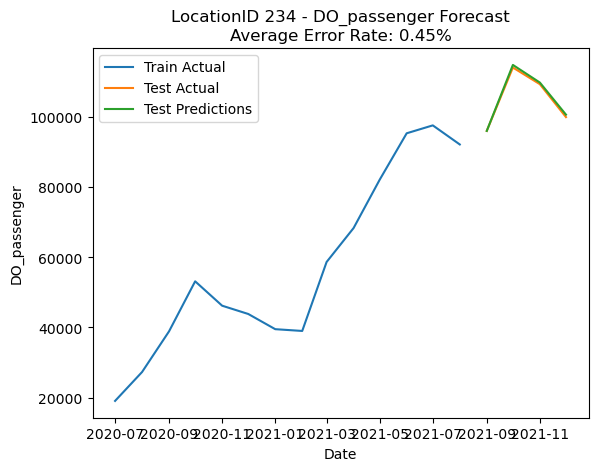

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


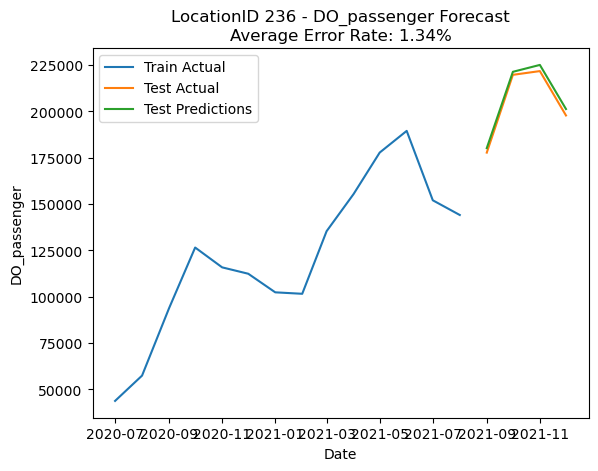

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


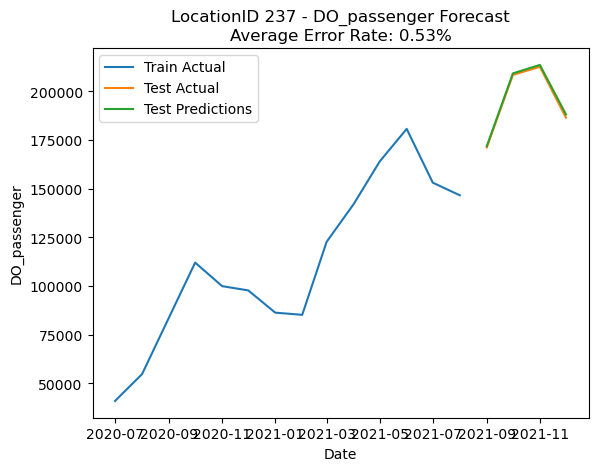

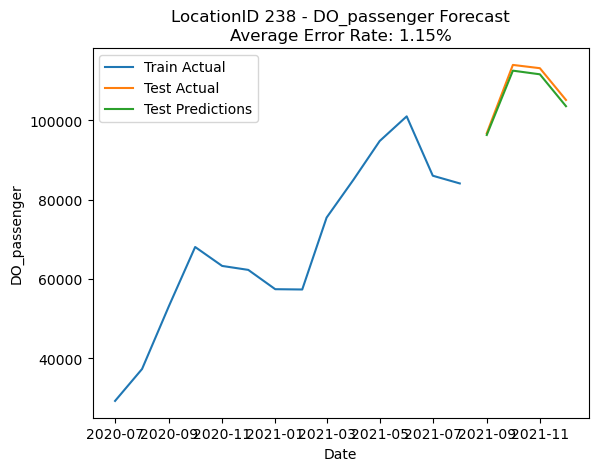

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


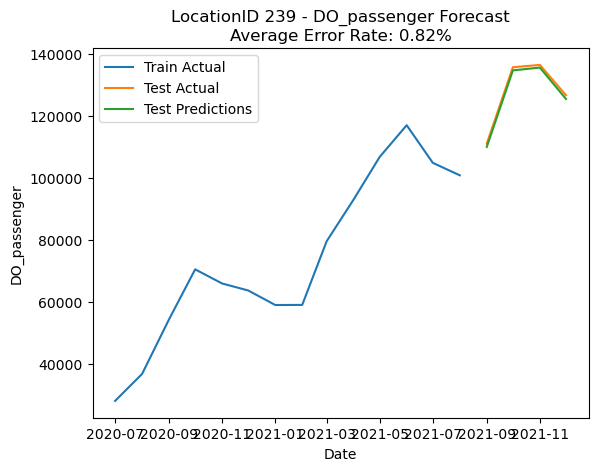

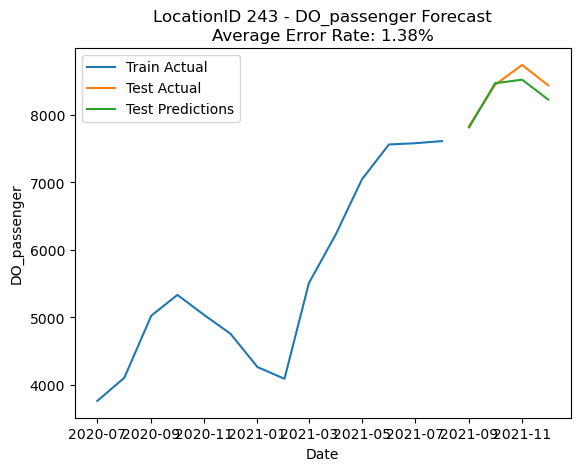

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


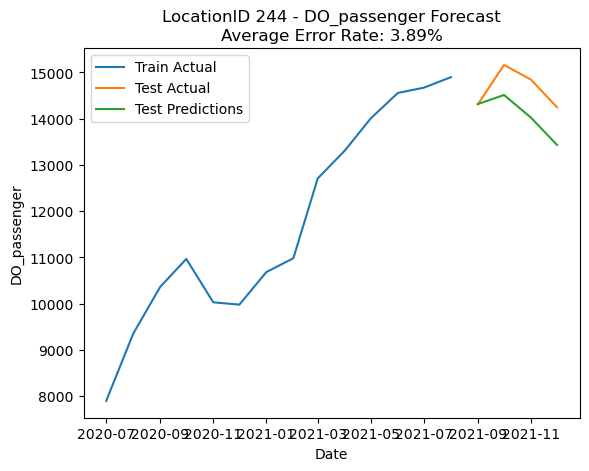

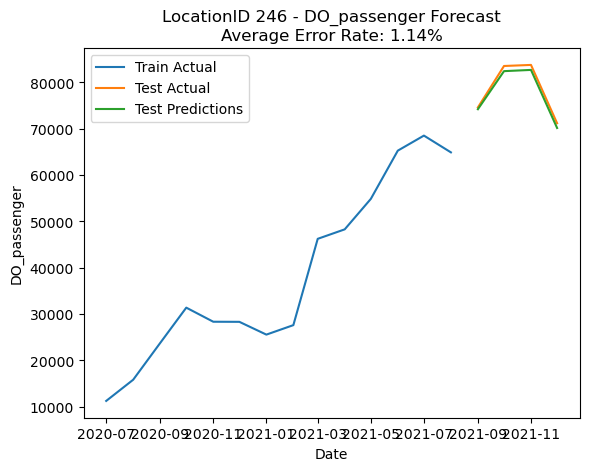

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


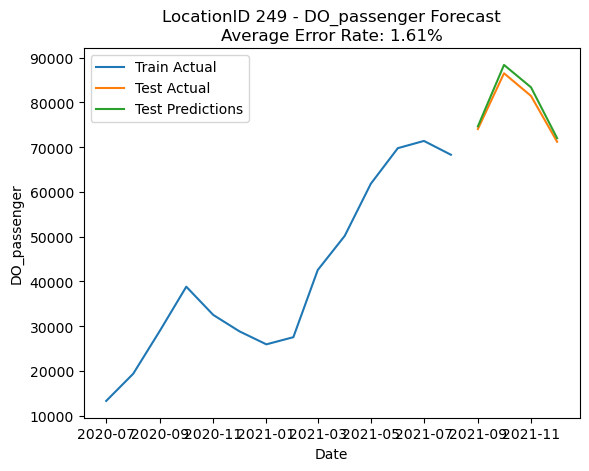

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


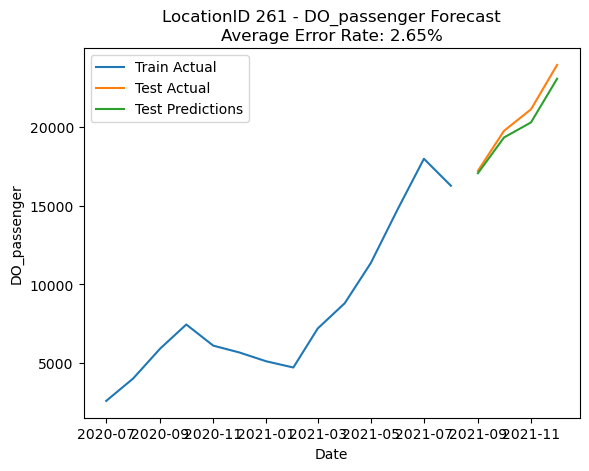

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


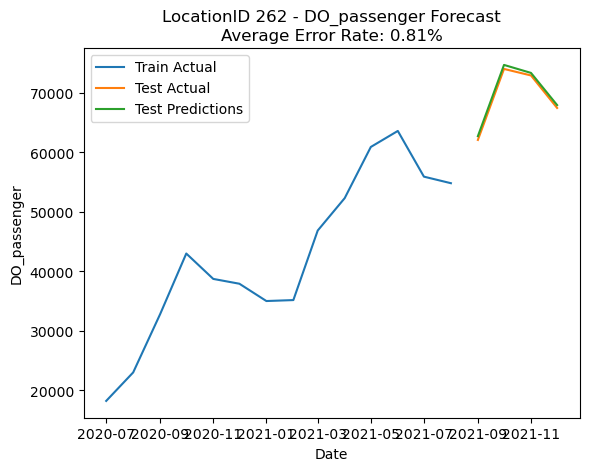

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


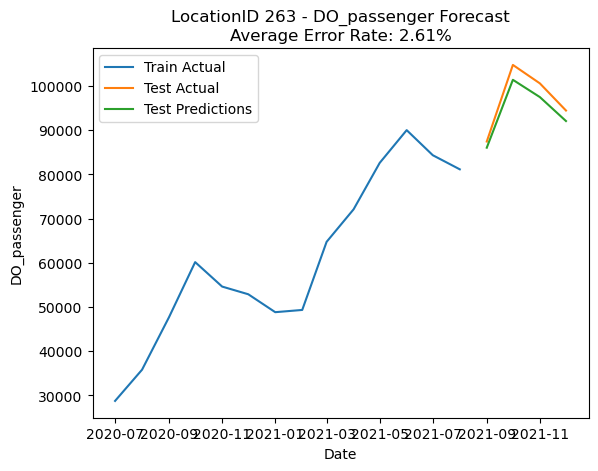

In [56]:


values_to_delete = []

# Obtain a unique LocationID list
unique_location_ids = data['LocationID'].unique()

# Using the delete function from numpy to remove specific values.
updated_location_ids = np.delete(unique_location_ids, np.where(np.isin(unique_location_ids, values_to_delete)))

# Define ARIMA model parameters
order = (2, 1, 2)  # (AR order, difference order, MA order)

# Predict and plot data for each LocationID
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group = data[data['LocationID'] == location_id]

    # splitting the dataset into training and testing data
    train_size = int(len(group) * 0.8)
    train_data = group.iloc[:train_size]
    test_data = group.iloc[train_size:]

    # extracting training data and testing data
    train_Passenger = train_data['passenger'].values
    train_DOcount = train_data['DropOff_count'].values
    
    train_features = np.column_stack((train_Passenger, train_DOcount))
    train_target = train_data['DO_passenger'].values

    # To train an ARIMA
    model = ARIMA(train_target, exog=train_features, order=order)
    model_fit = model.fit()

    # To make predictions
    test_features = np.column_stack((test_data['passenger'].values, test_data['DropOff_count'].values))
    test_predictions = model_fit.predict(start=train_size, end=len(group)-1, exog=test_features)

    # To calculate the error rate for the predictions
    error_rate = np.abs(test_predictions - test_data['DO_passenger'].values) / test_data['DO_passenger'].values
    average_error_rate = np.mean(error_rate)
    

    # Draw Line chart
    plt.plot(train_data['Date'], train_target, label='Train Actual')
    plt.plot(test_data['Date'], test_data['DO_passenger'].values, label='Test Actual')
    plt.plot(test_data['Date'], test_predictions, label='Test Predictions')
    plt.xlabel('Date')
    plt.ylabel('DO_passenger')
    plt.title(f'LocationID {location_id} - DO_passenger Forecast\nAverage Error Rate: {average_error_rate:.2%}')
    plt.legend()
    plt.show()



In [57]:


values_to_delete = []

# Obtain a unique LocationID list
unique_location_ids = data['LocationID'].unique()

# Using the delete function from numpy to remove specific values.
updated_location_ids = np.delete(unique_location_ids, np.where(np.isin(unique_location_ids, values_to_delete)))

# Define ARIMA model parameters
order = (2, 1, 2)  # (AR order, difference order, MA order)

# Create an empty model dictionary
DOP_dict = {}

# Predict and plot data for each LocationID
for location_id in unique_location_ids:
    # Filter data based on LocationID
    group = data[data['LocationID'] == location_id]

    # extracting training data and testing data
    train_Passenger = train_data['passenger'].values
    train_DOcount = train_data['DropOff_count'].values
    
    train_features = np.column_stack((train_Passenger, train_DOcount))
    train_target = train_data['DO_passenger'].values

    # To train an ARIMA
    model = ARIMA(train_target, exog=train_features, order=order)
    model_fit = model.fit()
    
    # To add the model to a dictionary.
    DOP_dict[location_id] = model_fit


/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packag

/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/yunni/opt/anaconda3/lib/python3.9/site-packag

- Pack all the required data and models into a single pickle file

In [58]:
# Create an empty model dictionary
merged = {}

In [59]:
with open('model_DO.pkl', 'rb') as f:
    DO_dict = pickle.load(f)
    
with open('model_PU.pkl', 'rb') as f:
    PU_dict = pickle.load(f)
    
with open('models_Passenger.pkl', 'rb') as f:
    Pa_dict = pickle.load(f)

merged['DO'] = DO_dict
merged['PU'] = PU_dict
merged['Pa'] = Pa_dict
merged['fare'] = fare_dict
merged['DOP'] = DOP_dict
merged['coef'] = coef_dict

with open('Ensembling.pkl', 'wb') as file:
    pickle.dump(merged, file)